# Evaluation of Example OpenAXES Dataset

This file is provided to play around with the data in the dataset and demonstrate how the files are read and interpreted.
**Beware:** This notebook is a work in progress not a comprehensive evaluation and any results and plots shown in the file are not necessarily scientifically sound evidence of anything.
Please see README.md for more information and read the Markdown fields, the comments, and the code to understand what is going on.

You might have to tell jupyter to trust this notebook before you can see any of the outputs contained within.

The notebook will store intermediate files in the `measure_raw-2022-09-15` directory, like the quaternion files calculated by the different filters, or the files containing the reconstructed TCP positions.
All intermediate files should be ignored by the file `measure_raw-2022-09-15/.gitignore`.
Until the `dsense_vis` program is released, please use the files in `measure_raw-2022-09-15.tar.bz2`, which contains the files generated by `dsense_vis`, and avoid executing the related cells..



In [2]:
import csv
import os
from os import getenv
import numpy as np
import pandas as pd

segments = [
    'carpus',
    'digitus',
    'humerus',
    'radius',
]

scenarios = [
    'circle-100',
    'circle-150',
    'circle-200', # Recording of circle-200 has a constant gyro offset on all axes, which is fixed by calculate-quaternions.py
    'circle-250',
    'triangle-100',
    'triangle-150',
    'triangle-200',
    'triangle-250',
]

methods = [
    'vqfbasic',
    'vqfbasic-cal',
    'vqfbasic-bmi',
    'vqfbasic-bmi-cal',
    'vqf',
    'vqf-cal',
    'vqf-bmi',
    'vqf-bmi-cal',
    'madgwick',
    'madgwick-cal',
    'madgwick-bmi',
    'madgwick-bmi-cal',
    # 'ekf', # Extended Kalman Filter currently produces erratic results. Probably required some fine-tuning.
    # 'ekf-cal',
    # 'ekf-bmi',
    # 'ekf-bmi-cal',
    'robot',         # Quaternions constructed from q0..q5 data from robot csv files
    'robot-autocal', # Like 'robot' but including dsense-vis calibration procedure
]

HOME = getenv('HOME')
CWD = os.getcwd()
dsense_vis_path = os.path.join(HOME, 'repository', 'dsense-vis', 'dsense_vis')

data_dir = os.path.join(CWD, 'measure_raw-2022-09-15')

def robot_tcp_filename(scenario, suffix=''):
    return os.path.join(data_dir, 'robot', 'robot-'+scenario+suffix+'.csv')

def csv_dirname(scenario, method=''):
    if 'robot' in method:
        return os.path.join(data_dir, 'robot', 'robot-'+scenario)
    imu_dir = os.path.join(data_dir, 'imu-'+scenario)
    if method == '':
        return imu_dir
    return os.path.join(imu_dir, method)

def reconstructed_tcp_filename(scenario, method, suffix=''):
    filename = f'tcp{suffix}.csv'
    if 'autocal' in method:
        filename = f'tcp-autocal{suffix}.csv'
    return os.path.join(csv_dirname(scenario, method), filename)

def angles_filename(scenario, method, suffix=''):
    return os.path.join(csv_dirname(scenario, method), f'angles{suffix}.csv')

def autocal_filename(scenario, method, suffix=''):
    return os.path.join(csv_dirname(scenario, method), f'autocal{suffix}.csv')

def raw_filename(scenario: str, segment: str):
    assert segment in segments
    return os.path.join(csv_dirname(scenario), segment+'.csv')

def quaternion_filename(scenario: str, method: str, segment: str, suffix=''):
    assert segment in segments
    return os.path.join(csv_dirname(scenario, method), segment+suffix+'.csv')

def read_tcp_csv(filename):
    with open(filename) as f:
        reader = csv.DictReader(f)
        tcp_values = [ [float(e['tcp_x']), float(e['tcp_y']), float(e['tcp_z'])] for e in reader ]
        return np.array(tcp_values)

def csv_read_array(filename, columns=[]):
    with open(filename, 'r') as f:
        reader = csv.reader(f)
        header = next(reader)
        cols = dict(zip(header, range(len(header))))
        data = np.array(list(reader), dtype='float32')
        if len(columns) == 0:
            return data, cols
        indices = [cols[name] for name in columns]
        cols = dict(zip(columns, range(len(columns))))
        return data[:, indices], cols



## Calculate Quaternions for all scenarios and methods

In [ ]:
from subprocess import check_call

for scenario in scenarios:
    for method in methods:
        if 'ekf' not in method: continue
        if method == 'robot-autocal':
            continue
        elif method == 'robot':
            check_call(['./calculate-robot-quaternions.py', robot_tcp_filename(scenario)])
        else:
            check_call(['./calculate-quaternions.py', csv_dirname(scenario), method])

## Visualize quaternions and raw gyro data

Here we see plots of raw gyroscope data and the resulting quaternions for a single method. The goal is to see if there are some constant offsets in the gyroscope data which could lead to drift. This confirms that the `circle-200` scenario is usable with the offset correction applied.

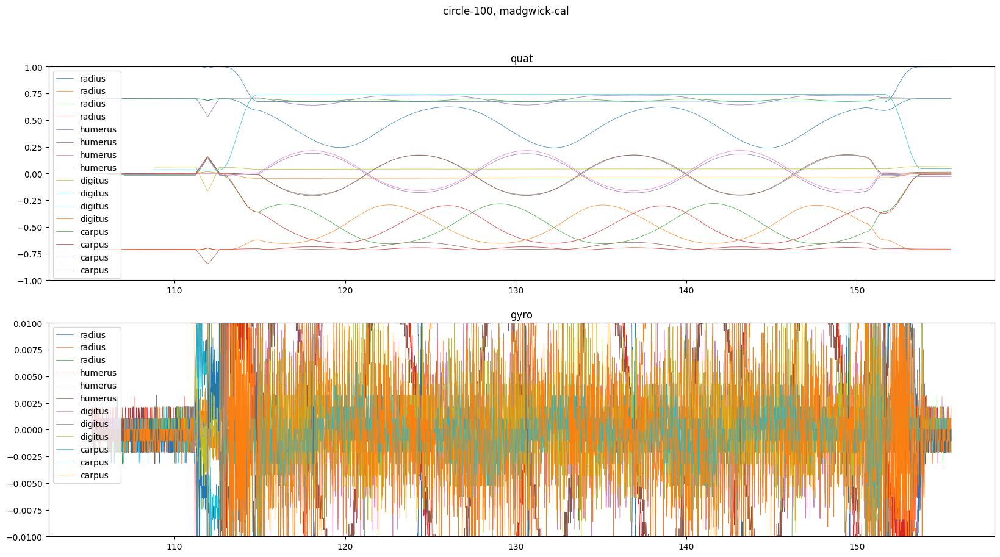

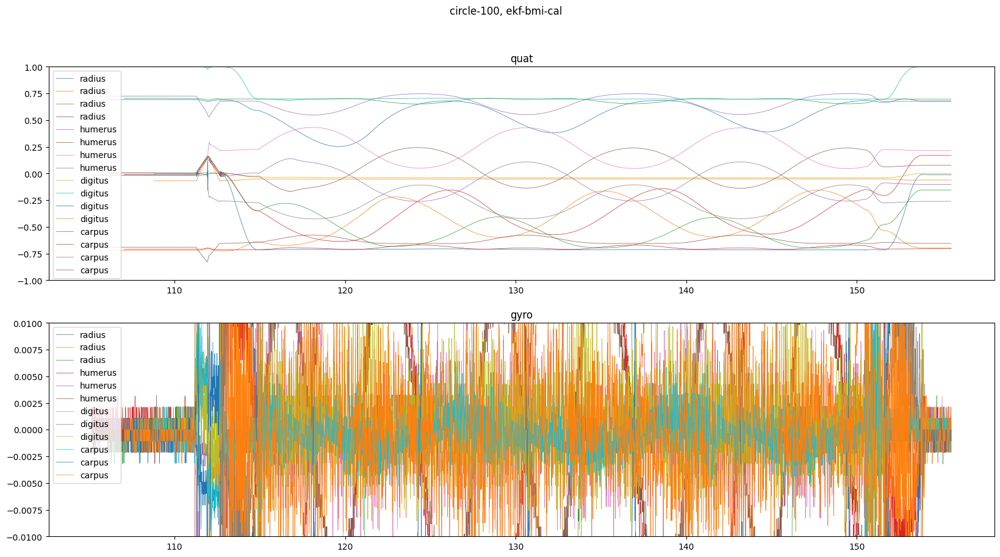

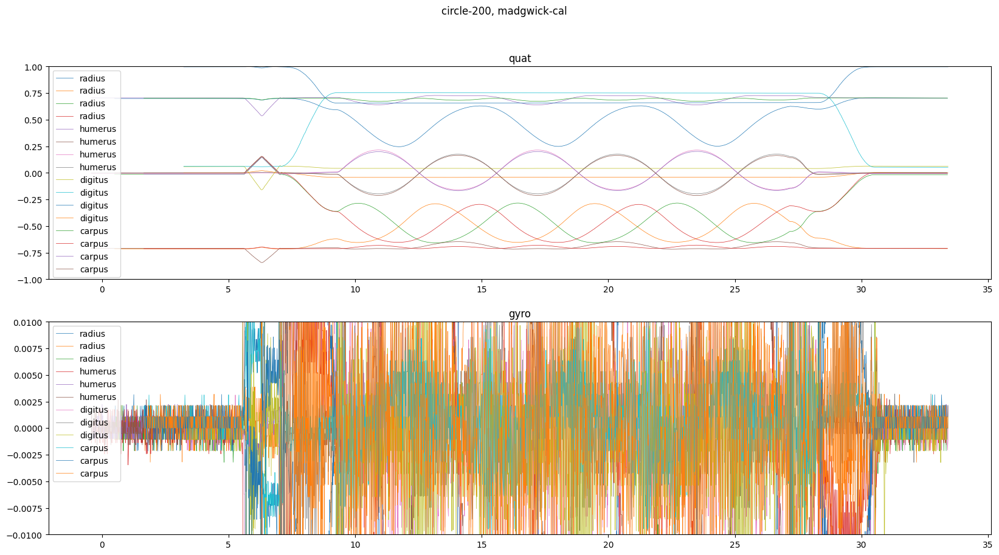

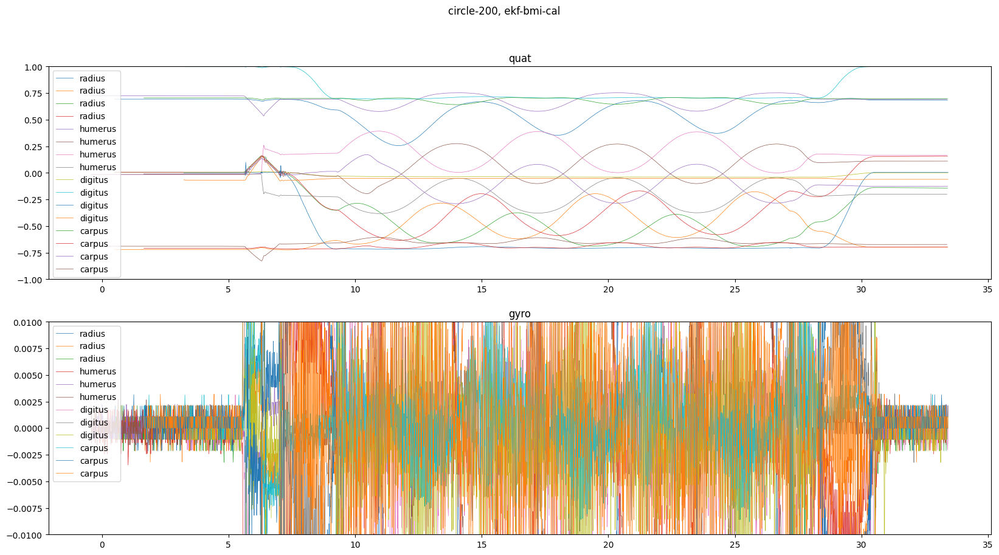

In [76]:
for scenario in ['circle-100', 'circle-200']:#, 'circle-150', 'circle-250']:
    for method in ['madgwick-cal', 'ekf-bmi-cal']:
        fig, ax = plt.subplots(2, figsize=(20,10))
        fig.suptitle(f'{scenario}, {method}')
        ax[0].set_title(f'quat')
        ax[1].set_title(f'gyro')
        ax[0].set_ylim((-1, 1))
        ax[1].set_ylim((-0.01, 0.01))
        for segment in reversed(segments):
            data = pd.read_csv(quaternion_filename(scenario, method, segment))
            #data = pd.read_csv(raw_filename(scenario, segment))
            t = np.array(data['TIME'])
            t = (t - 1663243916260647) / 1000000 + 265
            gyro = np.array(data[['GYRO_0','GYRO_1','GYRO_2']])
            quat = np.array(data[['QUATERNION_0','QUATERNION_1','QUATERNION_2','QUATERNION_3']])

            ax[0].plot(t, quat, lw=0.5, label=segment)
            ax[1].plot(t, gyro, lw=0.5, label=segment)
        ax[0].legend()
        ax[1].legend()
        plt.show()


## Calculate TCP positions using dsense_vis

In [3]:
from subprocess import PIPE, Popen, check_call
import sys

with os.popen(f'cd {dsense_vis_path} && git branch --show-current') as output:
    dsense_vis_branch = output.read().strip()
    assert dsense_vis_branch == 'robot-test', 'Please ensure that dsense_vis is on the branch "robot-test".'

def select_lines(text, prefix):
    length = len(prefix)
    return '\n'.join((
        line[length:]
        for line in text.split('\n')
        if line[:length] == prefix
    )) + '\n'

def calculate_tcp_positions(scenario, method, moreArgs=[], file_suffix='', replace_with_robot_data=[]):
    filename = reconstructed_tcp_filename(scenario, method, suffix=file_suffix)
    print('Calculating TCP positions for ' + filename)
    csv_paths = [
        quaternion_filename(scenario, 'robot' if segment in replace_with_robot_data else method, segment)
        for segment in segments
    ]
    check_call(['ln', '-sf', *csv_paths, dsense_vis_path])
    moreArgs += ['--autoCalibrateRobotMode=' + ('false' if method == 'robot' else 'true')]
    
    proc = Popen(['processing-java', '--sketch='+dsense_vis_path, '--run', *moreArgs], stdin=None, stdout=PIPE, stderr=PIPE)
    #os.chdir(old_path)
    output = proc.communicate()
    with open(os.path.join(csv_dirname(scenario, method), f'dsense_vis{file_suffix}.log'), 'wb') as f:
        f.write(output[0])
    if proc.returncode != 0:
        print('ERROR:')
        with open(os.path.join(csv_dirname(scenario, method), f'dsense_vis{file_suffix}.err'), 'wb') as f:
            f.write(output[1])
        print(output[1].decode('utf-8'))
    stdout = output[0].decode('utf-8')
    if 'humerus.csv was not rotated enough' in stdout: raise Exception('humerus.csv was not rotated enough')
    if 'radius.csv was not rotated enough' in stdout: raise Exception('radius.csv was not rotated enough')
    if 'carpus.csv was not rotated enough' in stdout: raise Exception('carpus.csv was not rotated enough')
    if 'digitus.csv was not rotated enough' in stdout: raise Exception('digitus.csv was not rotated enough')

    index = stdout.find('all bone orientations reset')
    if index == -1:
        print('WARNING: dsense_vis calibration failed', file=sys.stderr)
    stdout_calibrated = stdout[index:] # Remove all uncalibrated data
    
    tcp_lines = select_lines(stdout_calibrated, 'TCP:')
    with open(filename, 'w') as f:
        f.write('timestamp,tcp_x,tcp_y,tcp_z\n')
        f.write(tcp_lines.replace(';', ','))

    angles_lines = select_lines(stdout_calibrated, 'bone_angles:')
    with open(angles_filename(scenario, method) + file_suffix, 'w') as f:
        f.write('humerus_x,humerus_y,humerus_z,radius_x,radius_y,radius_z,carpus_x,carpus_y,carpus_z,digitus_x,digitus_y,digitus_z,\n')
        f.write(angles_lines.replace('[', '').replace(']', ''))

    autocal_lines = select_lines(stdout, 'autocal humerus:')
    with open(autocal_filename(scenario, method) + file_suffix, 'w') as f:
        f.write('state,x,y,z,angle,\n')
        f.write(autocal_lines.replace('[', '').replace(']', ''))


In [ ]:
for scenario in scenarios:
    for method in methods:
        if 'robot' in method: continue # Use these lines to selectively skip some cases if necessary...
        if 'ekf' in method: continue
        calculate_tcp_positions(scenario, method)

## Analyze auto calibration rotation axis

Visualize the axis around which the quaternion is rotated when moving from the initial upright pose (calibration pose 2) to the reclined pose (calibration pose 2). This axis should be constant during the calibration movement, except for a direction change in the middle, when the reclined pose was reached and the robot returns to the upright pose.

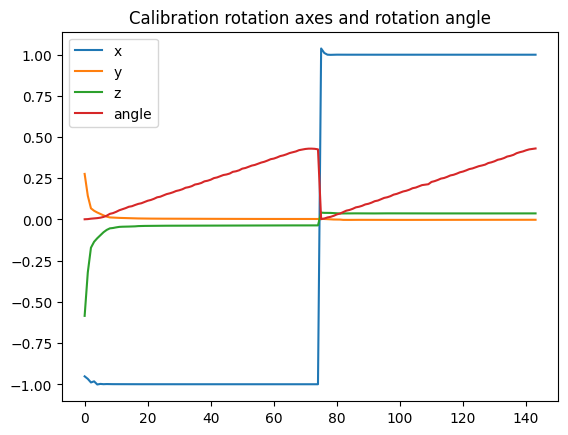

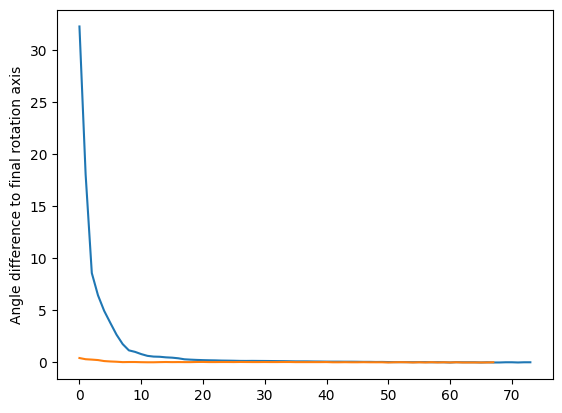

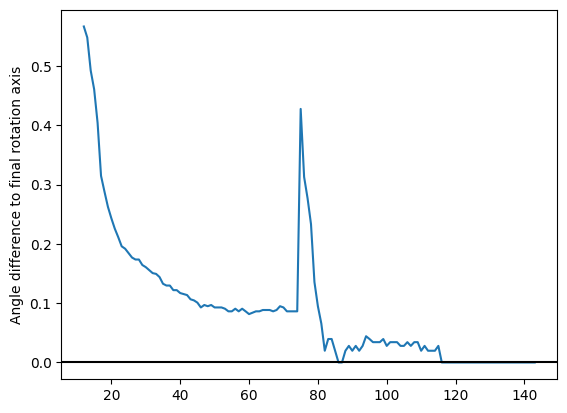

In [5]:
import matplotlib.pyplot as plt
import numpy as np
import csv
#%matplotlib widget

data, cols = csv_read_array(autocal_filename('circle-100', 'madgwick-cal'), ['x', 'y', 'z', 'angle'])

#data = np.log(np.abs(np.abs(data) - np.abs(data)[1,:]) + 1e-6)

plt.title('Calibration rotation axes and rotation angle')
plt.plot(data[:, cols['x']], label='x')
plt.plot(data[:, cols['y']], label='y')
plt.plot(data[:, cols['z']], label='z')
plt.plot(data[:, cols['angle']], label='angle')
plt.legend()
plt.show()

# Calculate the angle between the final rotation axis and the rotation axis over time
start_phase0 = 0
end_phase0 = len(data[data[:, cols['x']] < 0]) - 1
start_phase1 = end_phase0 + 1
end_phase1 = len(data) - 1
phase0 = data[start_phase0:end_phase0, [cols['x'], cols['y'], cols['z']]]
phase1 = data[start_phase1:end_phase1, [cols['x'], cols['y'], cols['z']]]
phase0 = phase0 / np.reshape(np.linalg.norm(phase0, axis=1), (-1,1))
phase1 = phase1 / np.reshape(np.linalg.norm(phase1, axis=1), (-1,1))
phase0_angles = np.arccos(np.clip(np.dot(phase0, phase0[-1,:]), -1, 1))
phase1_angles = np.arccos(np.clip(np.dot(phase1, phase1[-1,:]), -1, 1))

plt.figure()
plt.plot(np.rad2deg(phase0_angles), label='phase0')
plt.plot(np.rad2deg(phase1_angles), label='phase1')
plt.ylabel('Angle difference to final rotation axis')
plt.show()

# Compare axis before and after first calibration point, by flipping the axis after reversion direction
aligned = data[:, [cols['x'], cols['y'], cols['z']]]
aligned[start_phase0:end_phase0+1, :] *= -1
aligned = aligned / np.reshape(np.linalg.norm(aligned, axis=1), (-1,1))
aligned_angles = np.arccos(np.clip(np.dot(aligned, aligned[-1,:]), -1, 1))
aligned_angles[aligned_angles > 0.01] = float('nan')

plt.figure()
plt.plot(np.rad2deg(aligned_angles), label='both phases')
plt.ylabel('Angle difference to final rotation axis')
plt.axhline(y=0, color='k')
plt.show()



There appears to be a difference of 0.1 degrees between the rotation axes of the forward and reverse calibration movements.
This corresponds to `sin(0.1/180*pi) * 1000 == 1.75` millimeters of TCP offset for an arm length of 1 meter.

Most likely this is not the source of the inaccuracy of several centimeters.

# Compare joint angles between robot and IMUs

The joint angles are reconstructed from the IMU quaternions by converting them to Euler angles and looking at the component which corresponds to the rotation axis of the joint in question.

The Robot coordinate system is as follows, when seen by an observer standing in front of the robot, as in the Videos:
* +X = To the right, the SAR lab wall with the door
* +Y = Upwards, toward ceiling
* +Z = Toward the wall behind the robot where the TV is located

The IMU coordinate system is as follows, when the IMU is laid flat on the table with the red/green and blue LEDs pointing up:
* +X = Toward the USB port
* +Y = Toward the flat side opposite the rounded side
* +Z = Upwards, toward ceiling


In [4]:
import scipy.optimize as opt
import scipy.interpolate as interp

def resampleSignal(signal, time, scale, offset, return_time=False):
    duration = time[-1] - time[0]
    t2 = np.linspace(0, duration, len(signal))
    t2_resample_shift = (time - time[0] - offset) / scale
    resampled = interp.interpn((t2,), signal, t2_resample_shift, bounds_error=False, fill_value=signal[0])
    if return_time: return resampled, t2_resample_shift
    return resampled

def scaledTime(orig_time, scale, offset, num_samples=None):
    """Create an array of equidistant timestamps which are scaled and offset relative to `orig_time` using `alignSequences`.

    Args:
        orig_time (array_like): The original timestamp series given to `alignSequences`.
        scale (float): Time stretch as determined by `alignSequences`.
        offset (float): Time offset as determined by `alignSequences`.
        num_samples (int, optional): Length of the new time sequence. Defaults to the length of `orig_time`.

    Returns:
        ndarray: new time series of length `num_samples`, scaled and offset relative to `orig_time`.
    """
    if num_samples is None:
        num_samples = len(orig_time)
    duration = orig_time[-1] - orig_time[0]
    return orig_time[0] + np.linspace(0, duration, num_samples) * scale + offset

def alignSequences(s1, s2, t1, t2=None, offset_only=False, guess_initial=False):
    """
    Scale and offset signal s2 so that its difference to s1 is minimal.
    The returned `scale` and `offset` must be applied relative to the start of `t1`:
    `aligned_t2 = t1[0] + np.linspace(0, t1[-1] - t1[0], len(s2)) * scale + offset

    Parameters
    ----------

    `offset_only` : boolean
        Disable scaling, only shift the signal.
    `guess_initial` : boolean
        Look at the peaks of the signals for initial scale and offset guesses.

    Return
    ------
    tuple (`scale`, `offset`, `cost`)
    """
    t1 = t1 - t1[0] # Shift time origin to t=0
    duration = t1[-1] - t1[0]
    if t2 is None:
        t2 = np.linspace(0, duration, len(s2))
    assert len(t1) == len(s1), 's1 and t1 must have the same length'
    assert len(t2) == len(s2), 's2 and t2 must have the same length'
    #fig = plt.figure(figsize=(6,2))
    i = 0
    def resample_s2(scale, offset):
        return interp.interpn((t2,), s2, (t1 - offset * duration) / scale, bounds_error=False, fill_value=s2[0])
    def costFunction(scale_offset):
        residuals = s1 - resample_s2(*scale_offset)
        #cost = np.sum(residuals)
        ### Stuff for debugging:
        # title = 'costFunction ' + str(scale_offset) + ' => ' + str(cost)
        # print(title)
        # nonlocal i
        # if i % 100 == 0:
        #     plt.figure(figsize=(6,2))
        #     plt.title(title)
        #     plt.plot(s1, label='s1')
        #     plt.plot(resampled_s2, label='resampled_s2')
        #     plt.plot(residuals, label='residuals')
        #     plt.legend()
        #     plt.show()
        # i += 1
        return residuals # for methods that need a single residual value

    # [scale, offset], *_ = opt.leastsq(costFunction, [1, 0])
    # return scale, offset/10 * duration

    scale, offset = 1, 0

    if guess_initial:
        from scipy.signal import find_peaks
        amplitude = np.max(s1) - np.min(s1)
        def find_peak_indices(x: np.ndarray):
            indices, _props = find_peaks(x, prominence=0.3 * amplitude)
            return indices
        # Estimate initial alignment using peak positions
        indices1 = find_peak_indices(s1)
        indices2 = find_peak_indices(s2)
        if len(indices1) != len(indices2):
            #print(indices1, ' != ', indices2)
            indices1 = find_peak_indices(-s1)
            indices2 = find_peak_indices(-s2)
        if len(indices1) == len(indices2):
            peaks_t1, peaks_t2 = t1[indices1], t2[indices2]
            a = np.column_stack([peaks_t2, np.ones(len(peaks_t2)) * duration])
            scale_offset, residuals, rank, singular = np.linalg.lstsq(a, peaks_t1, rcond=None)
            #print(scale_offset, residuals, rank, singular)
            scale, offset = scale_offset
        #else:
            #print(indices1, ' != ', indices2)

    if offset_only:
        result = opt.least_squares(lambda ofs: costFunction((1.0, ofs)), [offset], bounds=([-0.5], [0.5]))
        return 1.0, result.x[0] * duration, result.cost
    else:
        result = opt.least_squares(costFunction, [scale, offset], bounds=([0.5, -0.5], [2, 0.5]))
        return result.x[0], result.x[1] * duration, result.cost
    # result = opt.dual_annealing(costFunction, [(0.5, 2), (-0.3,0.3)], x0=[1, 0])

    # fig.legend()
    # fig.show()

def simple_slice(arr, indices, axis):
    # this does the same as np.take() except only supports simple slicing, not
    # advanced indexing, and thus is much faster
    sl = [slice(None)] * np.ndim(arr)
    sl[axis] = indices
    return np.asarray(arr)[tuple(sl)]

def crop_quiet_ends(x, lookahead=10, column=0):
    dim = np.ndim(x)
    orig_x = x
    if dim > 1:
        x = simple_slice(x, column, axis=1)
    amplitude = np.max(x) - np.min(x)
    movement_threshold = 0.01 * amplitude
    start, first = 0, np.mean(x[:lookahead])
    end, last = len(x) - 1, np.mean(x[-lookahead:])
    while abs(x[start + lookahead] - first) < movement_threshold:
        start += 1
    while abs(x[end - lookahead] - last) < movement_threshold:
        end -= 1
    return simple_slice(orig_x, range(start, end), 0)


IMU time alignment: *0.9158657462552212 +2389727.724142043 cost=0.09694107407272477


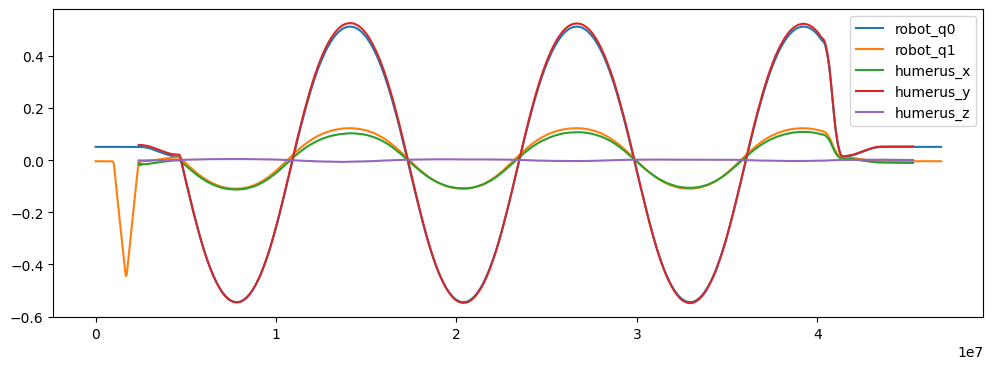

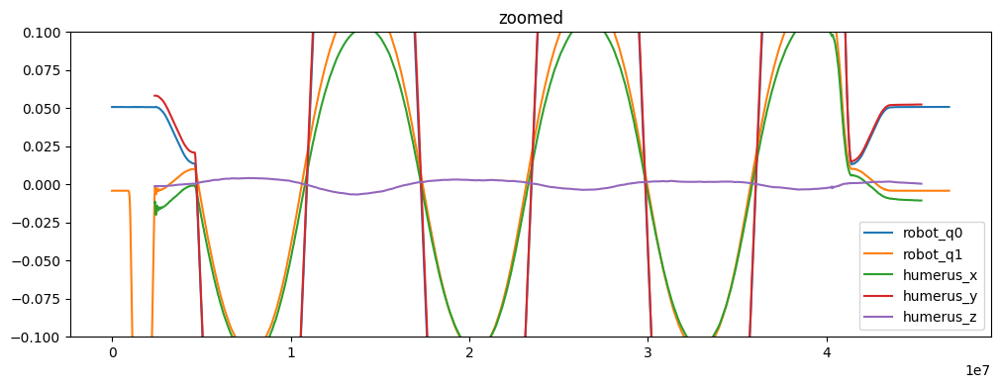

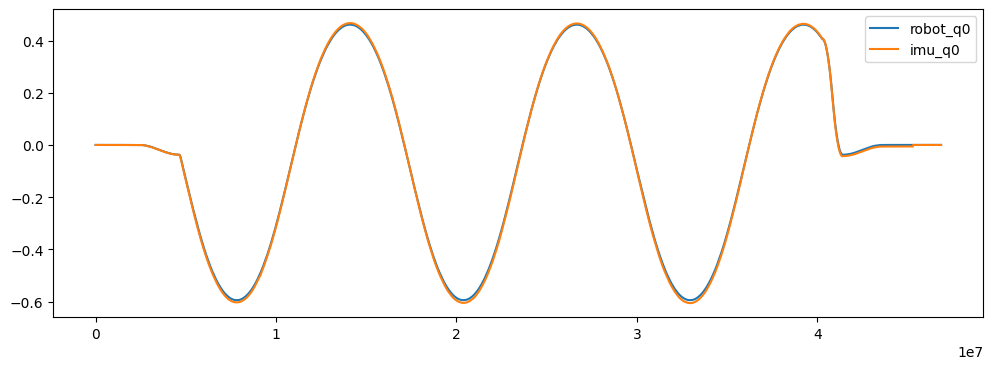

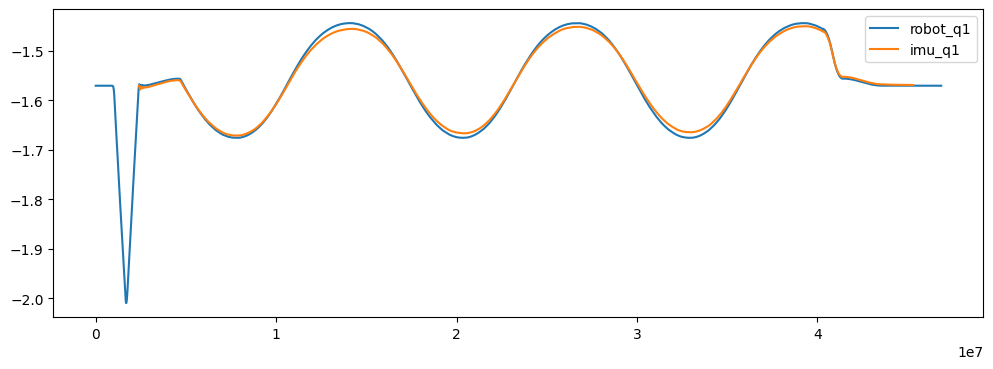

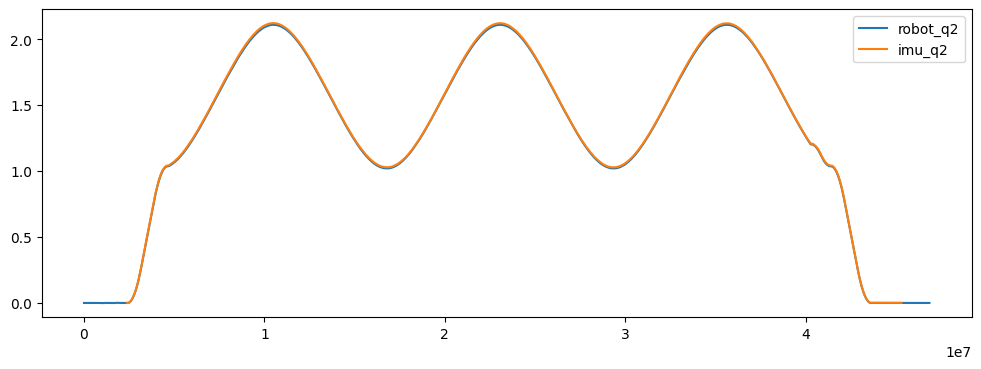

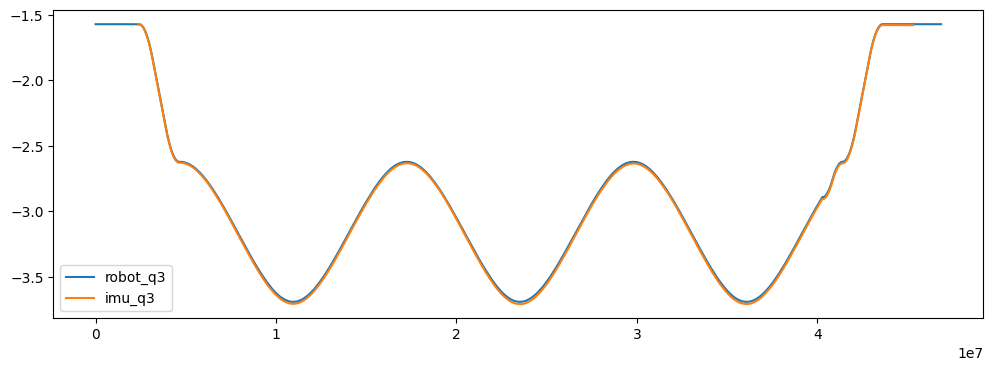

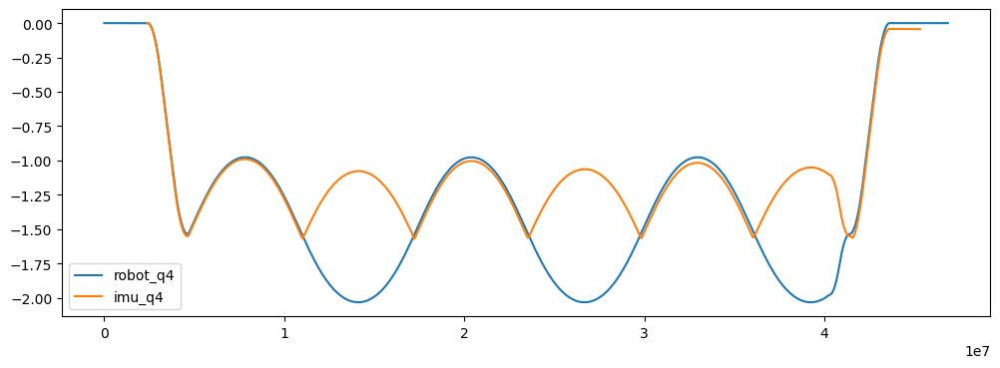

In [7]:
import matplotlib.pyplot as plt
import numpy as np
import csv
from math import pi

time_q0_q5, cols2 = csv_read_array(robot_tcp_filename('circle-100'), ['timestamp', 'q0', 'q1', 'q2', 'q3', 'q4', 'q5'])

time = np.array(time_q0_q5[:,0] * 1e6, dtype=int)
time = time - time[0]
robot_q0 = time_q0_q5[:,1]
robot_q1 = time_q0_q5[:,2]
robot_q2 = time_q0_q5[:,3]
robot_q3 = time_q0_q5[:,4]
robot_q4 = time_q0_q5[:,5]
robot_q5 = time_q0_q5[:,6]

imu_bone_angles, cols = csv_read_array(angles_filename('circle-100', 'madgwick-cal'))


imu_q0 = imu_bone_angles[:,cols['humerus_y']]
imu_q1 = -pi/2+imu_bone_angles[:,cols['humerus_x']]
imu_q2 = imu_bone_angles[:,cols['radius_x']]
imu_q3 = -pi/2+imu_bone_angles[:,cols['carpus_x']]
imu_q4 = imu_bone_angles[:,cols['digitus_y']]
imu_q5 = np.zeros(len(imu_q0))

#imu_time = np.linspace(0, time[-1] / (len(robot_q0)-1) * (len(imu_bone_angles)-1), len(imu_bone_angles))
scale, offset, cost = alignSequences(robot_q0, imu_q0, time)
#scale, offset = 1.0919330544546961, -2611330.203592543
print(f'IMU time alignment: *{scale} +{offset} cost={cost}')
#imu_time = (np.linspace(time[0], time[-1], len(imu_bone_angles))) * 0.9156 + 0.24e7
imu_time = np.linspace(0, time[-1], len(imu_bone_angles)) * scale + offset
#imu_time = imu_time * scale + offset


plt.figure(figsize=(12,4))
plt.plot(time, robot_q0 - np.mean(robot_q0), label='robot_q0')
plt.plot(time, robot_q1 - np.mean(robot_q1), label='robot_q1')
plt.plot(imu_time, imu_bone_angles[:,cols['humerus_x']] - np.mean(imu_bone_angles[:,cols['humerus_x']]), label='humerus_x')
plt.plot(imu_time, imu_bone_angles[:,cols['humerus_y']] - np.mean(imu_bone_angles[:,cols['humerus_y']]), label='humerus_y')
plt.plot(imu_time, imu_bone_angles[:,cols['humerus_z']] - np.mean(imu_bone_angles[:,cols['humerus_z']]), label='humerus_z')
plt.legend()

plt.figure(figsize=(12,4))
plt.title('zoomed')
plt.ylim(-0.1,0.1)
plt.plot(time, robot_q0 - np.mean(robot_q0), label='robot_q0')
plt.plot(time, robot_q1 - np.mean(robot_q1), label='robot_q1')
plt.plot(imu_time, imu_bone_angles[:,cols['humerus_x']] - np.mean(imu_bone_angles[:,cols['humerus_x']]), label='humerus_x')
plt.plot(imu_time, imu_bone_angles[:,cols['humerus_y']] - np.mean(imu_bone_angles[:,cols['humerus_y']]), label='humerus_y')
plt.plot(imu_time, imu_bone_angles[:,cols['humerus_z']] - np.mean(imu_bone_angles[:,cols['humerus_z']]), label='humerus_z')
plt.legend()

imu_q0 = resampleSignal(imu_q0, time, scale, offset)

plt.figure(figsize=(12,4))
plt.plot(time, robot_q0, label='robot_q0')
plt.plot(time, imu_q0, label='imu_q0')
plt.legend()
plt.show()

plt.figure(figsize=(12,4))
plt.plot(time, robot_q1, label='robot_q1')
plt.plot(imu_time, imu_q1, label='imu_q1')
plt.legend()
plt.show()

plt.figure(figsize=(12,4))
plt.plot(time, robot_q2, label='robot_q2')
plt.plot(imu_time, imu_q2, label='imu_q2')
plt.legend()
plt.show()

plt.figure(figsize=(12,4))
plt.plot(time, robot_q3, label='robot_q3')
plt.plot(imu_time, imu_q3, label='imu_q3')
plt.legend()
plt.show()

plt.figure(figsize=(12,4))
plt.plot(time, robot_q4, label='robot_q4')
plt.plot(imu_time, imu_q4, label='imu_q4')
plt.legend()
plt.show()

# plt.figure(figsize=(12,4))
# plt.plot(time, robot_q5, label='robot_q5')
# plt.plot(imu_time, imu_q5, label='imu_q5')
# plt.legend()
# plt.show()


### Same plot, but for triangle trajectory at 200 mm/s

In [ ]:
import matplotlib.pyplot as plt
import numpy as np
import csv
from math import pi

scenario = 'triangle-200'
time_q0_q5, cols2 = csv_read_array(robot_tcp_filename(scenario), ['timestamp', 'q0', 'q1', 'q2', 'q3', 'q4', 'q5'])

time = np.array(time_q0_q5[:,0] * 1e6, dtype=int)
time = time - time[0]
robot_q0 = time_q0_q5[:,1]
robot_q1 = time_q0_q5[:,2]
robot_q2 = time_q0_q5[:,3]
robot_q3 = time_q0_q5[:,4]
robot_q4 = time_q0_q5[:,5]
robot_q5 = time_q0_q5[:,6]

imu_bone_angles, cols = csv_read_array(angles_filename(scenario, 'ekf-cal'))


imu_q0 = imu_bone_angles[:,cols['humerus_y']]
imu_q1 = -pi/2+imu_bone_angles[:,cols['humerus_x']]
imu_q2 = imu_bone_angles[:,cols['radius_x']]
imu_q3 = -pi/2+imu_bone_angles[:,cols['carpus_x']]
imu_q4 = imu_bone_angles[:,cols['digitus_y']]
imu_q5 = np.zeros(len(imu_q0))

#imu_time = np.linspace(0, time[-1] / (len(robot_q0)-1) * (len(imu_bone_angles)-1), len(imu_bone_angles))
scale, offset, cost = alignSequences(robot_q0, imu_q0, time)
#scale, offset = 1.0919330544546961, -2611330.203592543
print(f'IMU time alignment: *{scale} +{offset} cost={cost}')
#imu_time = (np.linspace(time[0], time[-1], len(imu_bone_angles))) * 0.9156 + 0.24e7
imu_time = np.linspace(0, time[-1], len(imu_bone_angles)) * scale + offset
#imu_time = imu_time * scale + offset


plt.figure(figsize=(12,4))
plt.plot(time, robot_q0 - np.mean(robot_q0), label='robot_q0')
plt.plot(time, robot_q1 - np.mean(robot_q1), label='robot_q1')
plt.plot(imu_time, imu_bone_angles[:,cols['humerus_x']] - np.mean(imu_bone_angles[:,cols['humerus_x']]), label='humerus_x')
plt.plot(imu_time, imu_bone_angles[:,cols['humerus_y']] - np.mean(imu_bone_angles[:,cols['humerus_y']]), label='humerus_y')
plt.plot(imu_time, imu_bone_angles[:,cols['humerus_z']] - np.mean(imu_bone_angles[:,cols['humerus_z']]), label='humerus_z')
plt.legend()

plt.figure(figsize=(12,4))
plt.title('zoomed')
plt.ylim(-0.1,0.1)
plt.plot(time, robot_q0 - np.mean(robot_q0), label='robot_q0')
plt.plot(time, robot_q1 - np.mean(robot_q1), label='robot_q1')
plt.plot(imu_time, imu_bone_angles[:,cols['humerus_x']] - np.mean(imu_bone_angles[:,cols['humerus_x']]), label='humerus_x')
plt.plot(imu_time, imu_bone_angles[:,cols['humerus_y']] - np.mean(imu_bone_angles[:,cols['humerus_y']]), label='humerus_y')
plt.plot(imu_time, imu_bone_angles[:,cols['humerus_z']] - np.mean(imu_bone_angles[:,cols['humerus_z']]), label='humerus_z')
plt.legend()

imu_q0 = resampleSignal(imu_q0, time, scale, offset)

plt.figure(figsize=(12,4))
plt.plot(time, robot_q0, label='robot_q0')
plt.plot(time, imu_q0, label='imu_q0')
plt.legend()
plt.show()

plt.figure(figsize=(12,4))
plt.plot(time, robot_q1, label='robot_q1')
plt.plot(imu_time, imu_q1, label='imu_q1')
plt.legend()
plt.show()

plt.figure(figsize=(12,4))
plt.plot(time, robot_q2, label='robot_q2')
plt.plot(imu_time, imu_q2, label='imu_q2')
plt.legend()
plt.show()

plt.figure(figsize=(12,4))
plt.plot(time, robot_q3, label='robot_q3')
plt.plot(imu_time, imu_q3, label='imu_q3')
plt.legend()
plt.show()

plt.figure(figsize=(12,4))
plt.plot(time, robot_q4, label='robot_q4')
plt.plot(imu_time, imu_q4, label='imu_q4')
plt.legend()
plt.show()

# plt.figure(figsize=(12,4))
# plt.plot(time, robot_q5, label='robot_q5')
# plt.plot(imu_time, imu_q5, label='imu_q5')
# plt.legend()
# plt.show()


### Investigate possible imu1 body frame misalignment
The plots above indicate that there is a misalignment in the body frame of the IMU attached to the 'humerus' segment of the robot (imu1), compared to the axis of gravity.
If the Z axis in the rest frame of the IMU (resting on a flat surface) is not parallel to the direction of gravity, this could lead to a calibration error in dsense_vis.
This is because the assumption "Z = gravity" is used to calculate the gravity vector from the RefToSensor quaternion of the IMU in order to calculate the BoneToSensor quaternion.

The hypothesis is that this misalignment is the cause of the spurious Z axis rotations observed in the first plot, where we expect only X and Y motion because the first two axes of the robot are orthogonal.
In order to test this hypothesis, we apply small corrective rotations about different vectors in the the XY plane to the RefToSensor quaternion.
This should rotate the Z axis upright.
The magnitude of the corrective rotation is taken from the amplitude of the spurious Z rotation of the 'humerus' IMU as 0.04 radians.

In [9]:
from math import pi, sin, cos
from itertools import product

# Parameters for initial overview
# angle_steps = 4
# correction_angles = np.linspace(0.01, 0.04, angle_steps)
# heading_steps = 8
# headings = np.linspace(0, 2*pi, heading_steps, endpoint=False)

# Parameters for refinement 
# angle_steps = 6
# correction_angles = np.linspace(0.025, 0.05, angle_steps)
# heading_steps = 6
# headings = np.linspace(3.6, 4.7, heading_steps)

# Final refinement step for correction angle
angle_steps = 6
correction_angles = np.linspace(0.05, 0.08, angle_steps)
heading_steps = 3
headings = np.linspace(4.1, 4.3, heading_steps)

correction_steps = angle_steps * heading_steps
heading_and_angle = (list(product(list(headings), list(correction_angles))))

# def heading_and_angle(i):
#     angle = correction_angles[i % angle_steps]
#     heading = headings[i // angle_steps]
#     return heading, angle

print(heading_and_angle)

[(4.1, 0.05), (4.1, 0.056), (4.1, 0.062), (4.1, 0.068), (4.1, 0.07400000000000001), (4.1, 0.08), (4.199999999999999, 0.05), (4.199999999999999, 0.056), (4.199999999999999, 0.062), (4.199999999999999, 0.068), (4.199999999999999, 0.07400000000000001), (4.199999999999999, 0.08), (4.3, 0.05), (4.3, 0.056), (4.3, 0.062), (4.3, 0.068), (4.3, 0.07400000000000001), (4.3, 0.08)]


In [ ]:
for scenario in scenarios:
    for method in methods:
        if 'madgwick-cal' not in method: continue # Use these lines to selectively skip some cases if necessary...
        if 'circle-100' not in scenario: continue
        for i in range(correction_steps):
            correction_axis_heading, angle = heading_and_angle[i]
            correction_axis = [cos(correction_axis_heading), sin(correction_axis_heading), 0]
            axis_angle = ','.join(map(str, [*correction_axis, angle]))
            calculate_tcp_positions(scenario, method, ['--calibrationCorrection=humerus.csv:' + axis_angle], f'.corr{i:03}' )


IMU time alignment: *0.915996051482868 +2385936.5940045095 cost=0.04045161922006034, score=[0.046875268276559114, 0.0024131550668472926, 0.015628349453579108]


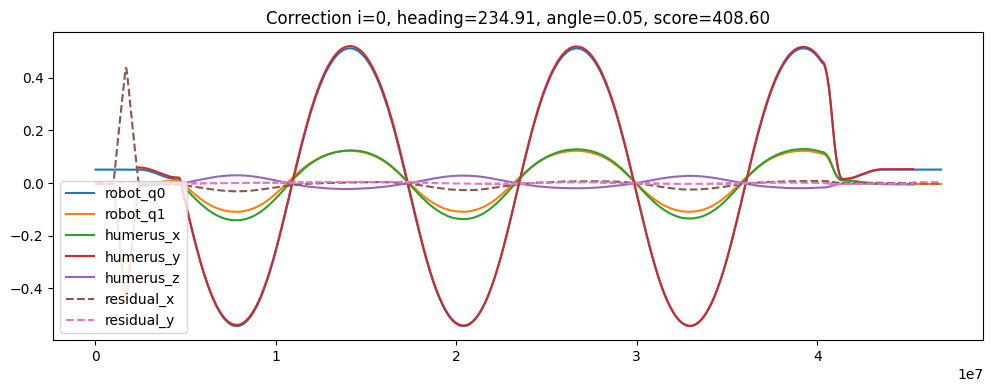

IMU time alignment: *0.9160125813475684 +2385476.51921686 cost=0.03736914023889721, score=[0.047420577089715185, 0.0021779739463067987, 0.017242569850922533]


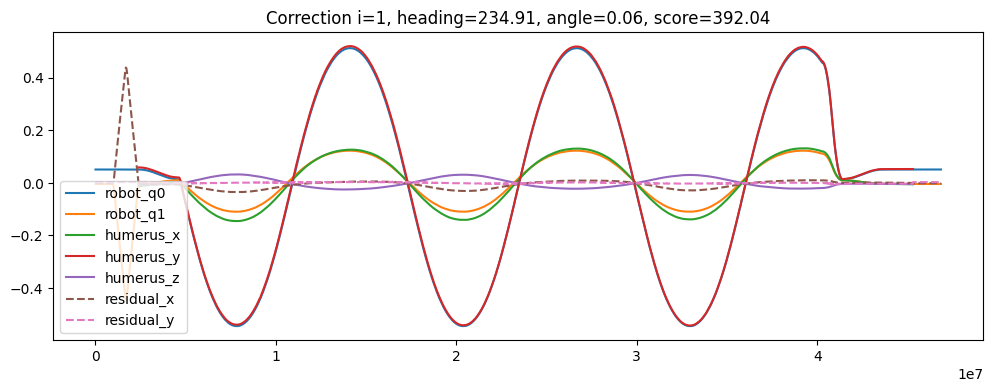

IMU time alignment: *0.9160335489588405 +2384915.4942529164 cost=0.035460427866876844, score=[0.0480310784777681, 0.002022493542729115, 0.018859775385864336]


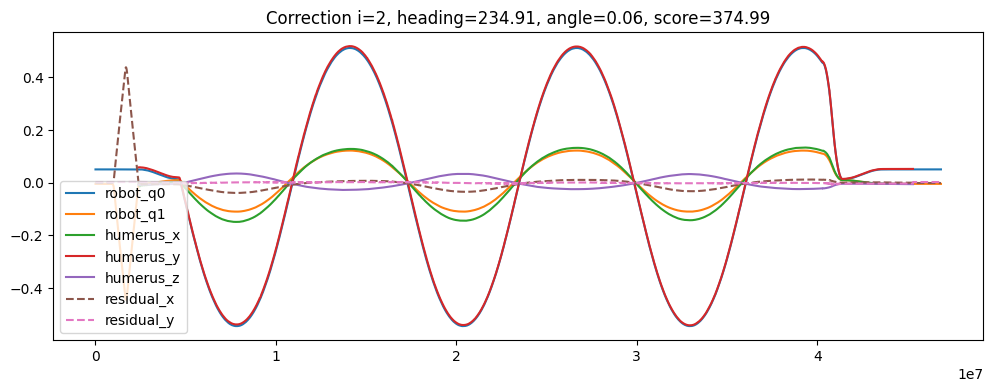

IMU time alignment: *0.9160530316941002 +2384397.0132664763 cost=0.03484666487510254, score=[0.04870334828874368, 0.0019766823756023812, 0.02047959832633827]


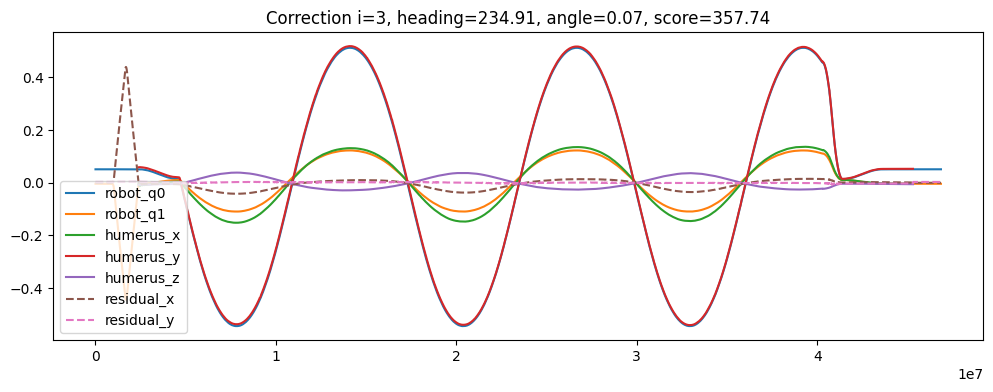

IMU time alignment: *0.9160710035103565 +2383885.3985702945 cost=0.03565425356805189, score=[0.04943392639056145, 0.002058347595500641, 0.022101796324646077]


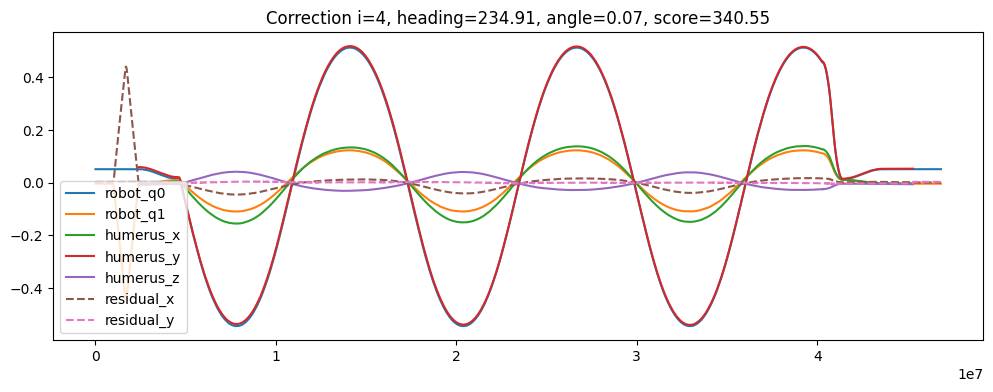

IMU time alignment: *0.9160891956917605 +2383369.8048343267 cost=0.03801285528711529, score=[0.050219414282291173, 0.0022632809087011355, 0.023726190112666426]


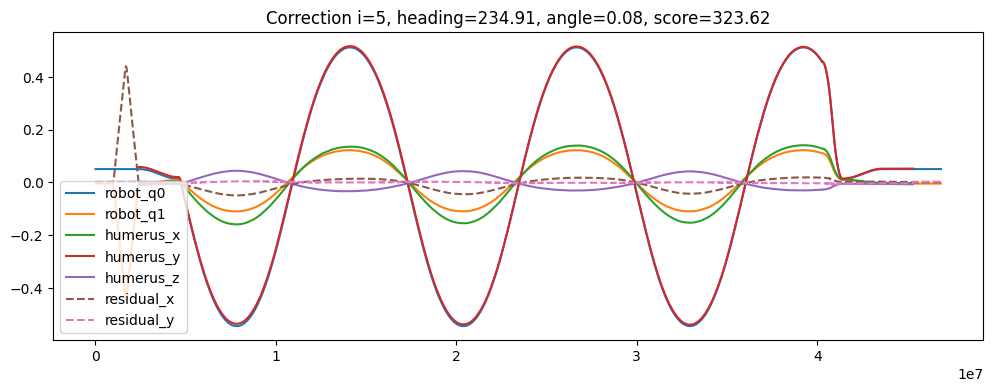

IMU time alignment: *0.9160020706689396 +2385765.9368909015 cost=0.03980331406764943, score=[0.04706098185584677, 0.0023189268851611083, 0.014258169273117677]


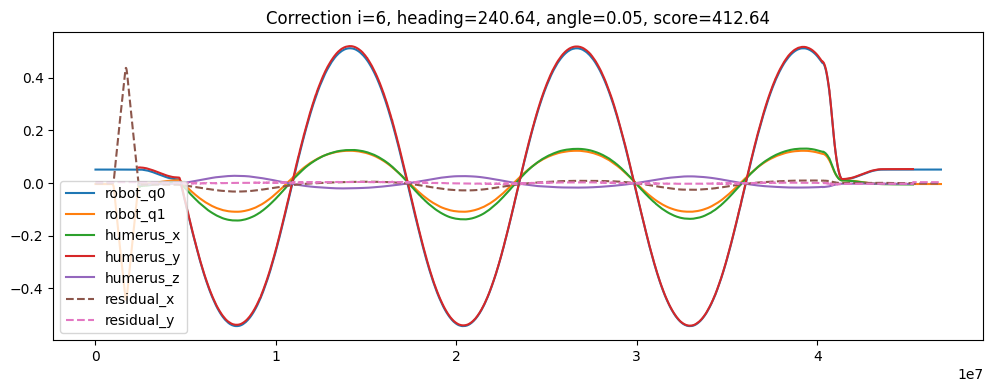

IMU time alignment: *0.9160204060038589 +2385249.121391807 cost=0.03722441041978079, score=[0.04766576491415057, 0.0021067082211123443, 0.01571195949752511]


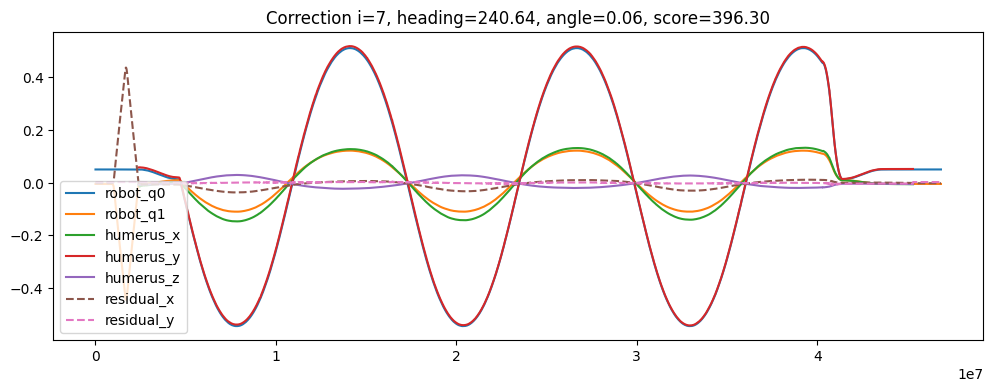

IMU time alignment: *0.9160405468054615 +2384716.58749729 cost=0.03595734882579018, score=[0.04834205282931087, 0.00199331663588885, 0.01716923718838845]


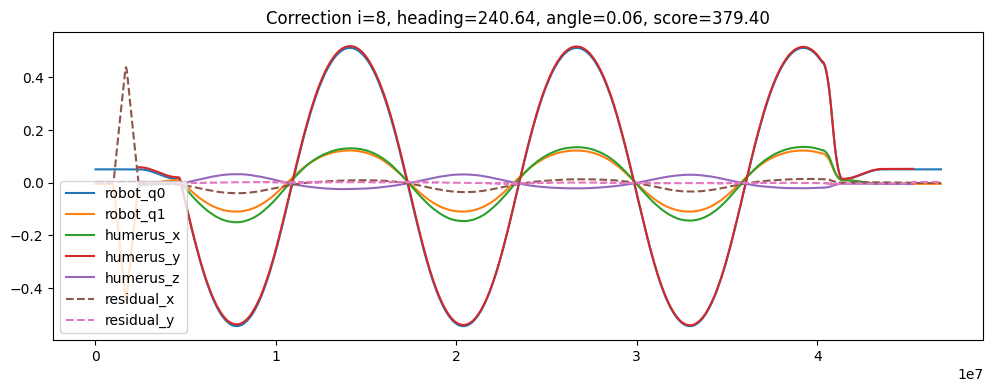

IMU time alignment: *0.9160614219592034 +2384154.684155008 cost=0.036127143822176376, score=[0.04908597691848567, 0.0020064841774377383, 0.01862987109292738]


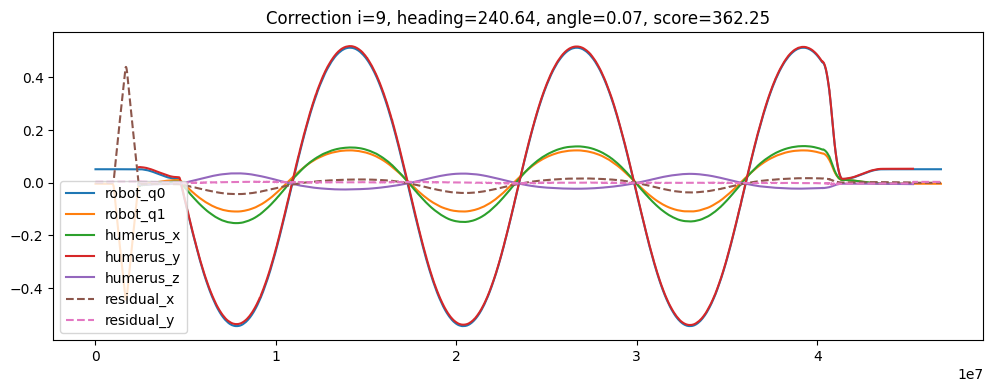

IMU time alignment: *0.916080612504372 +2383610.719872807 cost=0.03786466417772997, score=[0.049893509239291985, 0.002154370641332236, 0.020093544064294803]


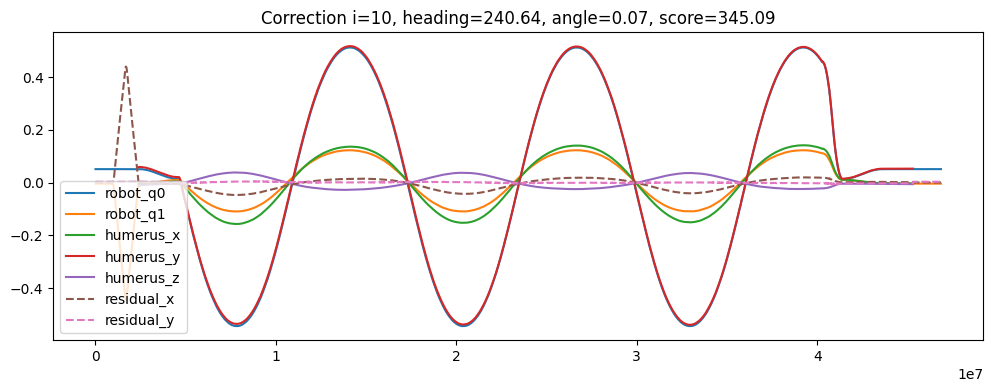

IMU time alignment: *0.9161007462797452 +2383037.485051853 cost=0.04130252026990521, score=[0.05076074540088882, 0.002421508349087401, 0.021559840972541704]


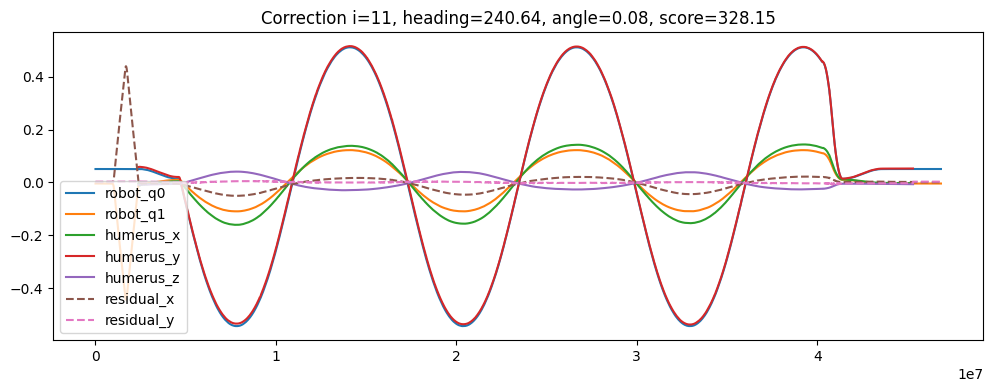

IMU time alignment: *0.9160074007001126 +2385621.9044604762 cost=0.03952371999137117, score=[0.047214937370093, 0.002249705840545127, 0.012776708585000894]


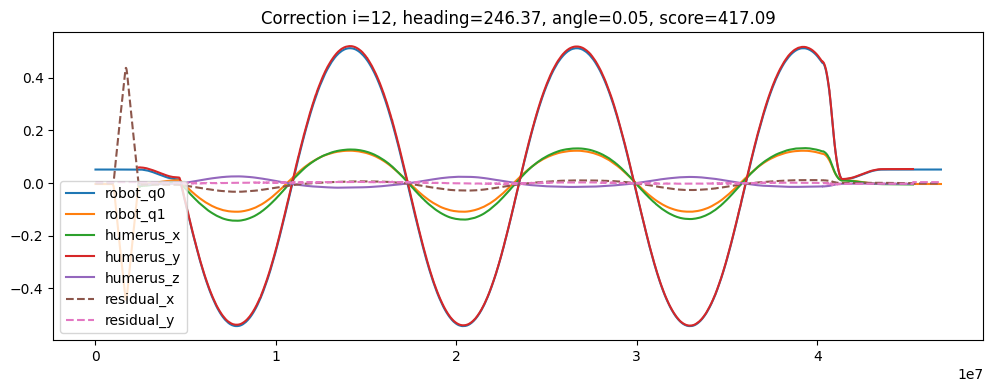

IMU time alignment: *0.9160278930815734 +2385057.3413366233 cost=0.037419896736737124, score=[0.04787005740292989, 0.0020616102291993728, 0.014056754219362444]


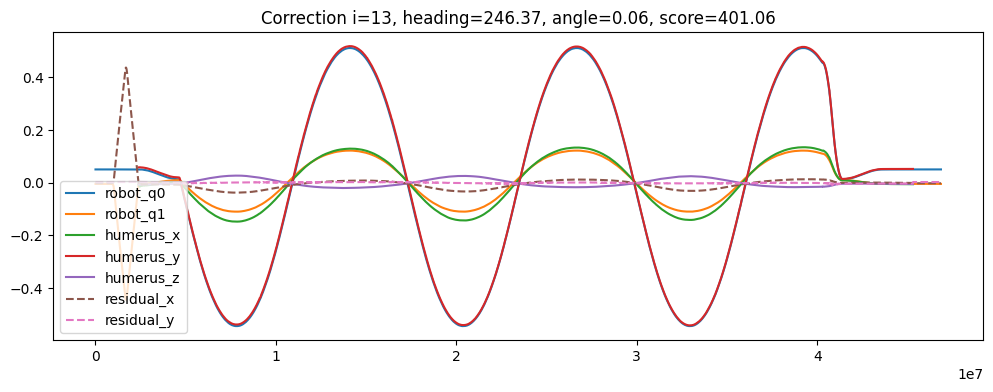

IMU time alignment: *0.9160499708946525 +2384489.8489659745 cost=0.03674589146004478, score=[0.04860220571763006, 0.0019882125005010963, 0.015340912182566646]


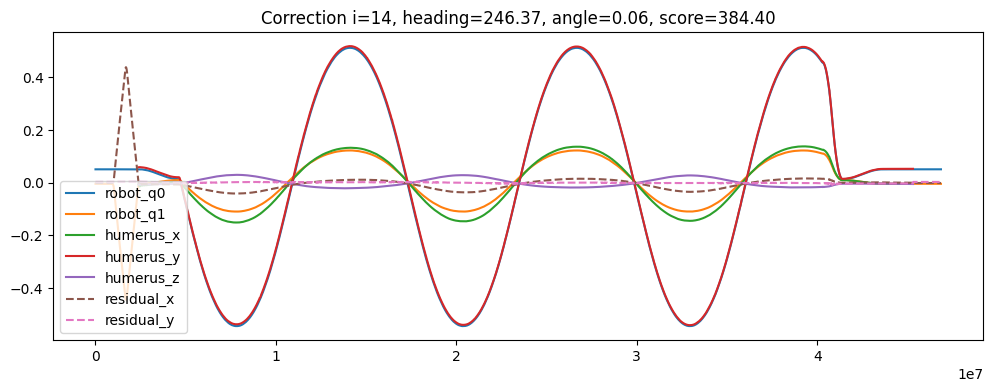

IMU time alignment: *0.9160680915209982 +2383964.2998239007 cost=0.037630082240353656, score=[0.049406837350886766, 0.0020530789393705564, 0.01662886571607881]


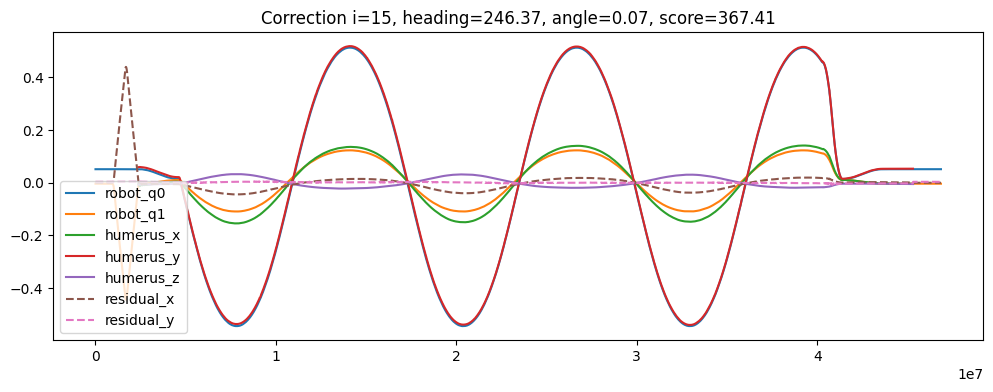

IMU time alignment: *0.9160874713225015 +2383417.9729421916 cost=0.04020449276898944, score=[0.050279652905931164, 0.002253967214901191, 0.017920394365615135]


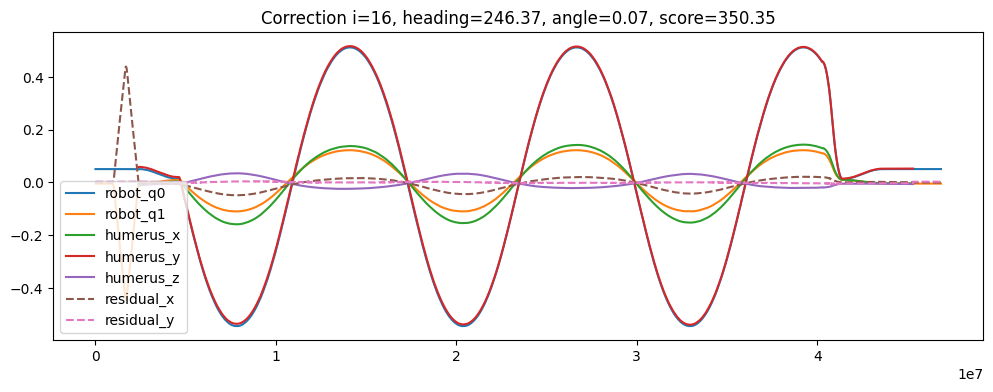

IMU time alignment: *0.9161075492833497 +2382835.1941645276 cost=0.044603840525832376, score=[0.05121626953707468, 0.002568040174294121, 0.01921525440323824]


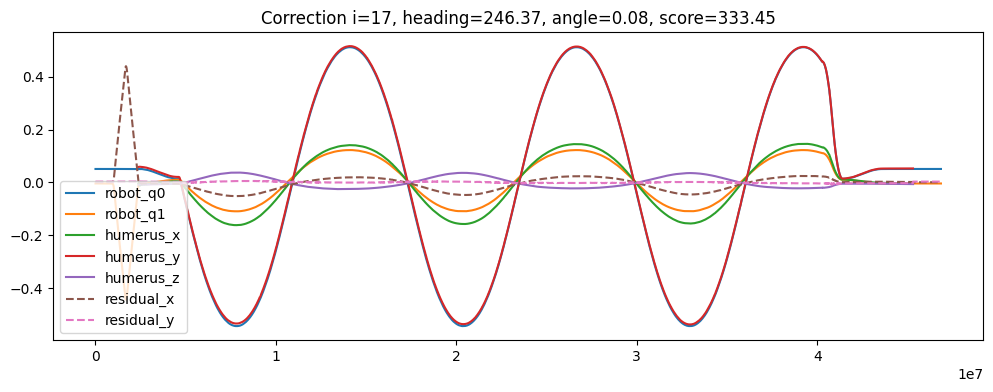

Scores:  [408.60365665629007, 392.0398784917658, 374.9860166580309, 357.73857423099554, 340.5485033722718, 323.6199759155385, 412.6418907148327, 396.3018638786444, 379.4043982027883, 362.24911999629546, 345.09484548887536, 328.154646202953, 417.0914448467118, 401.06121251144543, 384.39790763162557, 367.40798899106176, 350.35296675120895, 333.45258738129905]
Max score at i=12, (heading,angle)=(4.3, 0.05)


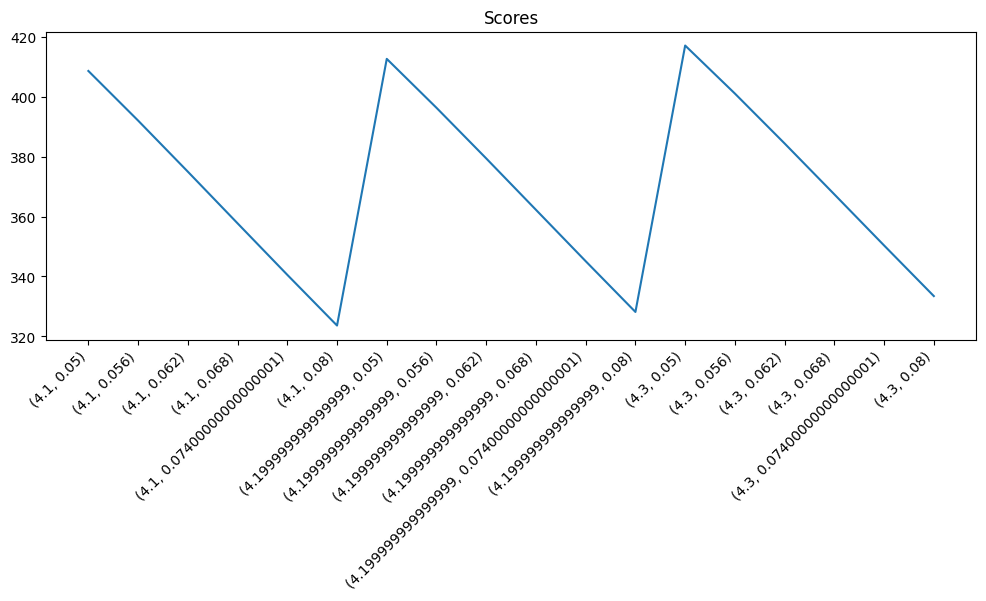

In [11]:
time_q0_q5, _cols2 = csv_read_array(robot_tcp_filename('circle-100'), ['timestamp', 'q0', 'q1', 'q2', 'q3', 'q4', 'q5'])

time = np.array(time_q0_q5[:,0] * 1e6, dtype=int)
time = time - time[0]
robot_q0 = time_q0_q5[:,1]
robot_q1 = time_q0_q5[:,2]

scores = np.array([float('nan')] * correction_steps)

for i in range(correction_steps):
    correction_axis_heading, angle = heading_and_angle[i]

    imu_bone_angles, cols = csv_read_array(angles_filename('circle-100', 'madgwick-cal') + f'.corr{i:03}')
    imu_q0 = imu_bone_angles[:,cols['humerus_y']]
    scale, offset, cost = alignSequences(robot_q0, imu_q0, time)

    humerus_x = imu_bone_angles[:,cols['humerus_x']]
    humerus_y = imu_bone_angles[:,cols['humerus_y']]
    humerus_z = imu_bone_angles[:,cols['humerus_z']]
    residual_x = resampleSignal(humerus_x, time, scale, offset) - robot_q1
    residual_y = resampleSignal(humerus_y, time, scale, offset) - robot_q0
    residual_z = resampleSignal(humerus_z, time, scale, offset)

    score_x = np.sqrt(np.mean(np.square(residual_x - np.mean(residual_x))))
    score_y = np.sqrt(np.mean(np.square(residual_y - np.mean(residual_y))))
    score_z = np.sqrt(np.mean(np.square(residual_z - np.mean(residual_z))))
    score_vector = [score_x, score_y, score_z]
    score = 1 / np.dot(score_vector, score_vector)
    scores[i] = score
    print(f'IMU time alignment: *{scale} +{offset} cost={cost}, score={score_vector}')

    imu_time = np.linspace(time[0], time[-1], len(imu_bone_angles)) * scale + offset

    plt.figure(figsize=(12,4))
    plt.title(f'Correction i={i}, heading={np.rad2deg(correction_axis_heading):0.2f}, angle={angle:0.2f}, score={score:0.2f}')
    plt.plot(time, robot_q0 - np.mean(robot_q0), label='robot_q0')
    plt.plot(time, robot_q1 - np.mean(robot_q1), label='robot_q1')
    plt.plot(imu_time, imu_bone_angles[:,cols['humerus_x']] - np.mean(imu_bone_angles[:,cols['humerus_x']]), label='humerus_x')
    plt.plot(imu_time, imu_bone_angles[:,cols['humerus_y']] - np.mean(imu_bone_angles[:,cols['humerus_y']]), label='humerus_y')
    plt.plot(imu_time, imu_bone_angles[:,cols['humerus_z']] - np.mean(imu_bone_angles[:,cols['humerus_z']]), label='humerus_z')
    plt.plot(time, residual_x - np.mean(residual_x), label='residual_x', ls='--')
    plt.plot(time, residual_y - np.mean(residual_y), label='residual_y', ls='--')
    plt.legend()
    plt.show()

max_i = np.argmax(scores)
print('Scores: ', list(scores))
print(f'Max score at i={max_i}, (heading,angle)={heading_and_angle[max_i]}')
labels = list(map(str, heading_and_angle))
plt.figure(figsize=(12,4))
plt.title('Scores')
plt.plot(labels, scores)
plt.xticks(rotation=45, ha='right')
plt.show()

### Hypothesis: wrong calibration coefficients

Maybe we used the calibration coefficients for the wrong accelerometer. I.E. using the calibration coefficients calculated during the ADXL355 calibration, but applying them to the BMI160 accelerometer measurement. The methods containing `-bmi` are using the calibration values 

# Analysis of TCP paths

The shape of the tool center position (TCP) paths should ideally be the same for all scenarios and methods.
The TCP path recorded by the robot itself is the reference.
The path reconstructed by applying the robot joint angles q0...q5 to the `dsense_vis` robot arm model are very similar.
The paths reconstructed from the IMU data of the sensors strapped to the robot segments deviates from that reference.

### Visualization of the data obtained by calibration correction

circle-100 madgwick-cal


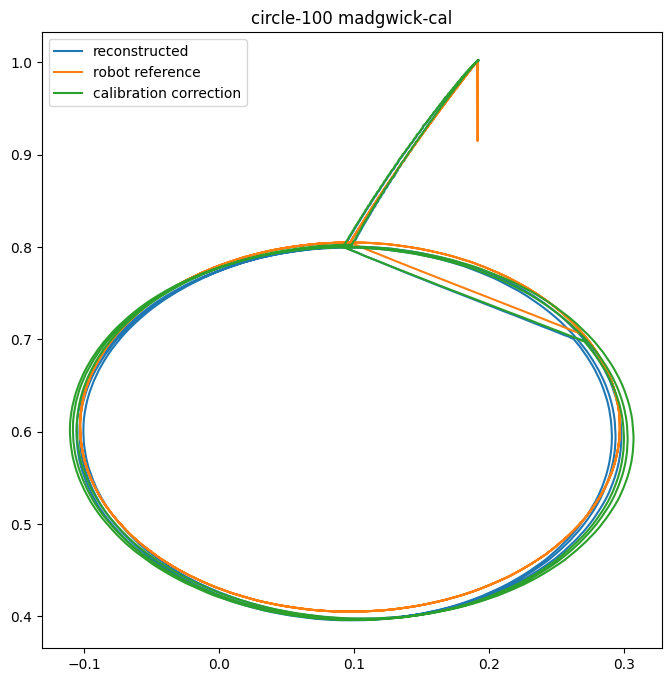

In [12]:
scenario = 'circle-100'
method = 'madgwick-cal'
robot_tcp = read_tcp_csv(robot_tcp_filename(scenario))
imufile = reconstructed_tcp_filename(scenario, method)
reconstructed_tcp = read_tcp_csv(imufile)
corrected_tcp = read_tcp_csv(imufile + '.corr001')
plt.figure(figsize=(8,8))
print(scenario + ' ' + method)
plt.title(scenario + ' ' + method)
#plt.xlim(-0.3, 0.3)
#plt.ylim(0.4, 1.0)
plt.plot(reconstructed_tcp[:, 0], reconstructed_tcp[:, 1], label='reconstructed')
plt.plot(-robot_tcp[:, 1], robot_tcp[:, 2], label='robot reference')
plt.plot(corrected_tcp[:, 0], corrected_tcp[:, 1], label='calibration correction')
plt.legend()
plt.show()

### Visual comparison of all methods

Here we look at two examples where the difference between the IMU reconstruction methods can be seen quite well:
Triangular path at 250 mm/s.
The reconstructed TCP paths for all methods are superimposed in this plot.
Circle with 250 mm/s is shown as well.

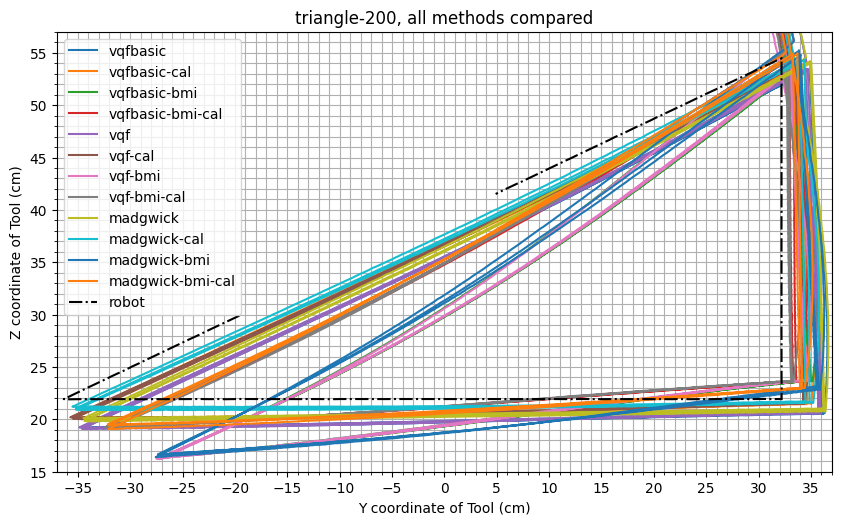

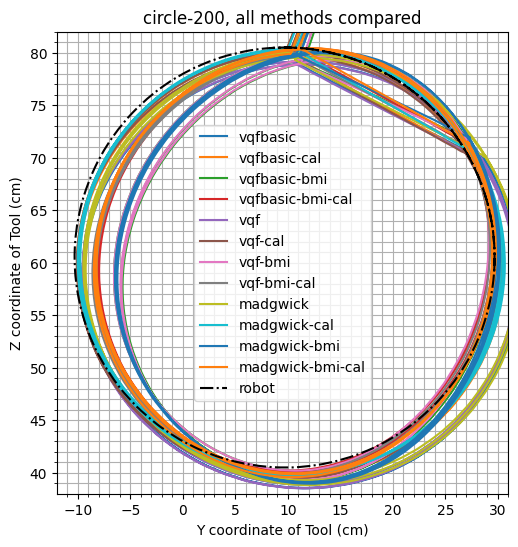

In [13]:
from matplotlib import pyplot as plt
import numpy as np
import csv

for scenario in ['triangle-200', 'circle-200']:
    robot_tcp = 100*read_tcp_csv(robot_tcp_filename(scenario))[1000:2000]

    plt.figure(figsize=(10,6))
    for method in methods:
        if 'robot' in method: continue
        imu_tcp = 100*read_tcp_csv(reconstructed_tcp_filename(scenario, method))
        plt.plot(imu_tcp[:, 0], imu_tcp[:, 1], label=method)
    plt.plot(-robot_tcp[:, 1], robot_tcp[:, 2], label='robot', color='k', ls='-.')
    plt.gca().set_aspect(1)
    plt.legend()
    plt.minorticks_on()
    plt.xticks(np.arange(-35, 41, 5))
    plt.yticks(np.arange(-35, 100, 5))
    if 'circle' in scenario:
        plt.xlim(-12, 31)
        plt.ylim(38, 82)
    else:
        plt.xlim(-37, 37)
        plt.ylim(15, 57)
    plt.grid(which='both')
    plt.title(scenario + ', all methods compared')
    plt.xlabel('Y coordinate of Tool (cm)')
    plt.ylabel('Z coordinate of Tool (cm)')
    plt.show()

# Plot for Paper

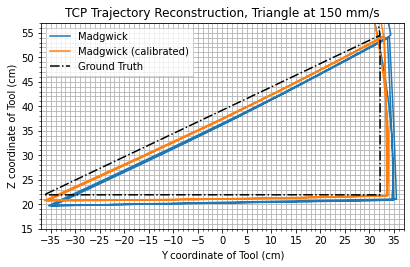

In [49]:
from matplotlib import pyplot as plt
import numpy as np
import csv

for scenario in ['triangle-150']:
    robot_tcp = 100*read_tcp_csv(robot_tcp_filename(scenario))[500:2100]

    plt.figure(figsize=(5*1.3,3*1.3))
    madgwick_tcp = 100*read_tcp_csv(reconstructed_tcp_filename(scenario, 'madgwick'))
    madgwick_cal_tcp = 100*read_tcp_csv(reconstructed_tcp_filename(scenario, 'madgwick-cal'))
    plt.plot(madgwick_tcp[:, 0], madgwick_tcp[:, 1], label='Madgwick')
    plt.plot(madgwick_cal_tcp[:, 0], madgwick_cal_tcp[:, 1], label='Madgwick (calibrated)')
    plt.plot(-robot_tcp[:, 1], robot_tcp[:, 2], label='Ground Truth', color='k', ls='-.')
    plt.gca().set_aspect(1)
    plt.legend()
    plt.minorticks_on()
    plt.xticks(np.arange(-35, 41, 5))
    plt.yticks(np.arange(-35, 100, 5))
    if 'circle' in scenario:
        plt.xlim(-12, 31)
        plt.ylim(38, 82)
    else:
        plt.xlim(-37, 37)
        plt.ylim(15, 57)
    plt.grid(which='both')
    plt.title('TCP Trajectory Reconstruction, Triangle at 150 mm/s')
    plt.xlabel('Y coordinate of Tool (cm)')
    plt.ylabel('Z coordinate of Tool (cm)')
    plt.savefig('paper-plot.png', bbox_inches='tight', transparent=False, dpi=400)
    plt.savefig('paper-plot.pdf', bbox_inches='tight')
    plt.show()

## Plot TCP offsets for 250 mm/s grouped by algorithm

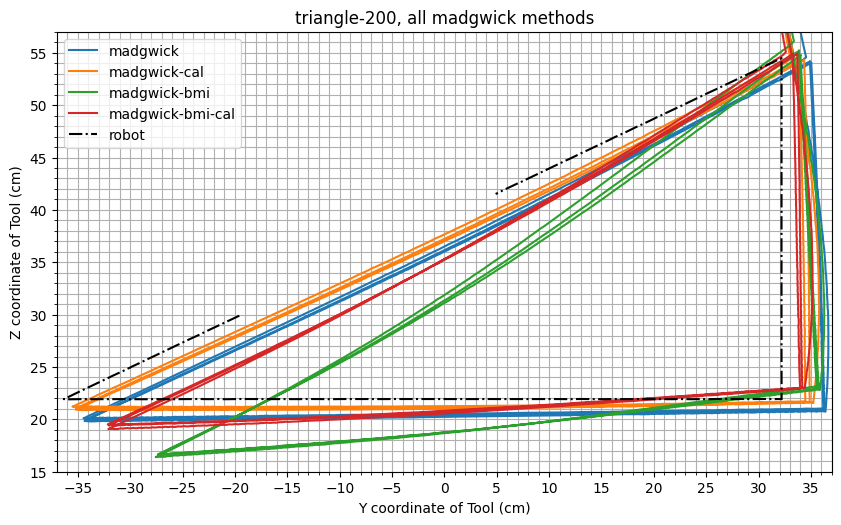

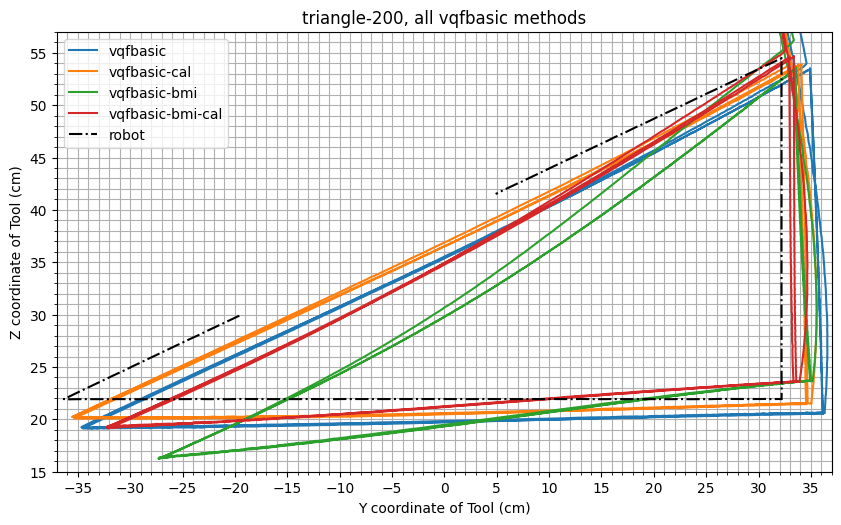

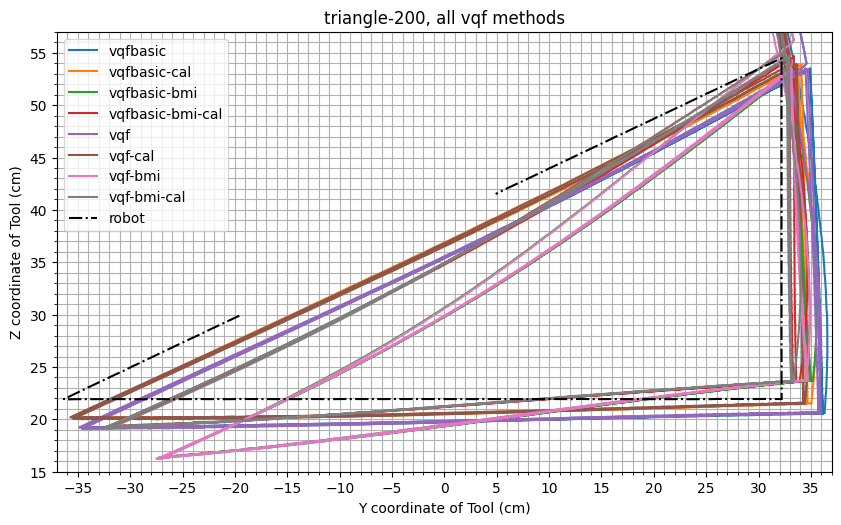

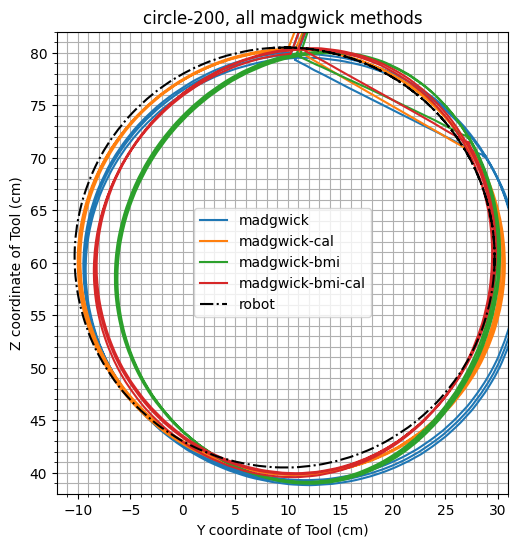

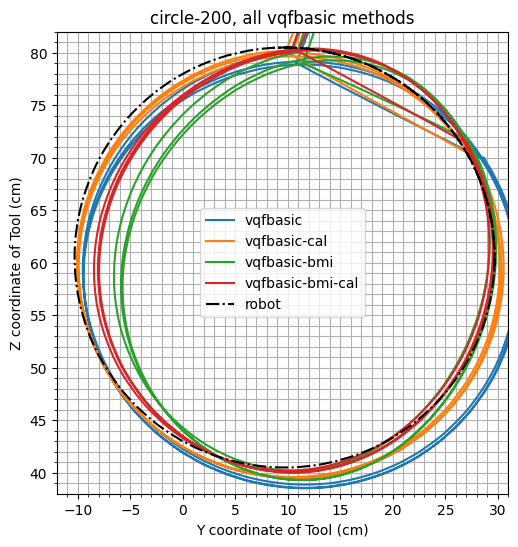

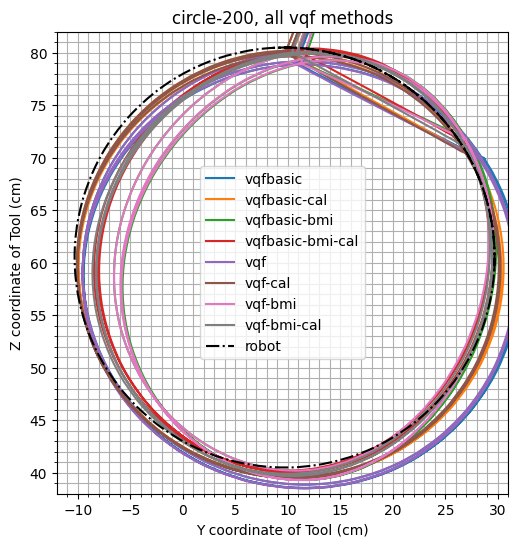

In [14]:
from matplotlib import pyplot as plt
import numpy as np
import csv

for scenario in ['triangle-200', 'circle-200']:
    robot_tcp = 100*read_tcp_csv(robot_tcp_filename(scenario))[1000:2000]
    for algorithm in ['madgwick', 'vqfbasic', 'vqf']:
        plt.figure(figsize=(10,6))
        for method in methods:
            if 'robot' in method: continue
            if algorithm != method[0:len(algorithm)]: continue
            imu_tcp = 100*read_tcp_csv(reconstructed_tcp_filename(scenario, method))
            plt.plot(imu_tcp[:, 0], imu_tcp[:, 1], label=method)
        plt.plot(-robot_tcp[:, 1], robot_tcp[:, 2], label='robot', color='k', ls='-.')
        plt.gca().set_aspect(1)
        plt.legend()
        plt.minorticks_on()
        plt.xticks(np.arange(-35, 41, 5))
        plt.yticks(np.arange(-35, 100, 5))
        if 'circle' in scenario:
            plt.xlim(-12, 31)
            plt.ylim(38, 82)
        else:
            plt.xlim(-37, 37)
            plt.ylim(15, 57)
        plt.grid(which='both')
        plt.title(f'{scenario}, all {algorithm} methods')
        plt.xlabel('Y coordinate of Tool (cm)')
        plt.ylabel('Z coordinate of Tool (cm)')
        plt.show()

## Plot TCP depth offsets for 250 mm/s grouped by algorithm

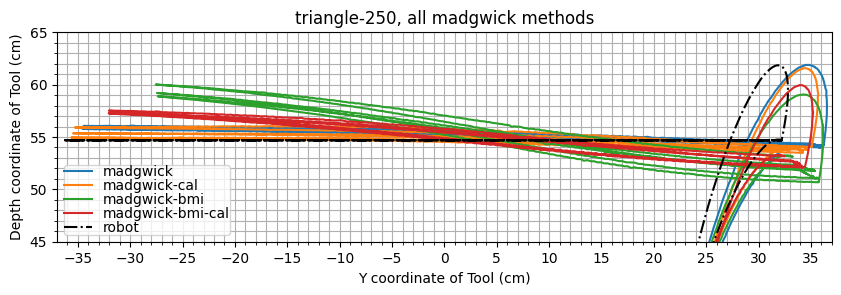

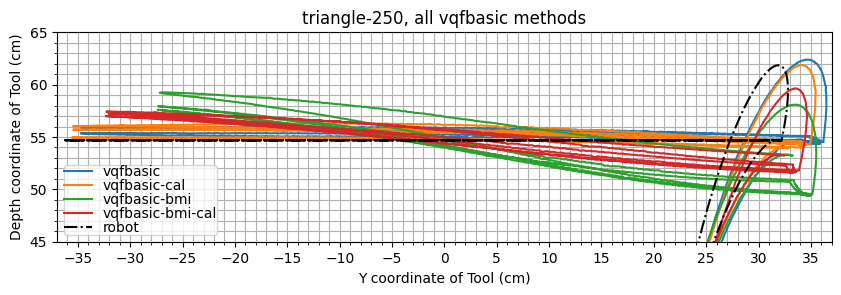

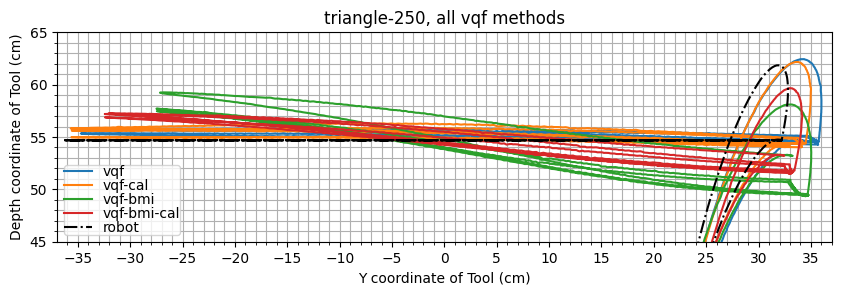

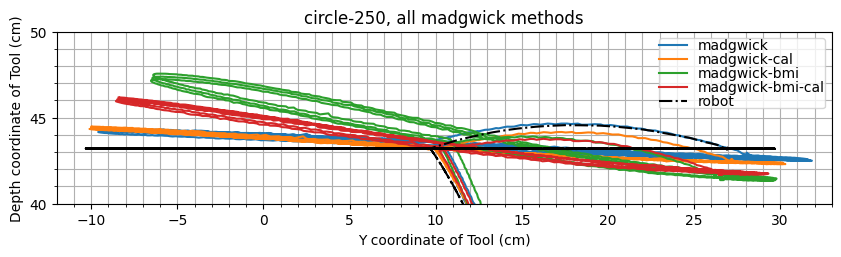

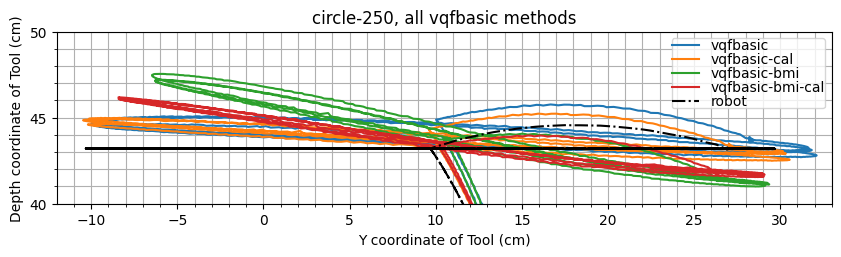

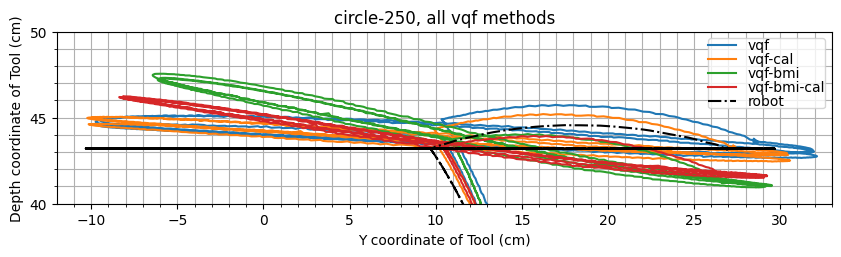

In [15]:
from matplotlib import pyplot as plt
import numpy as np
import csv

for scenario in ['triangle-250', 'circle-250']:
    robot_tcp = 100*read_tcp_csv(robot_tcp_filename(scenario))#[1000:2000]
    for algorithm in ['madgwick', 'vqfbasic', 'vqf']:
        plt.figure(figsize=(10,6))
        for method in methods:
            if 'robot' in method: continue
            if not (algorithm == method or (algorithm + '-') in method): continue
            imu_tcp = 100*read_tcp_csv(reconstructed_tcp_filename(scenario, method))
            plt.plot(imu_tcp[:, 0], imu_tcp[:, 2], label=method)
        plt.plot(-robot_tcp[:, 1], -robot_tcp[:, 0], label='robot', color='k', ls='-.')
        plt.gca().set_aspect(1)
        plt.legend(borderpad=0, labelspacing=0)
        plt.minorticks_on()
        plt.xticks(np.arange(-35, 41, 5))
        plt.yticks(np.arange(-35, 100, 5))
        if 'circle' in scenario:
            plt.xlim(-12, 33)
            plt.ylim(40, 50)
        else:
            plt.xlim(-37, 37)
            plt.ylim(45, 65)
        plt.grid(which='both')
        plt.title(f'{scenario}, all {algorithm} methods')
        plt.xlabel('Y coordinate of Tool (cm)')
        plt.ylabel('Depth coordinate of Tool (cm)')
        plt.show()

### Plot of all TCP paths for all scenarios and methods

For overview only. Too many plots.

circle-100 vqfbasic


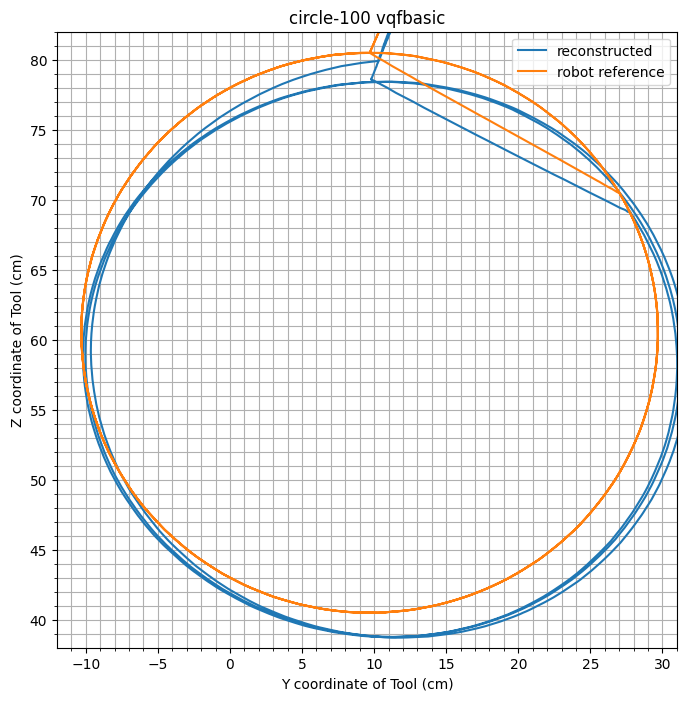

circle-100 vqfbasic-cal


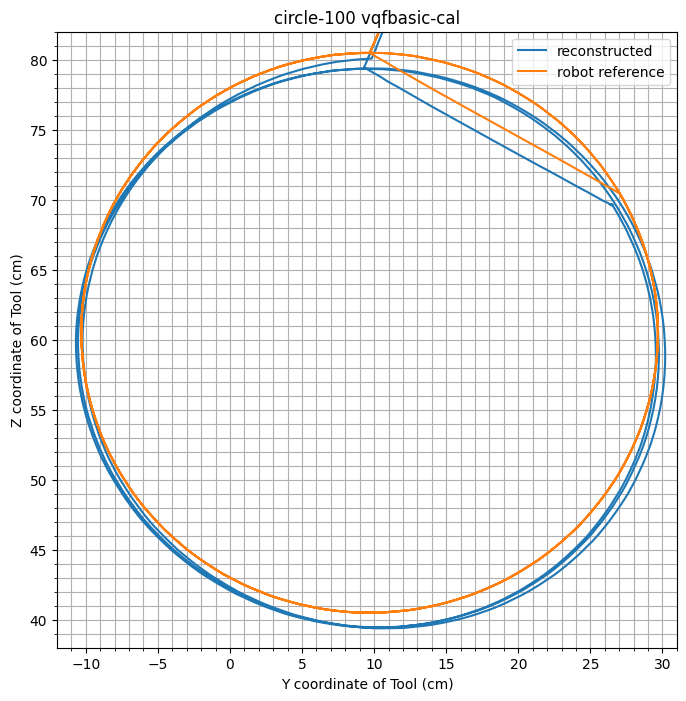

circle-100 vqfbasic-bmi


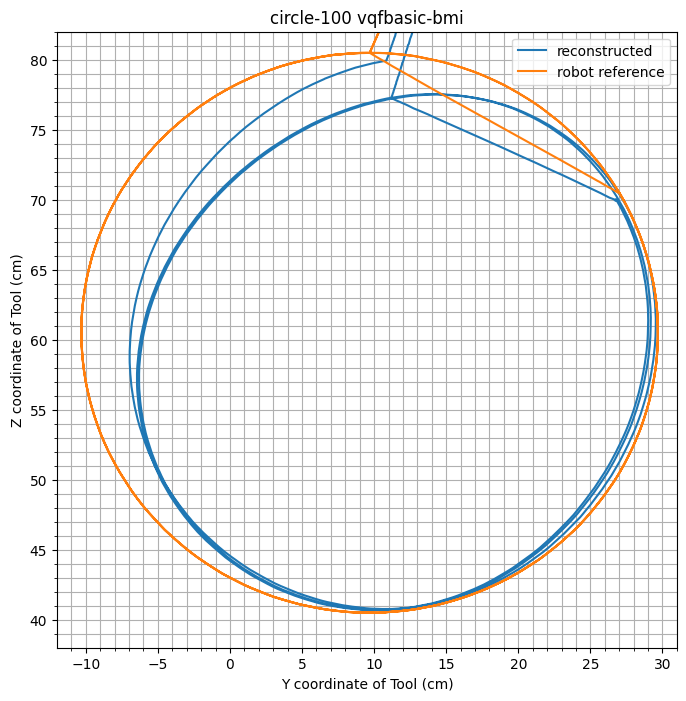

circle-100 vqfbasic-bmi-cal


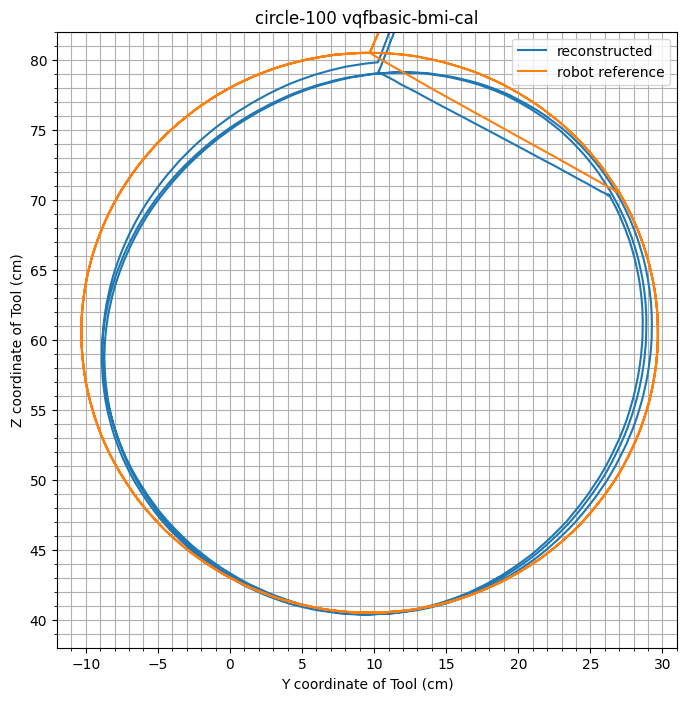

circle-100 vqf


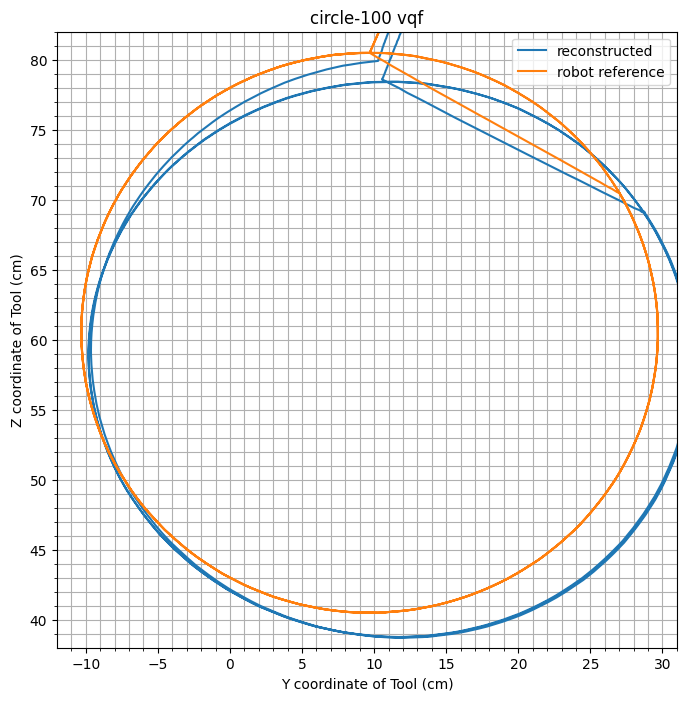

circle-100 vqf-cal


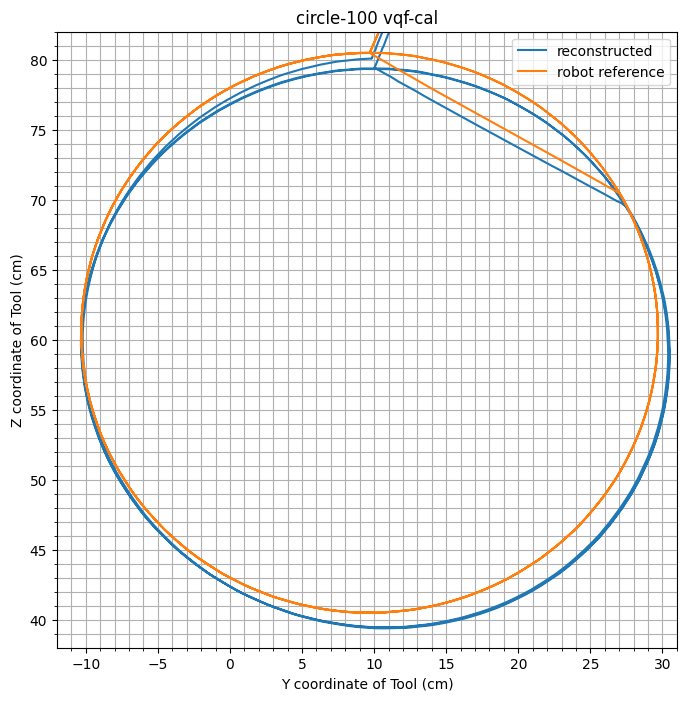

circle-100 vqf-bmi


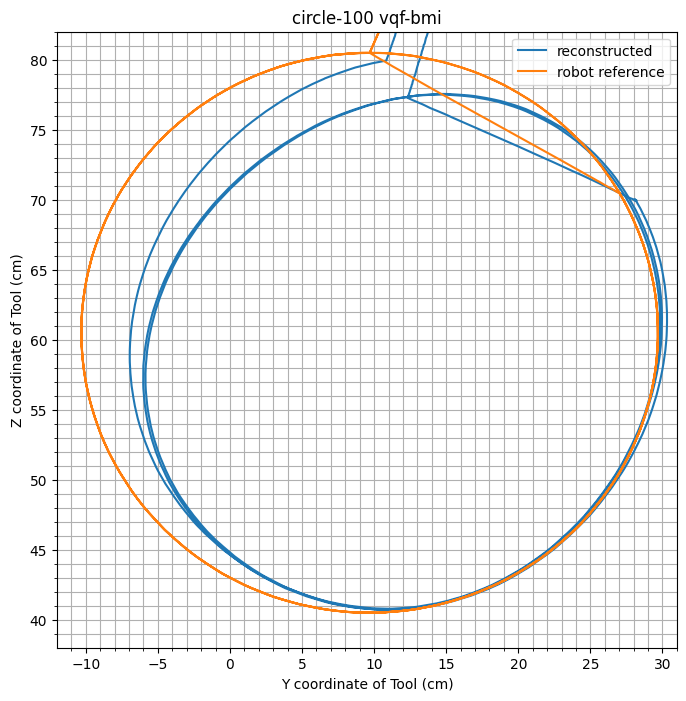

circle-100 vqf-bmi-cal


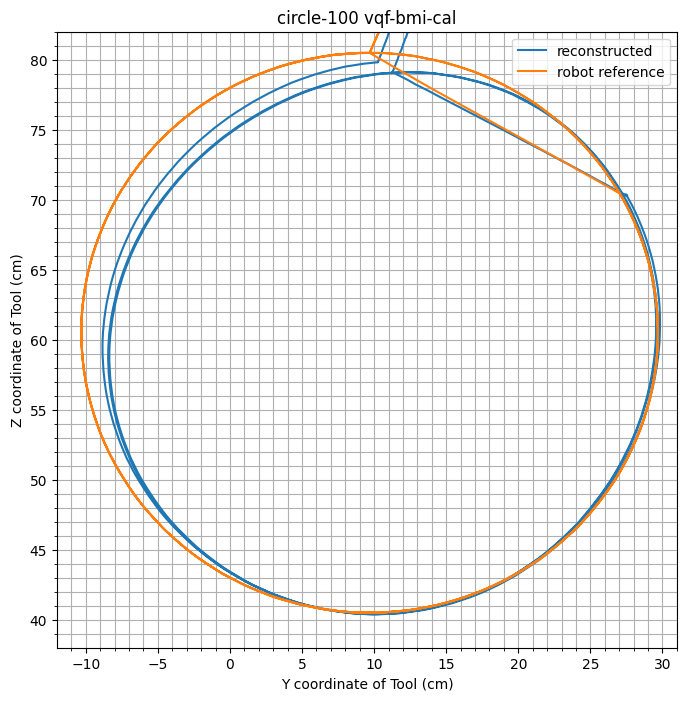

circle-100 madgwick


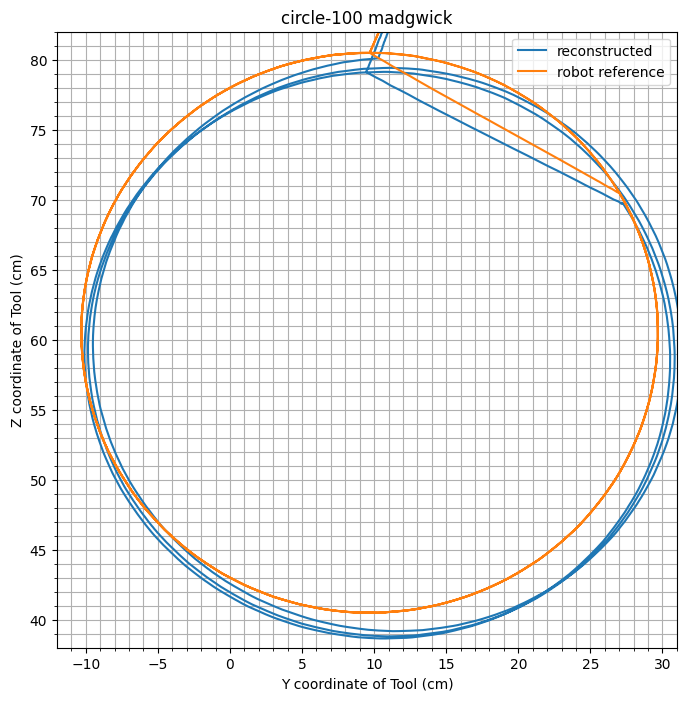

circle-100 madgwick-cal


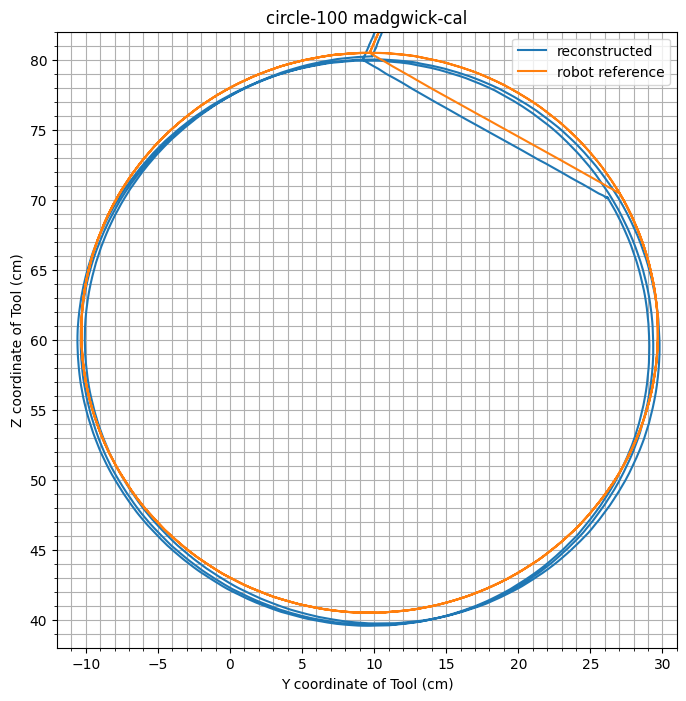

circle-100 madgwick-bmi


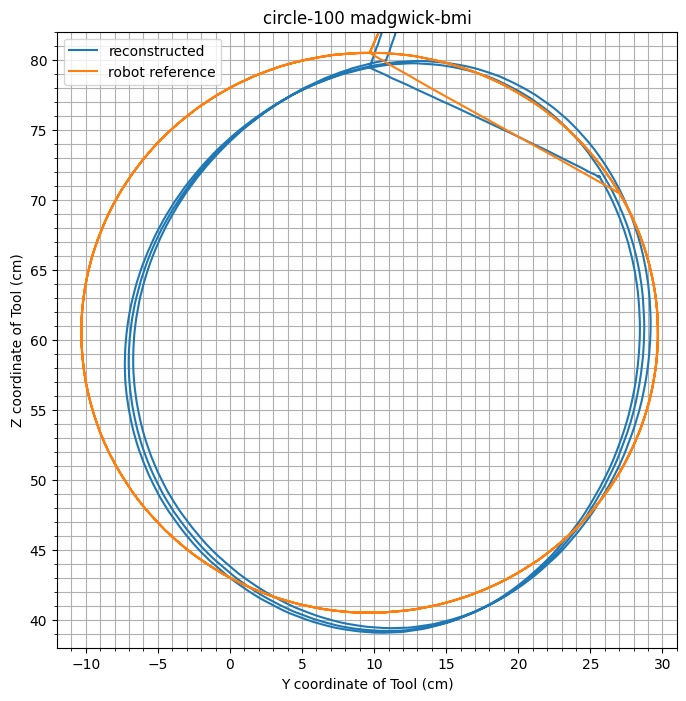

circle-100 madgwick-bmi-cal


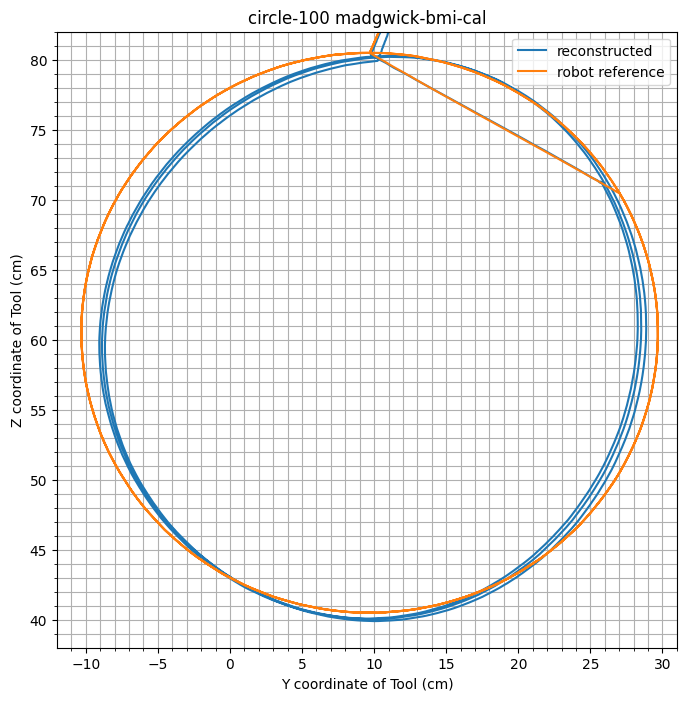

circle-150 vqfbasic


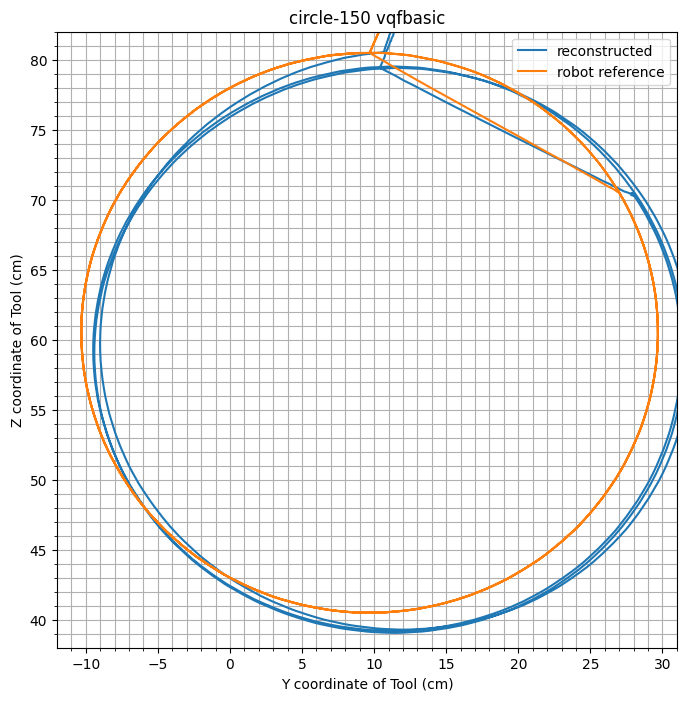

circle-150 vqfbasic-cal


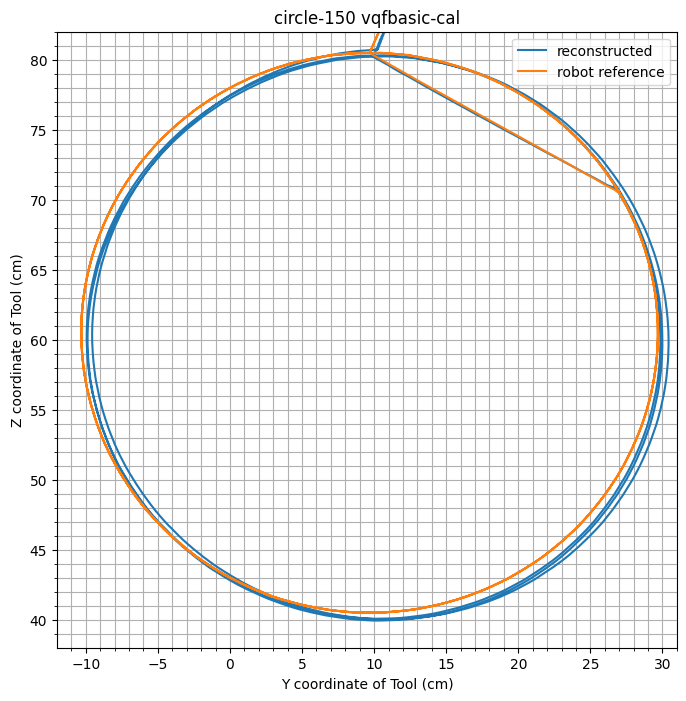

circle-150 vqfbasic-bmi


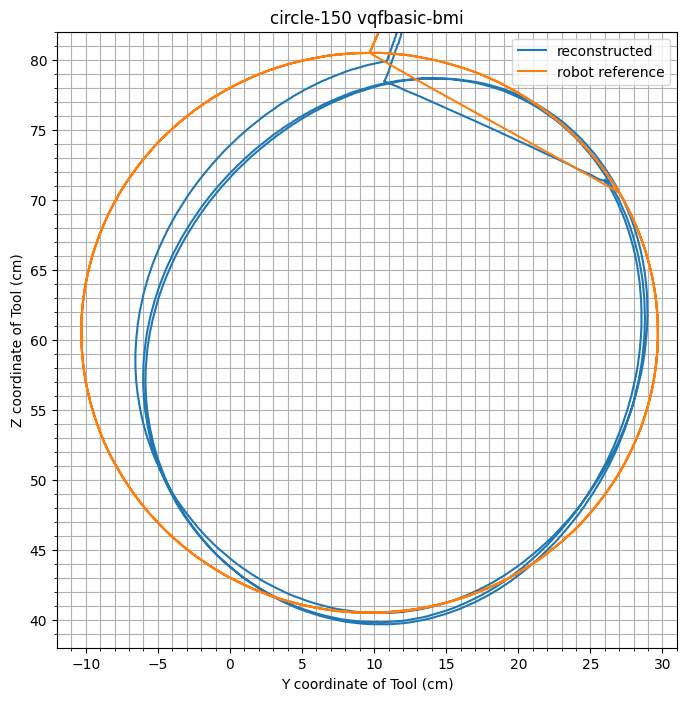

circle-150 vqfbasic-bmi-cal


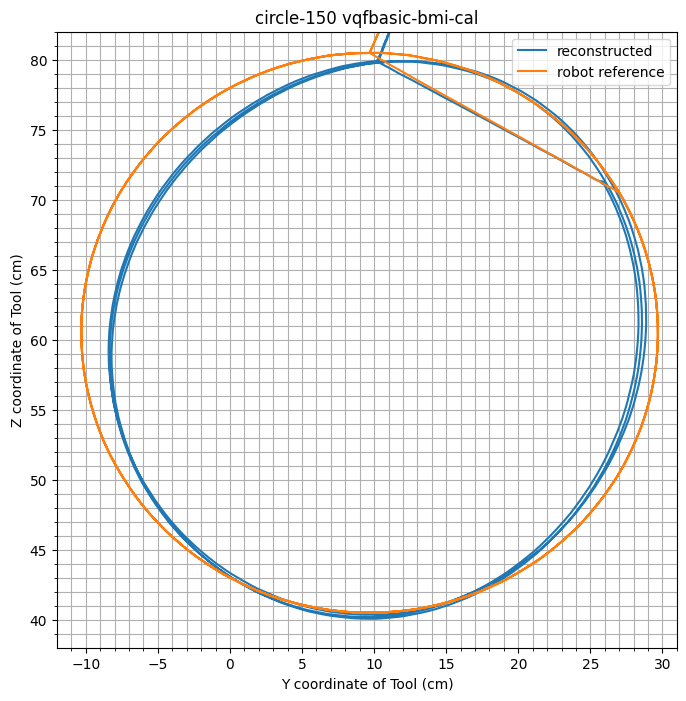

circle-150 vqf


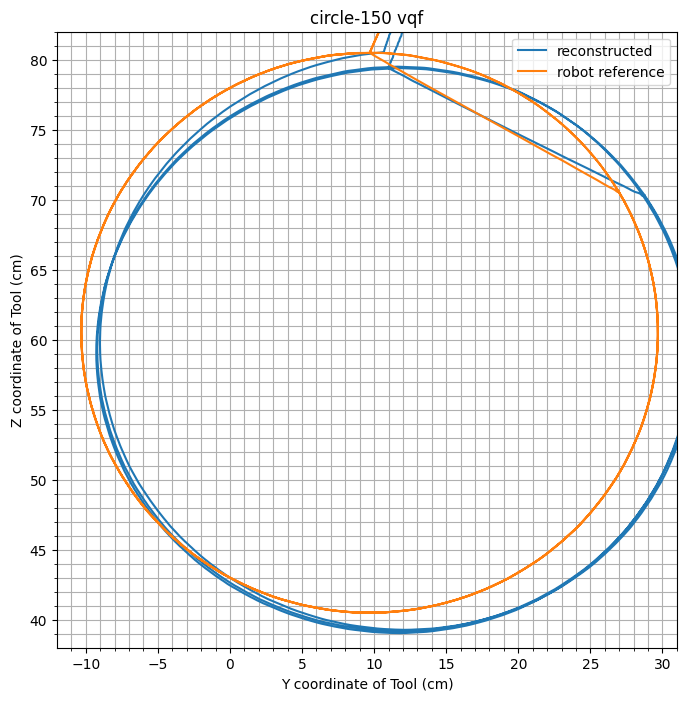

circle-150 vqf-cal


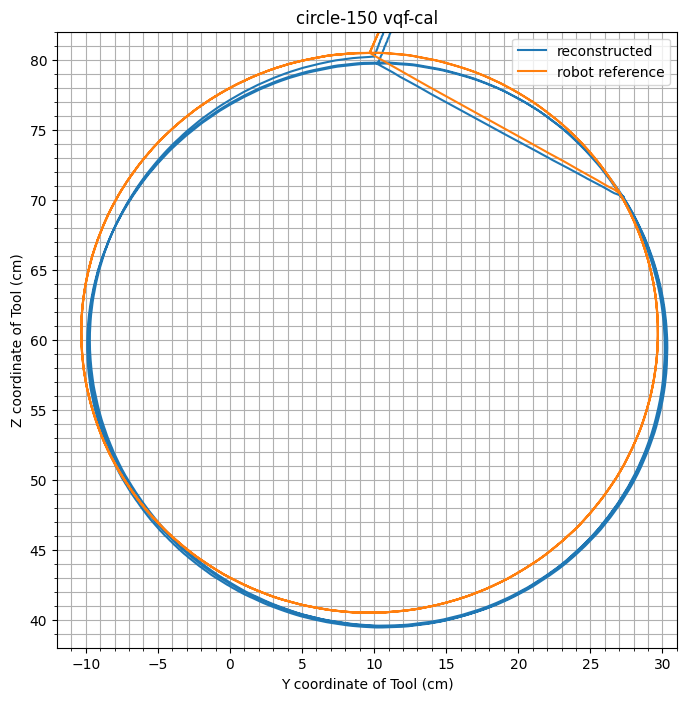

circle-150 vqf-bmi


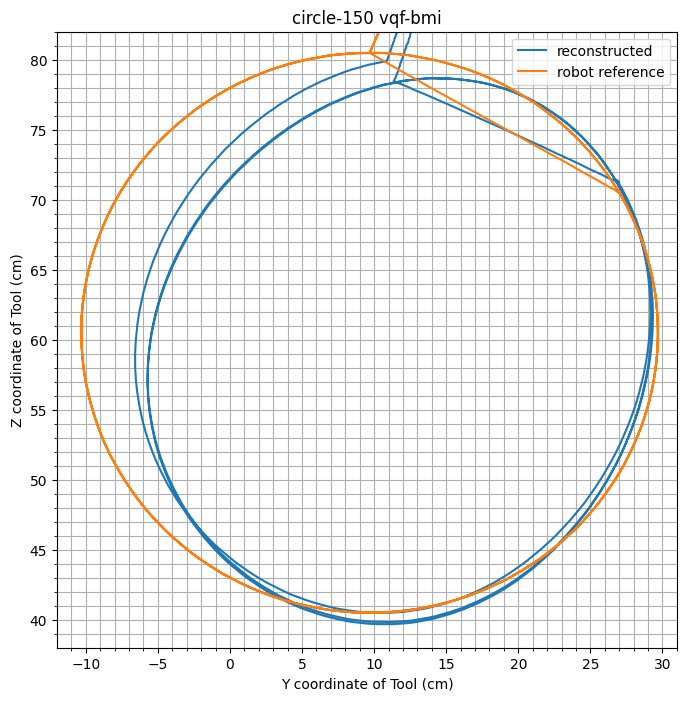

circle-150 vqf-bmi-cal


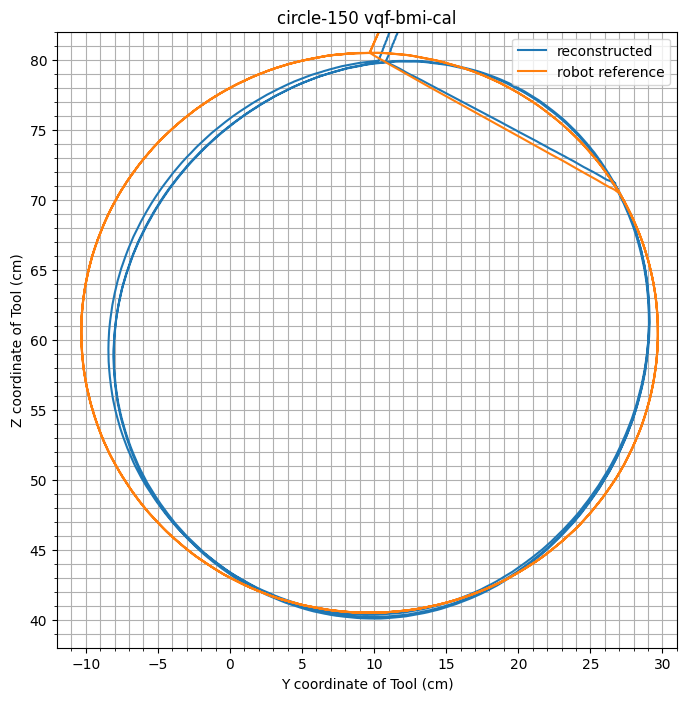

circle-150 madgwick


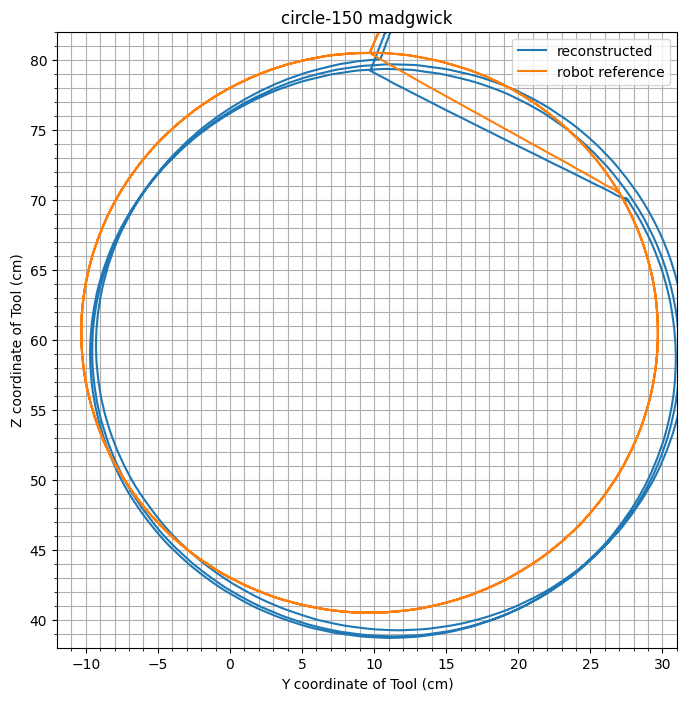

circle-150 madgwick-cal


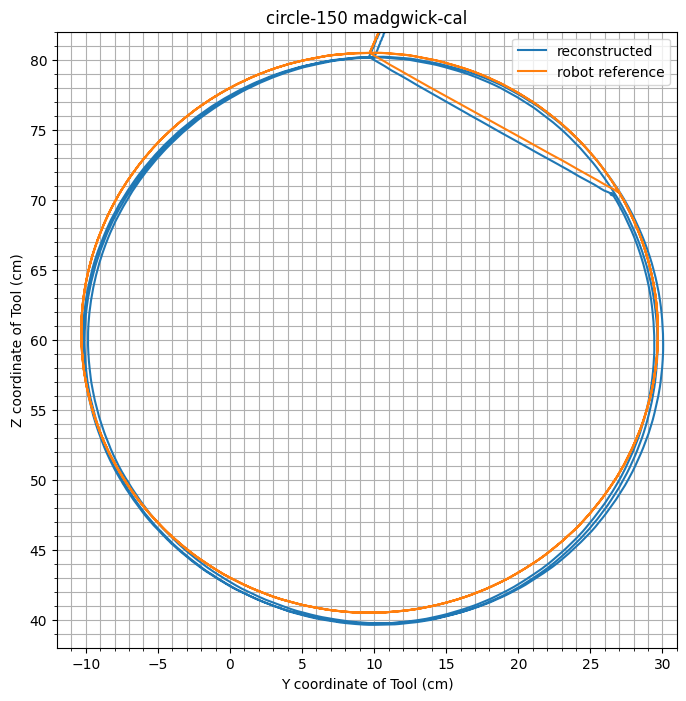

circle-150 madgwick-bmi


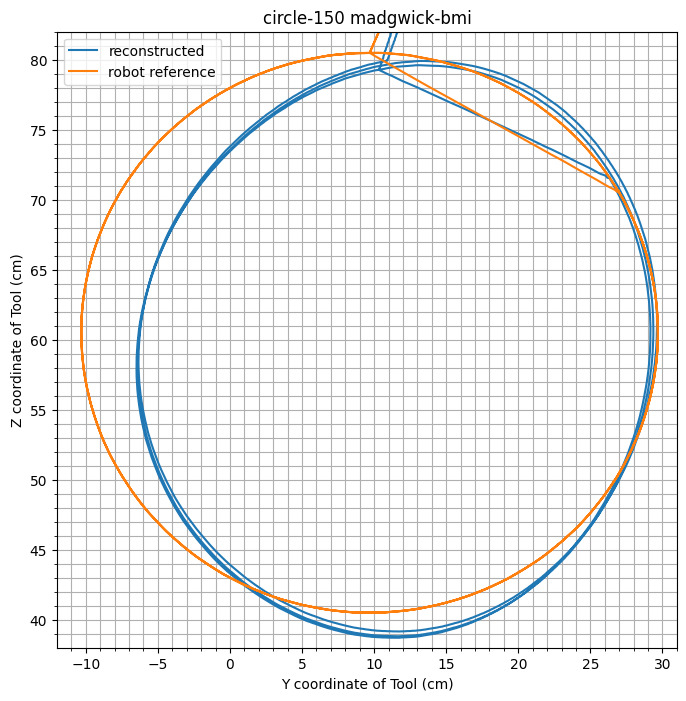

circle-150 madgwick-bmi-cal


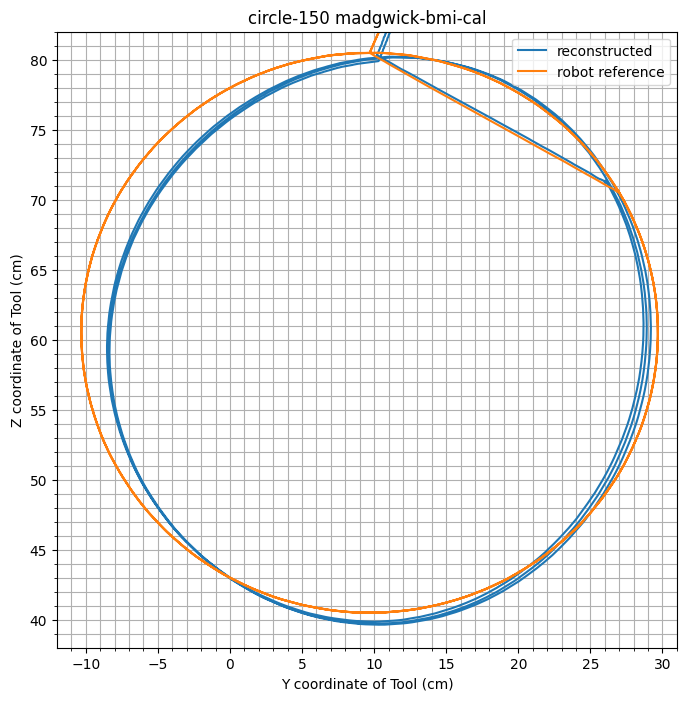

circle-200 vqfbasic


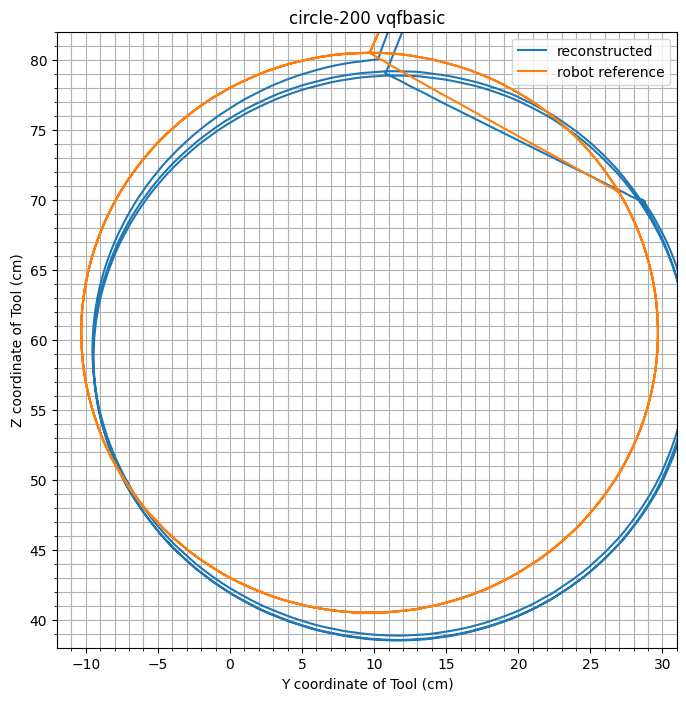

circle-200 vqfbasic-cal


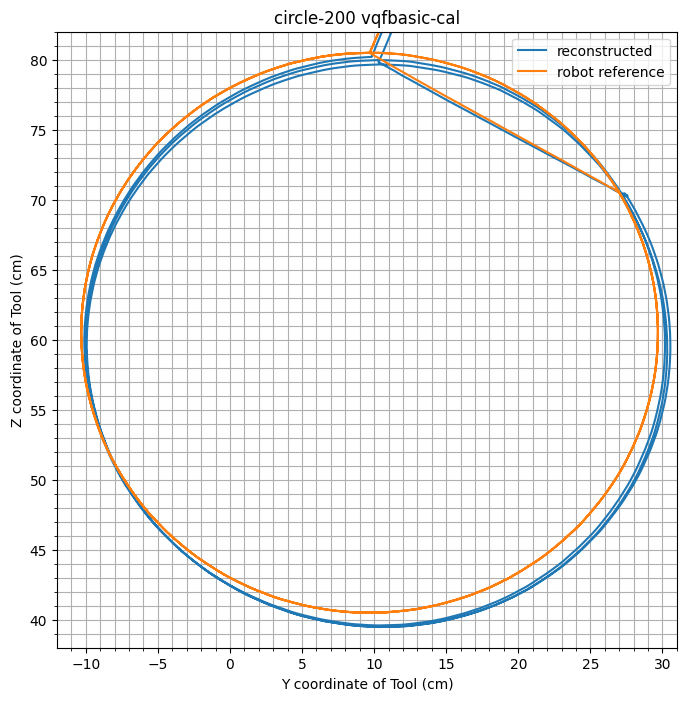

circle-200 vqfbasic-bmi


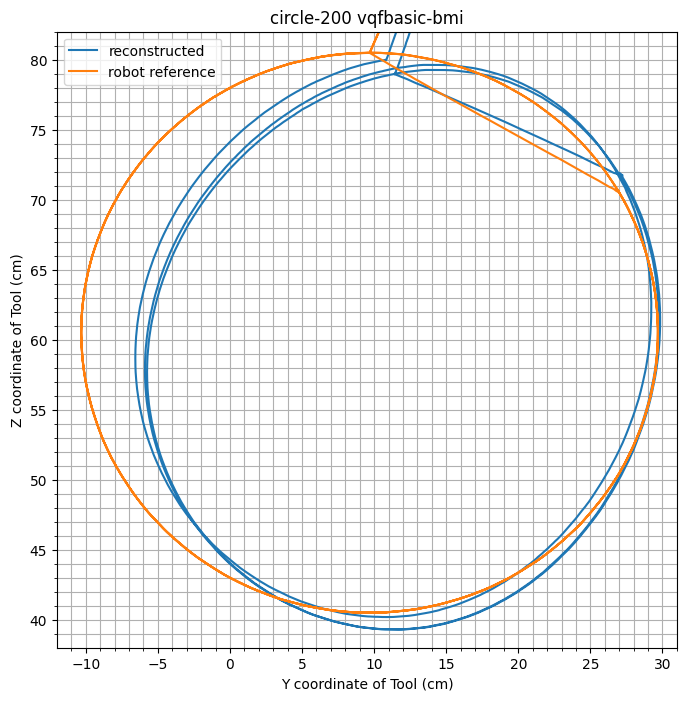

circle-200 vqfbasic-bmi-cal


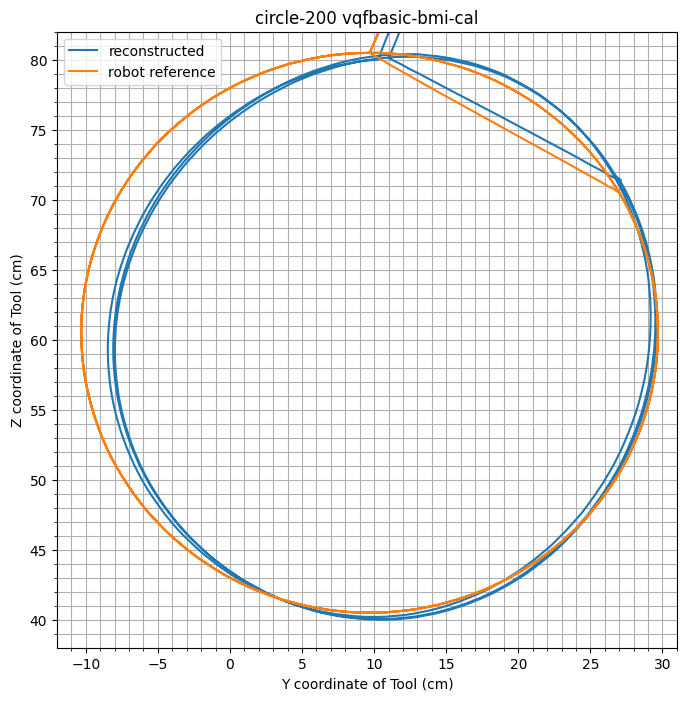

circle-200 vqf


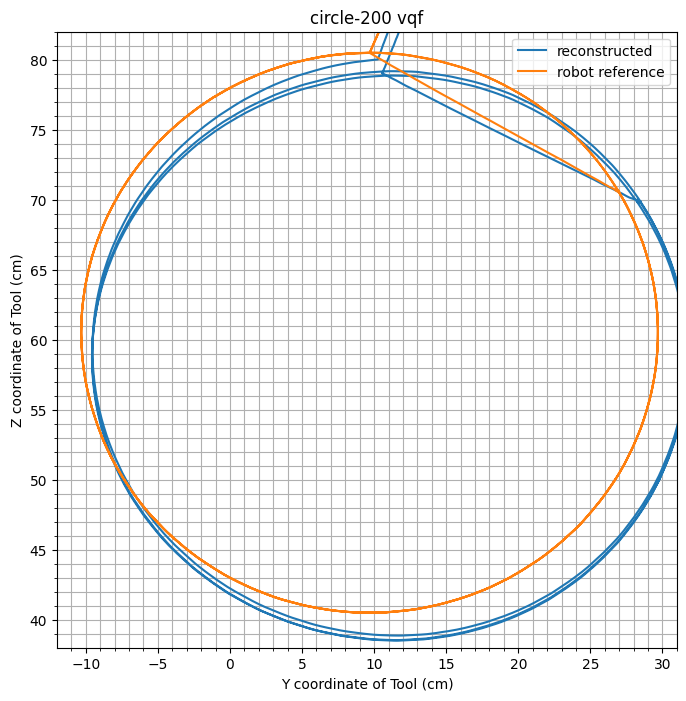

circle-200 vqf-cal


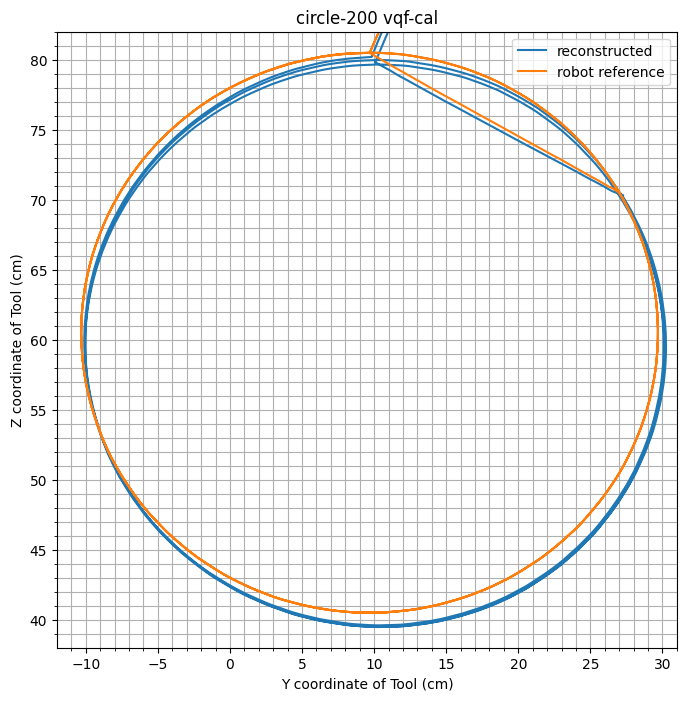

circle-200 vqf-bmi


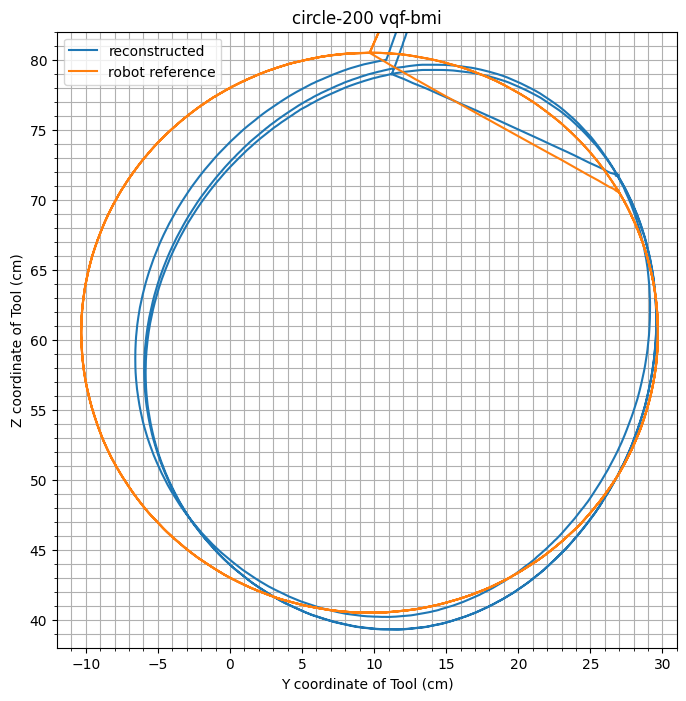

circle-200 vqf-bmi-cal


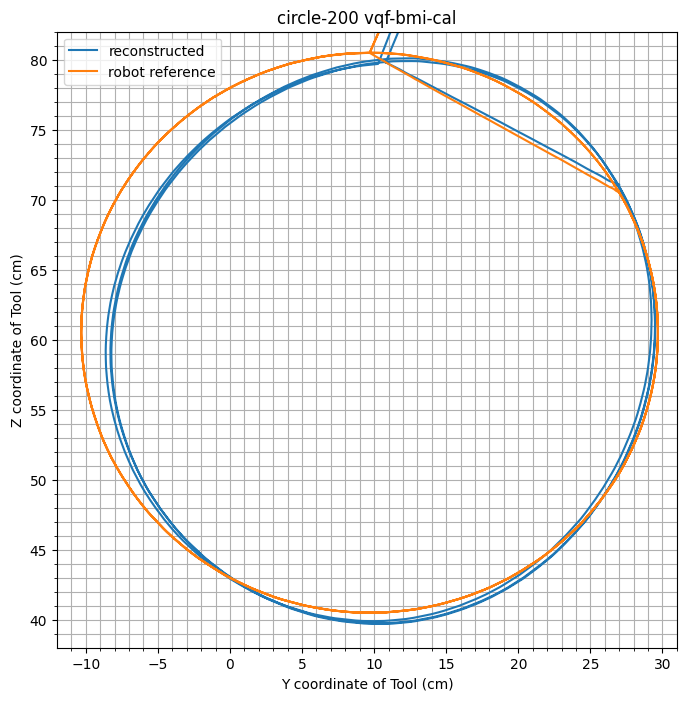

circle-200 madgwick


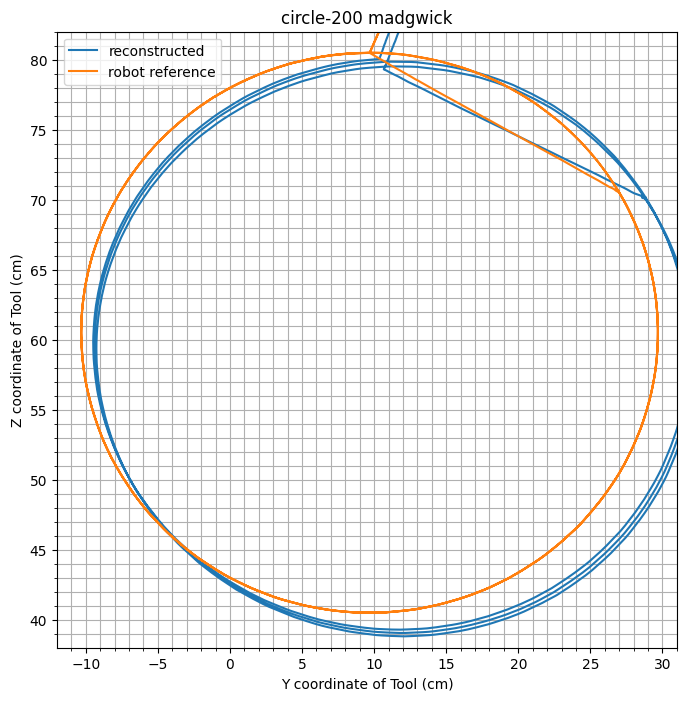

circle-200 madgwick-cal


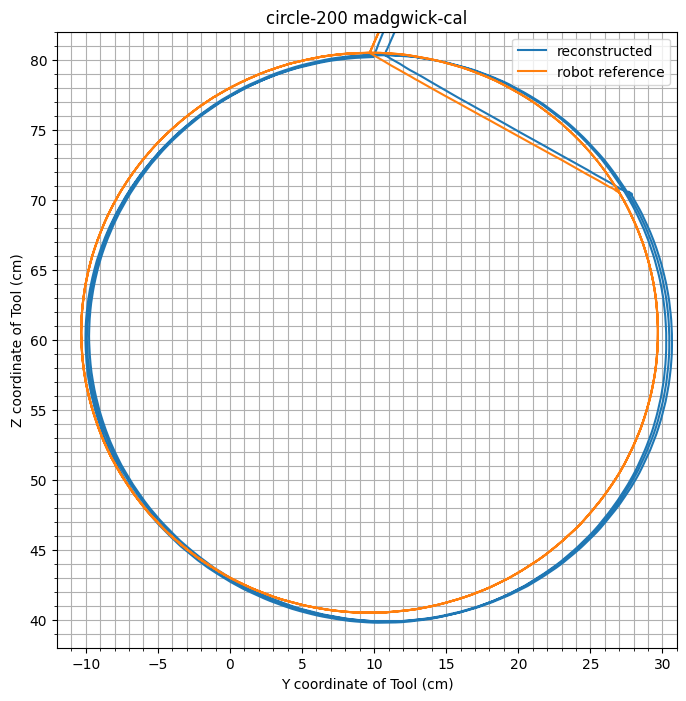

circle-200 madgwick-bmi


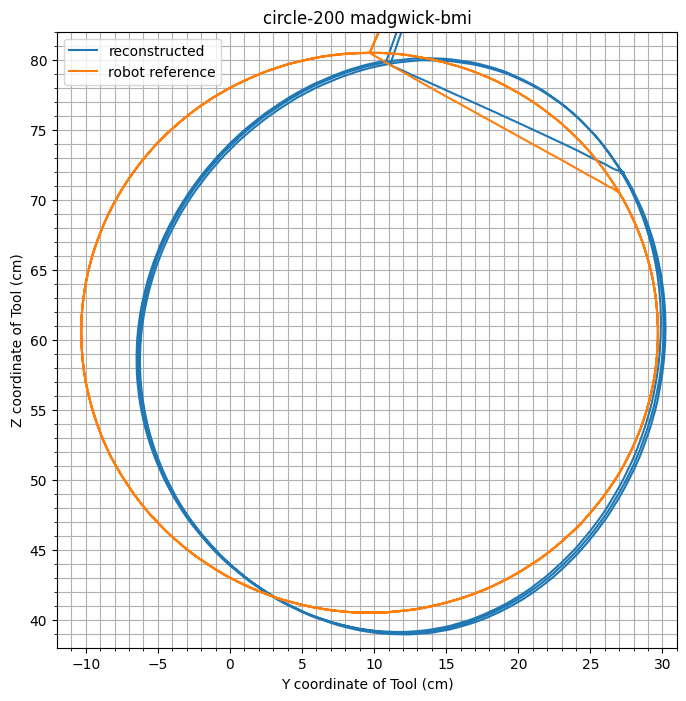

circle-200 madgwick-bmi-cal


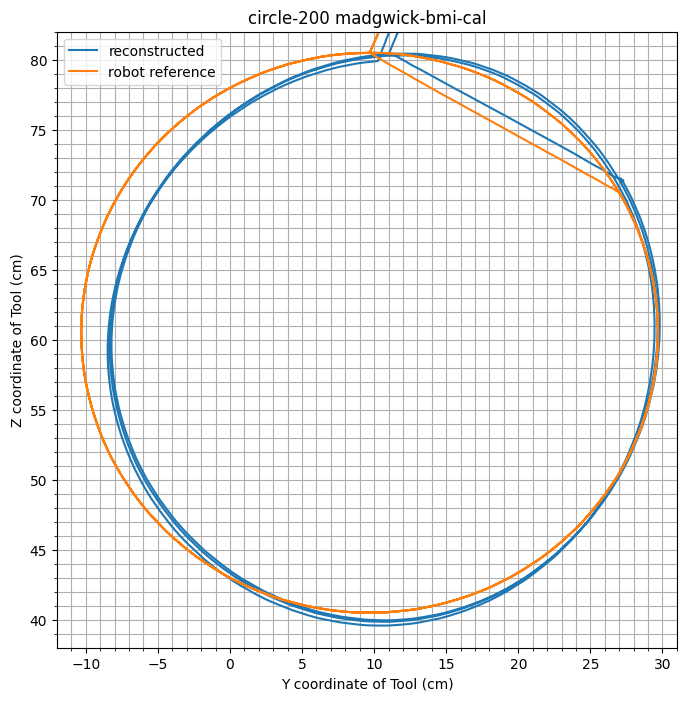

circle-250 vqfbasic


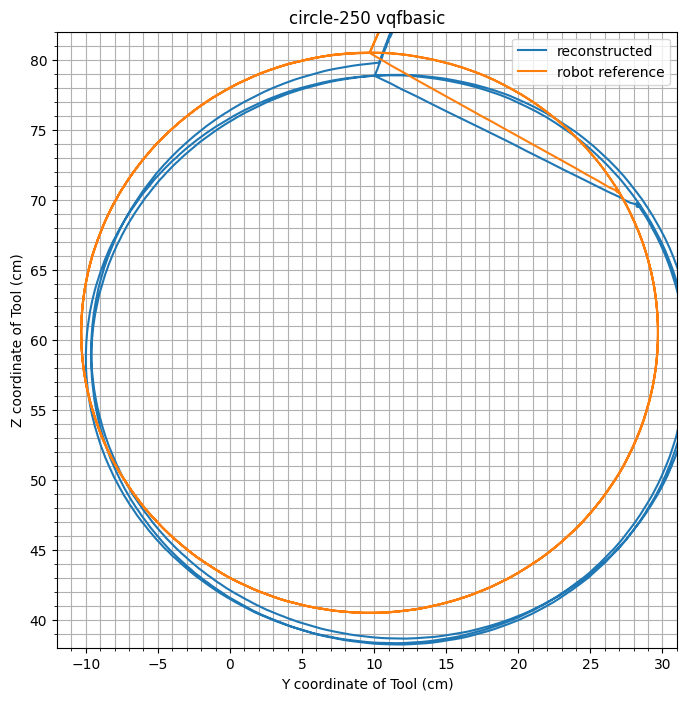

circle-250 vqfbasic-cal


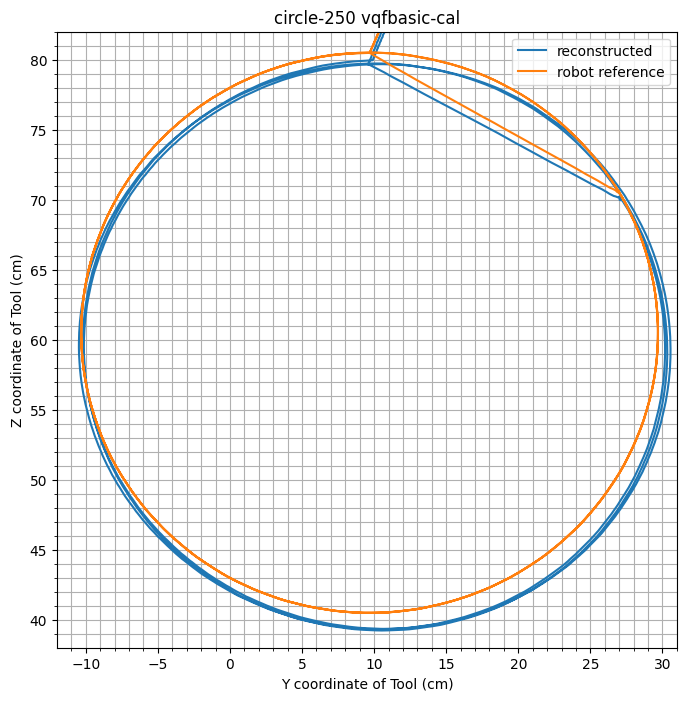

circle-250 vqfbasic-bmi


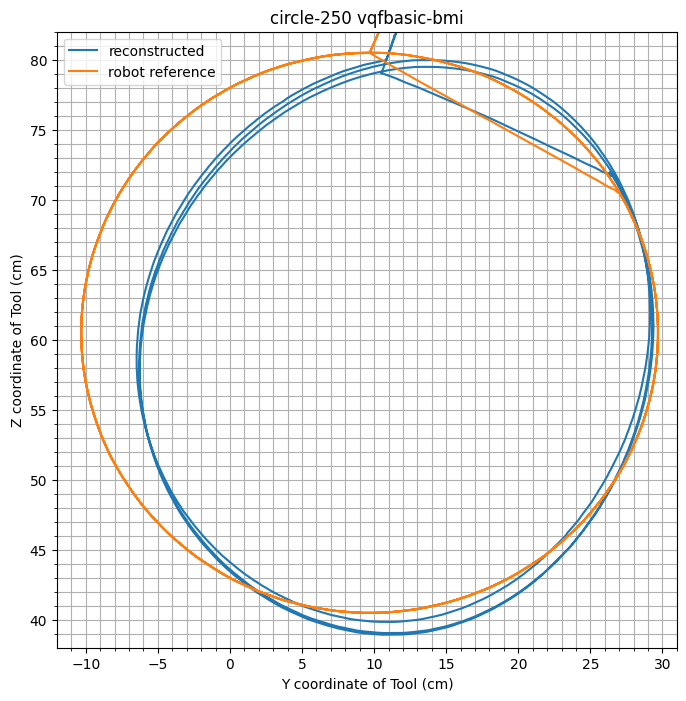

circle-250 vqfbasic-bmi-cal


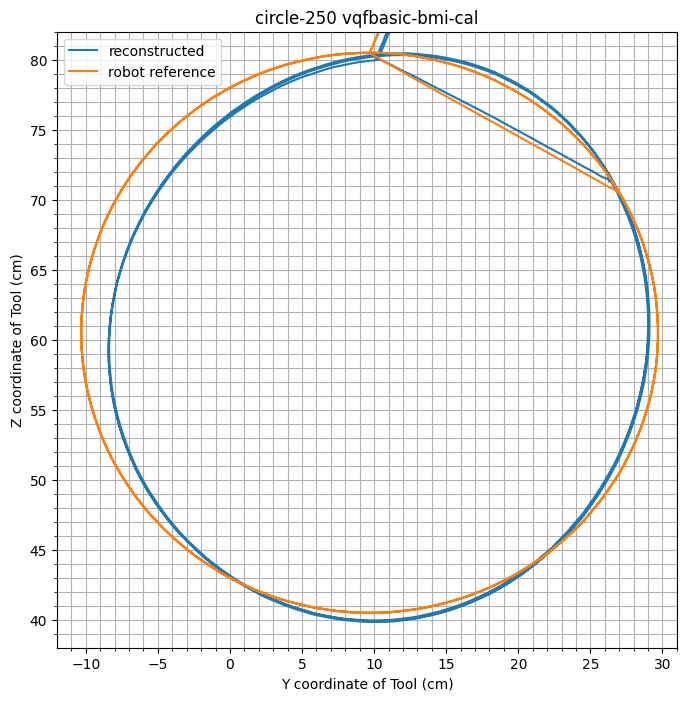

circle-250 vqf


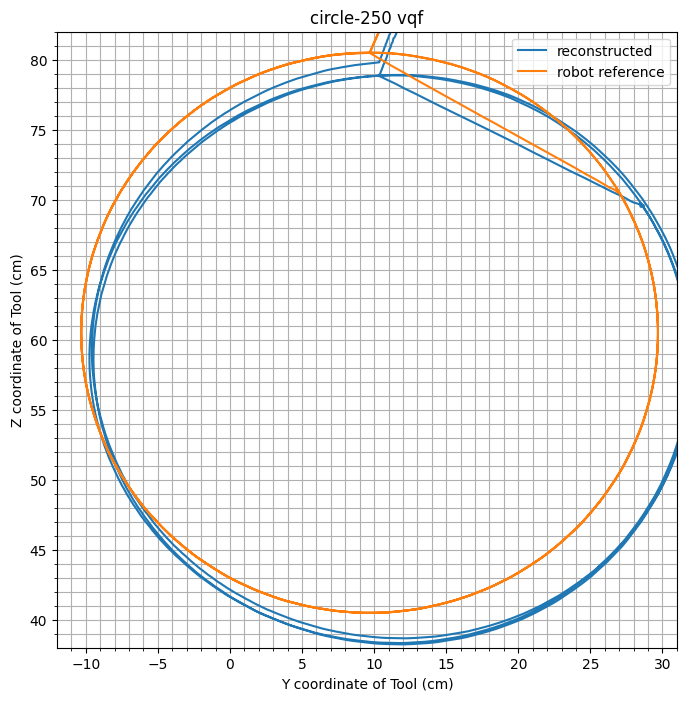

circle-250 vqf-cal


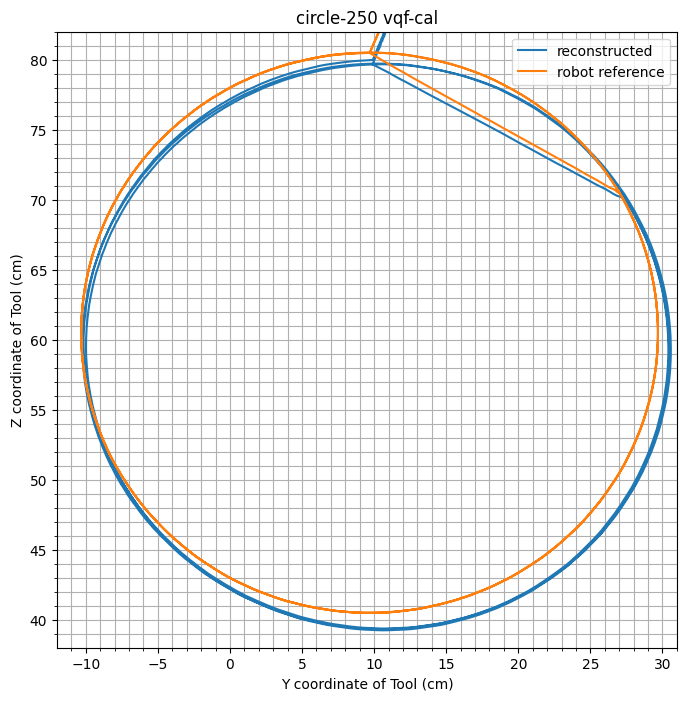

circle-250 vqf-bmi


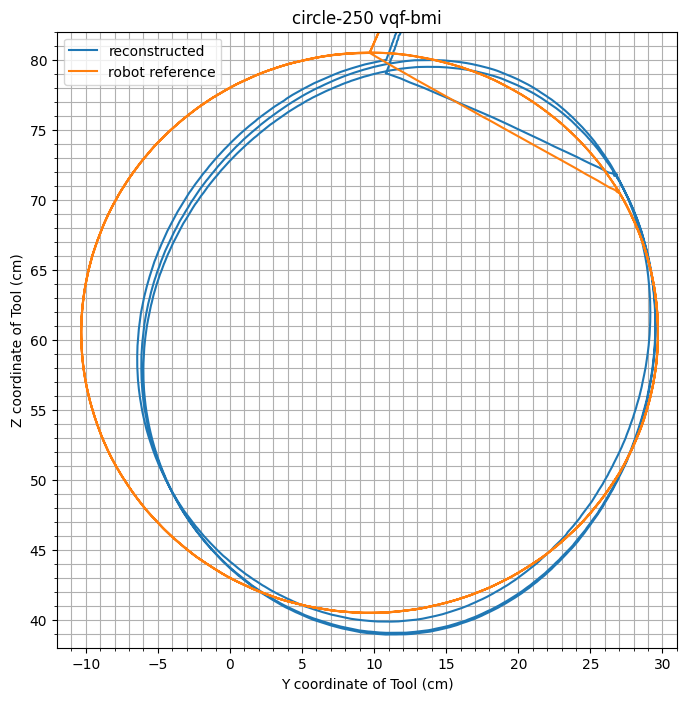

circle-250 vqf-bmi-cal


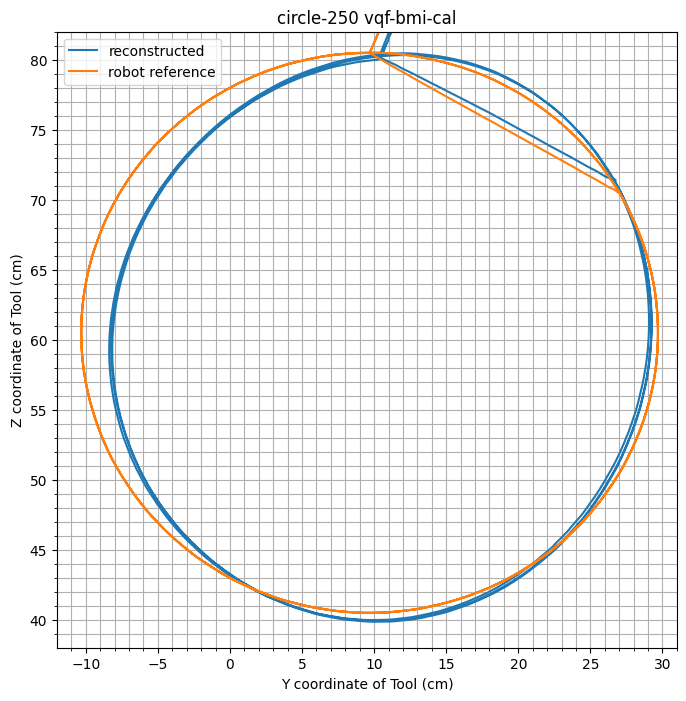

circle-250 madgwick


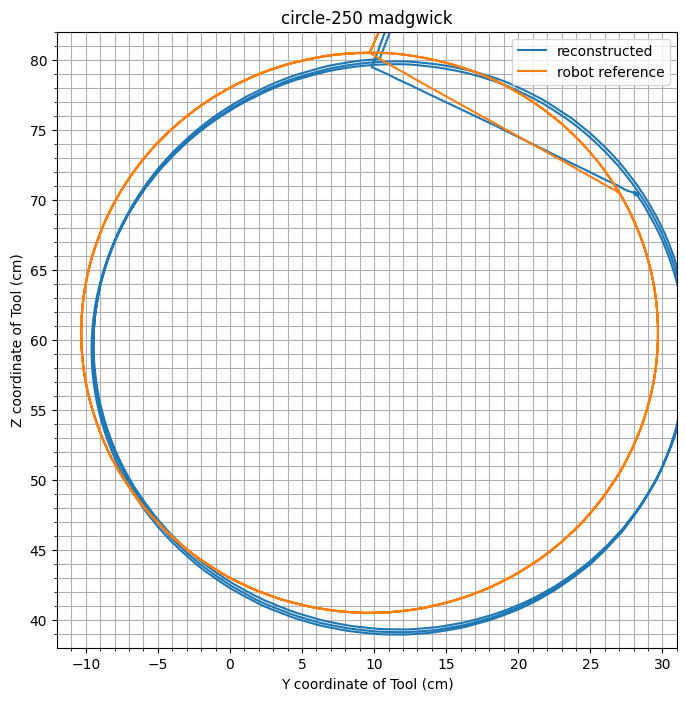

circle-250 madgwick-cal


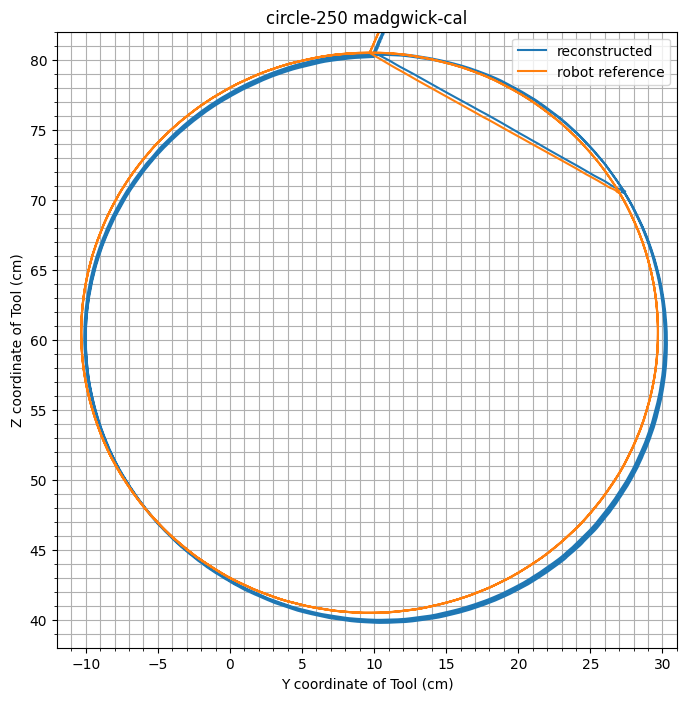

circle-250 madgwick-bmi


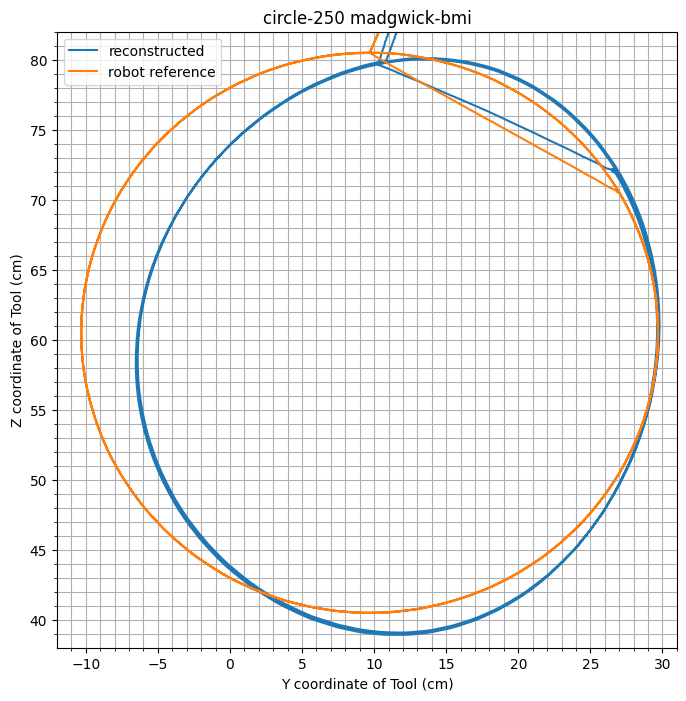

circle-250 madgwick-bmi-cal


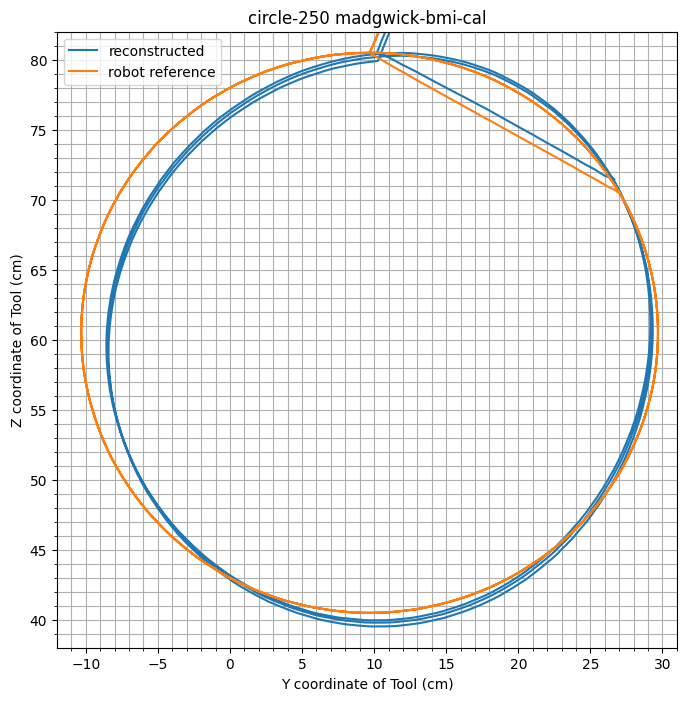

triangle-100 vqfbasic


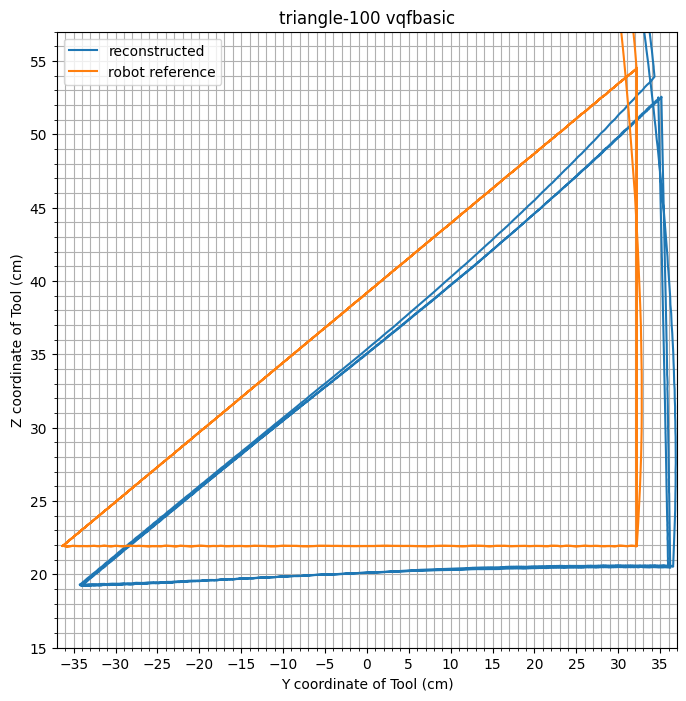

triangle-100 vqfbasic-cal


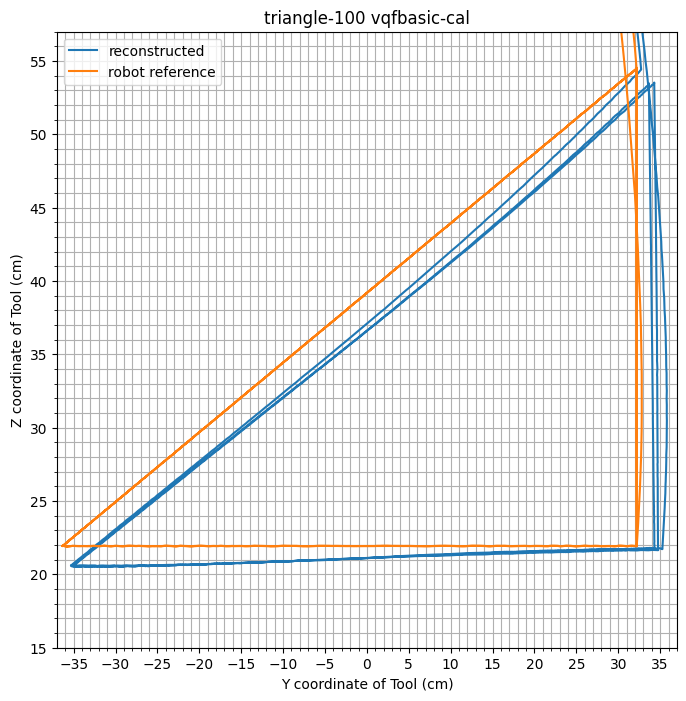

triangle-100 vqfbasic-bmi


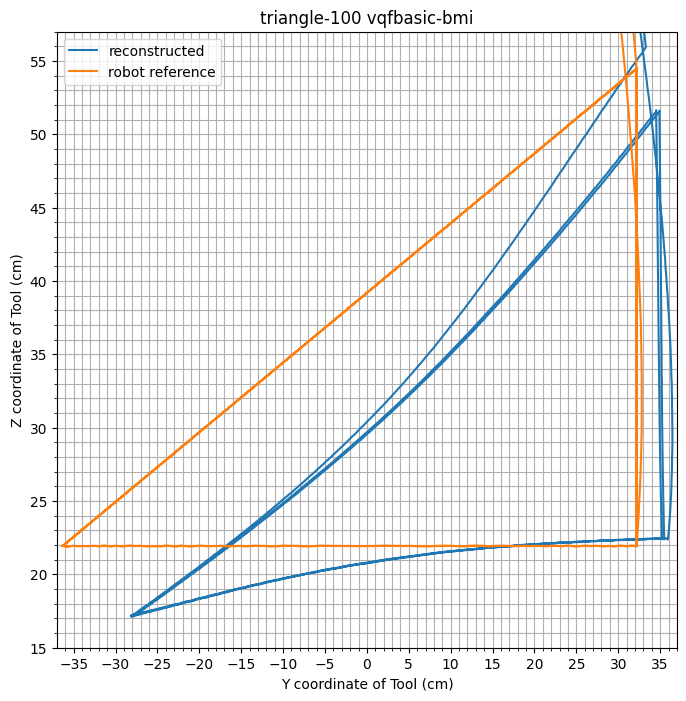

triangle-100 vqfbasic-bmi-cal


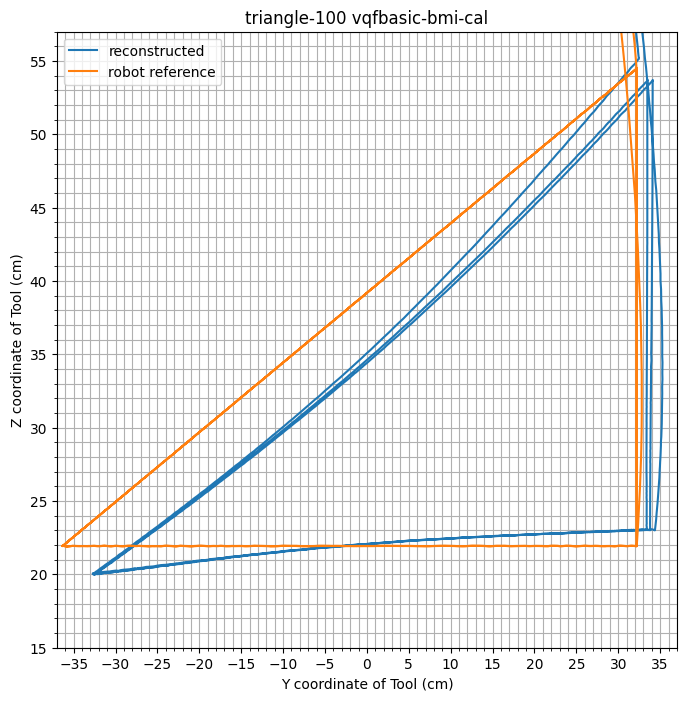

triangle-100 vqf


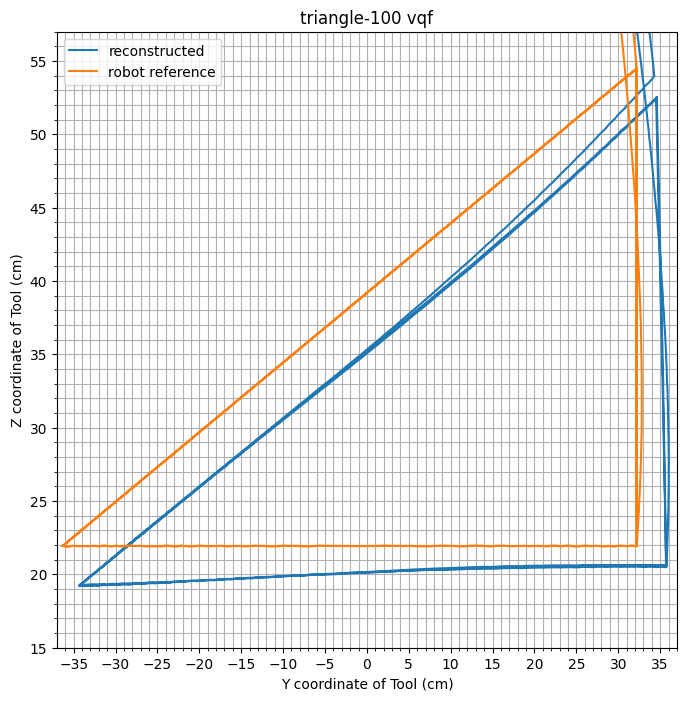

triangle-100 vqf-cal


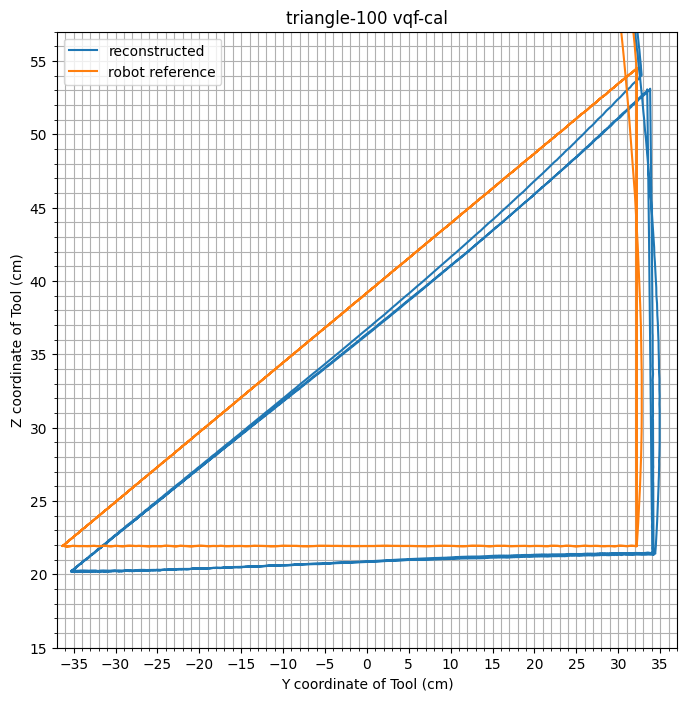

triangle-100 vqf-bmi


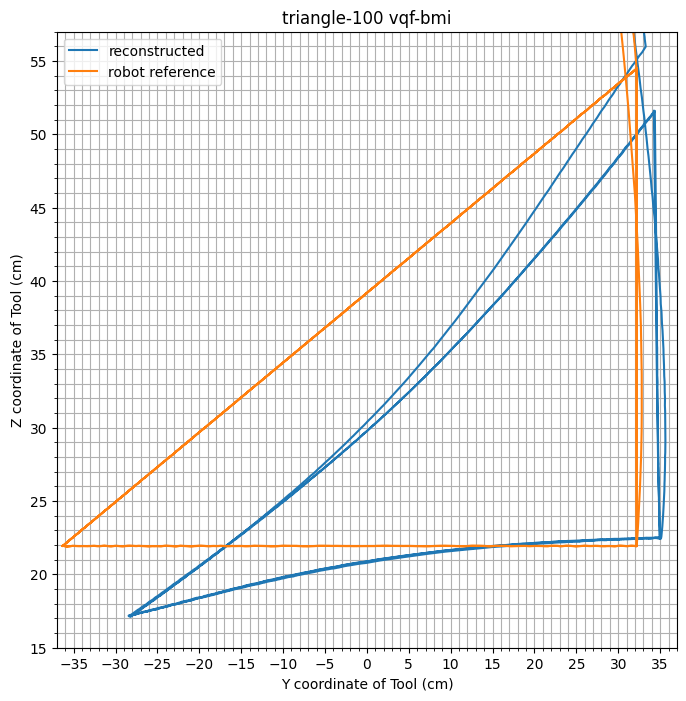

triangle-100 vqf-bmi-cal


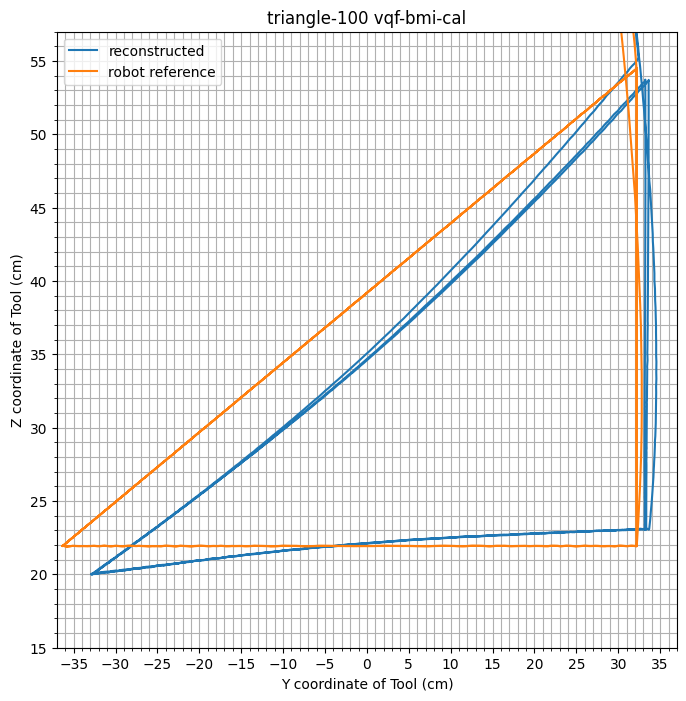

triangle-100 madgwick


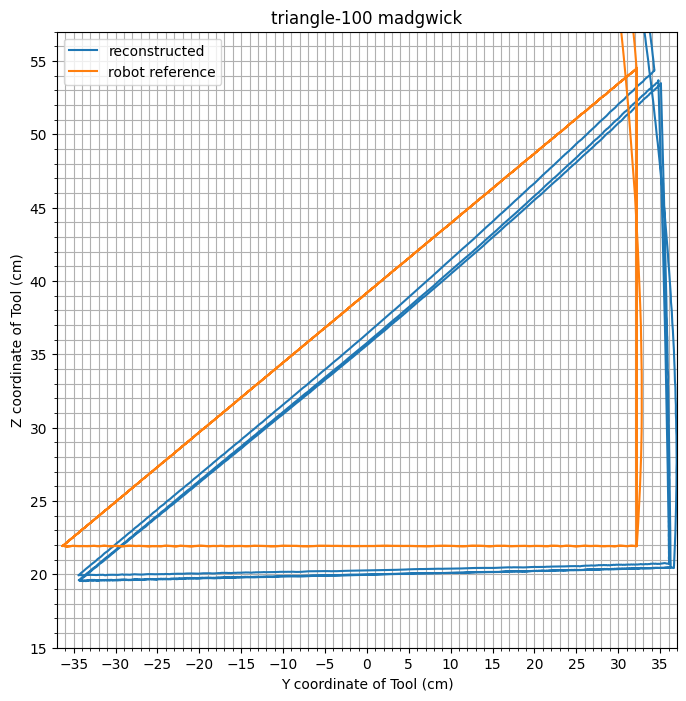

triangle-100 madgwick-cal


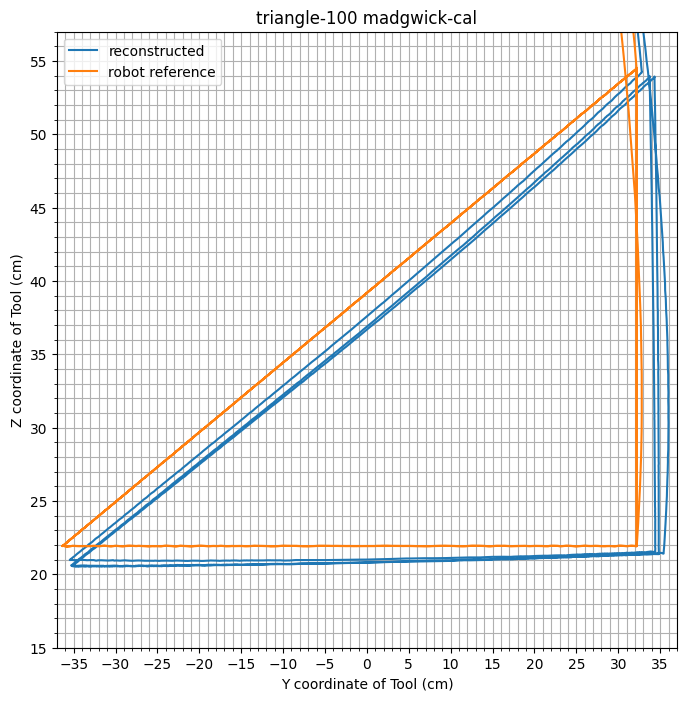

triangle-100 madgwick-bmi


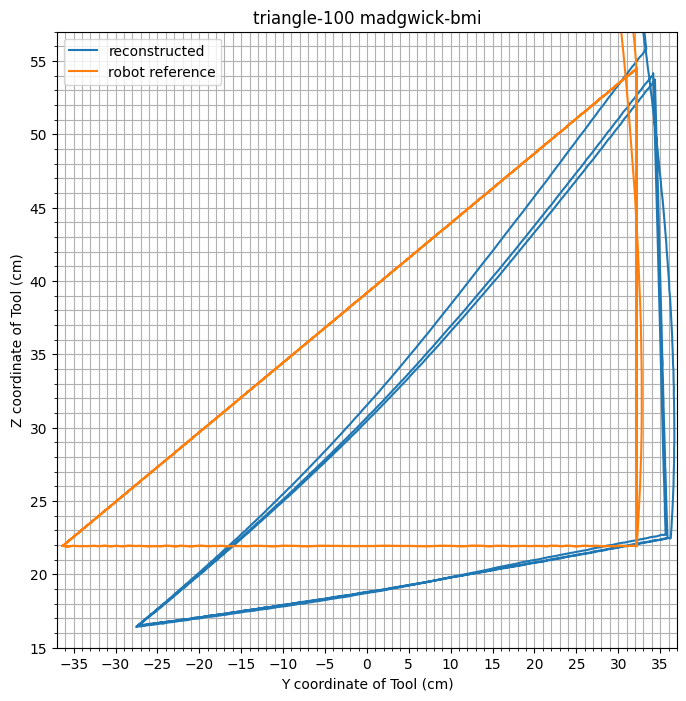

triangle-100 madgwick-bmi-cal


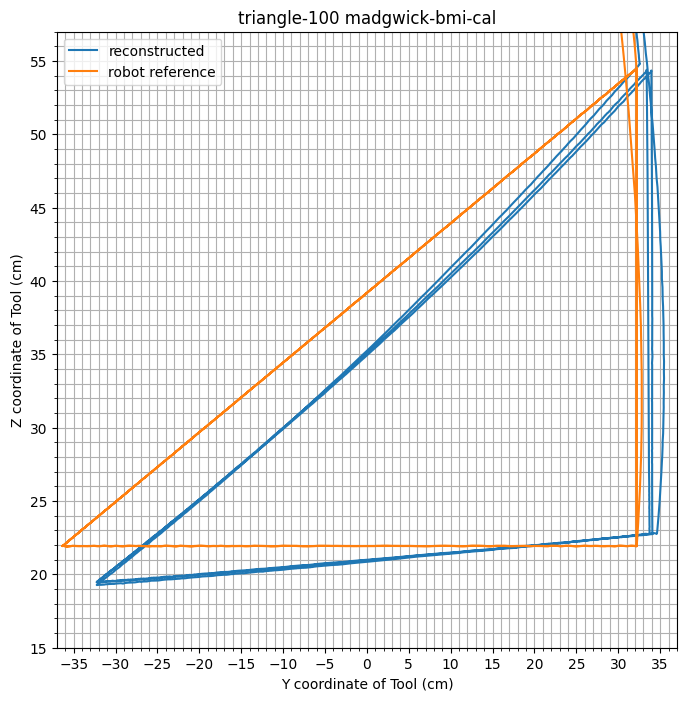

triangle-150 vqfbasic


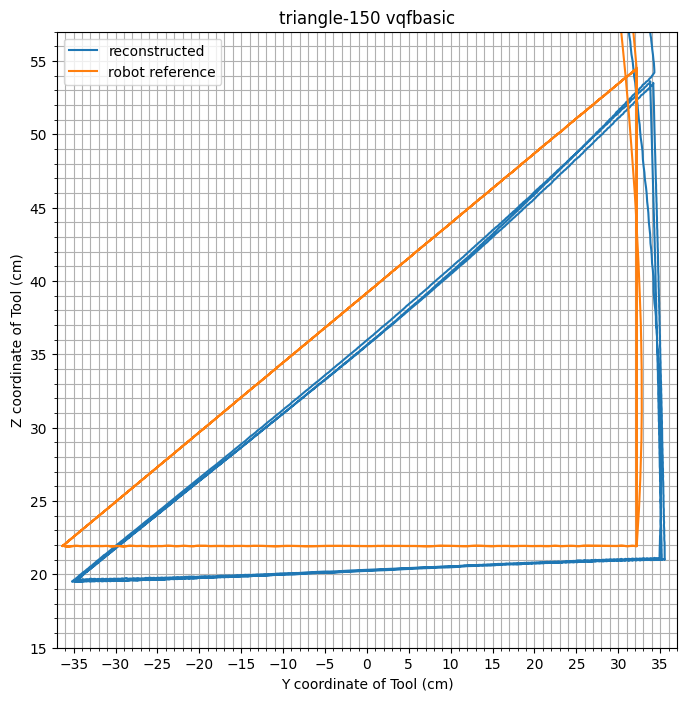

triangle-150 vqfbasic-cal


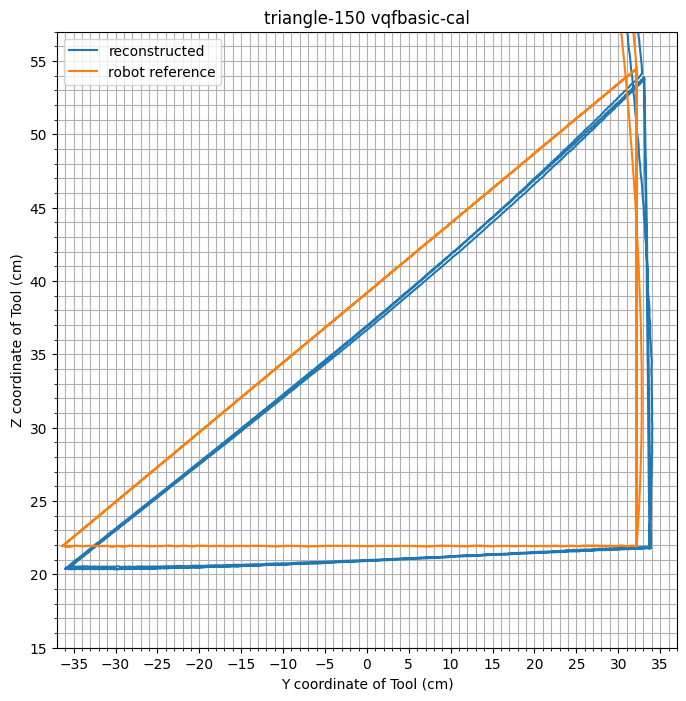

triangle-150 vqfbasic-bmi


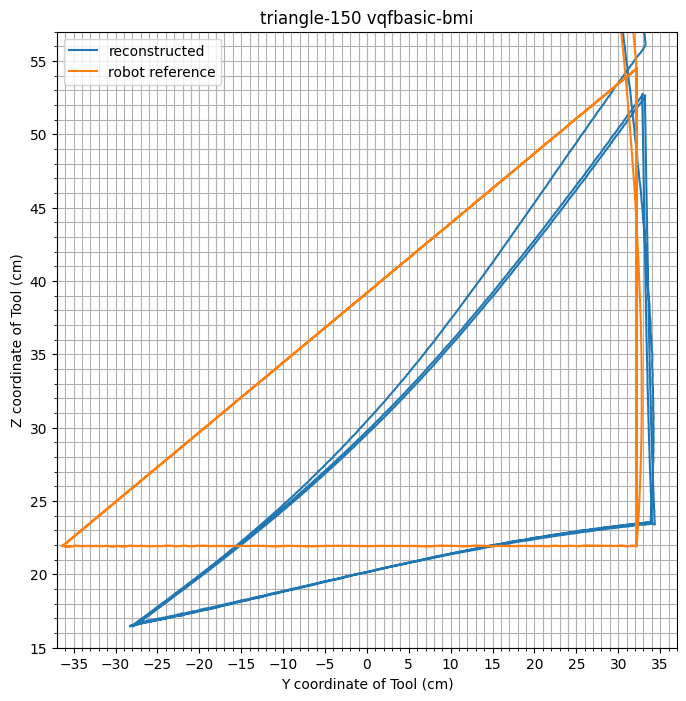

triangle-150 vqfbasic-bmi-cal


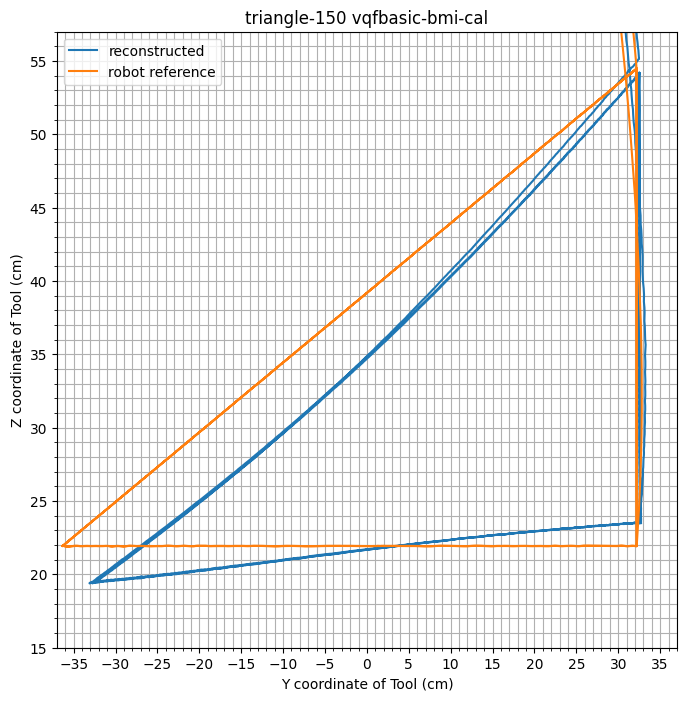

triangle-150 vqf


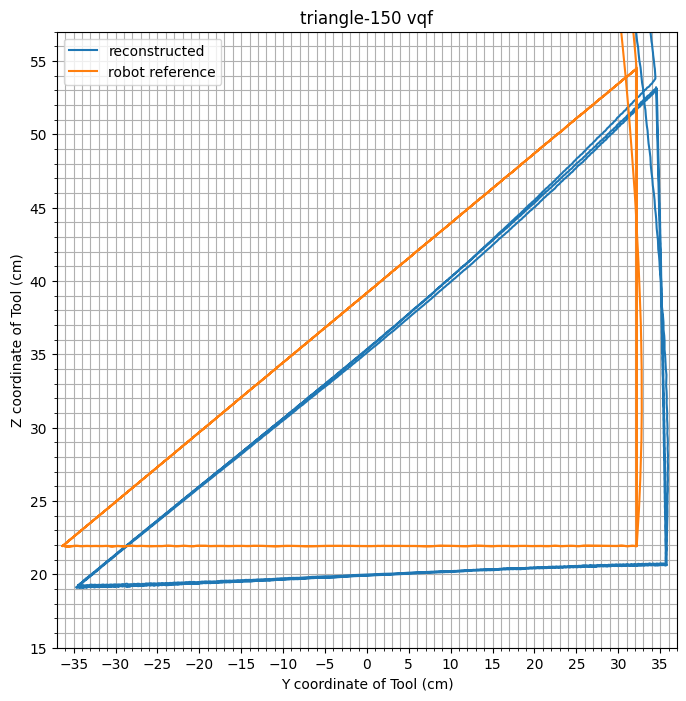

triangle-150 vqf-cal


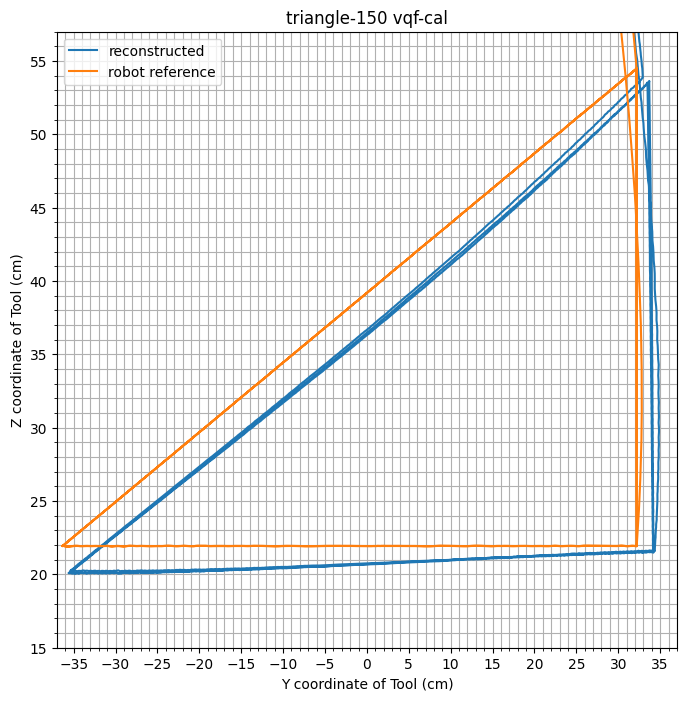

triangle-150 vqf-bmi


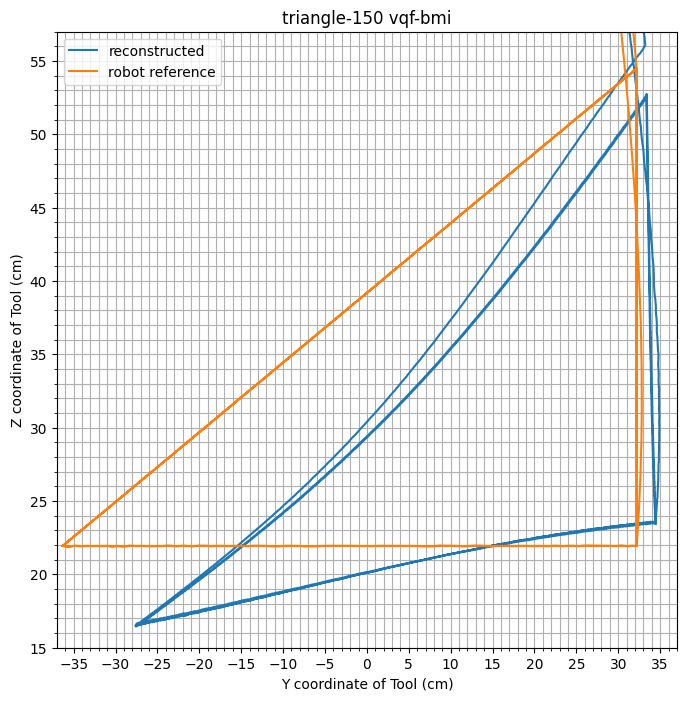

triangle-150 vqf-bmi-cal


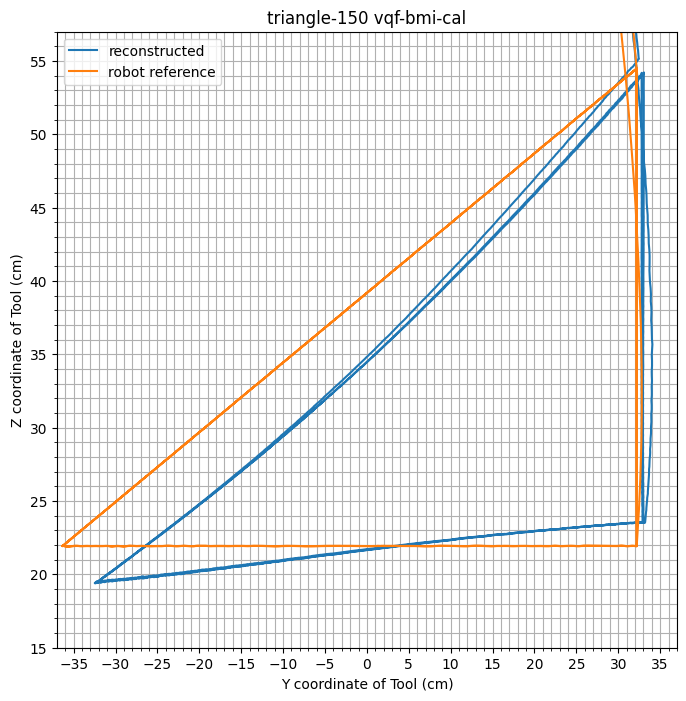

triangle-150 madgwick


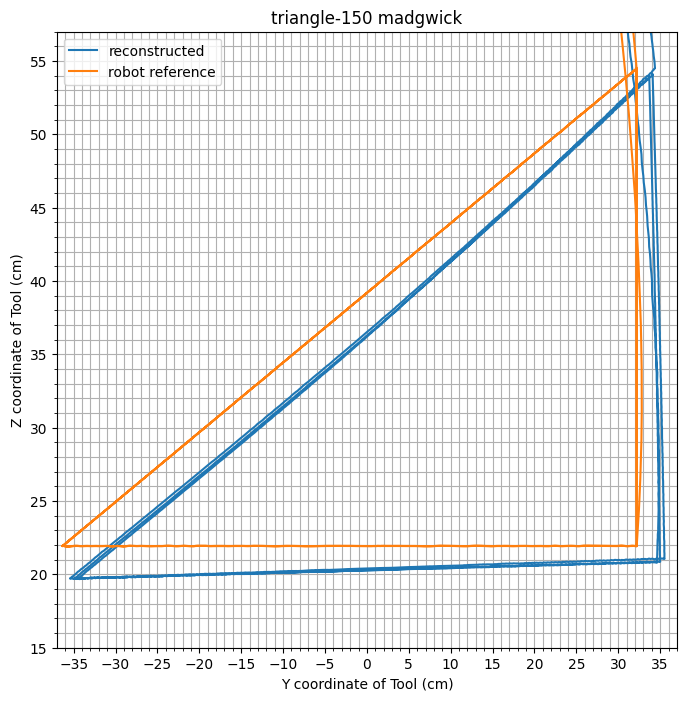

triangle-150 madgwick-cal


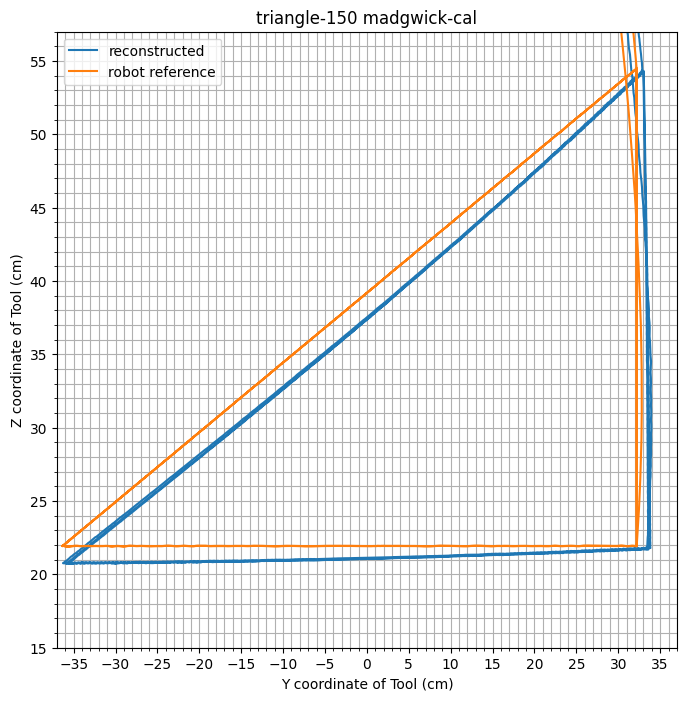

triangle-150 madgwick-bmi


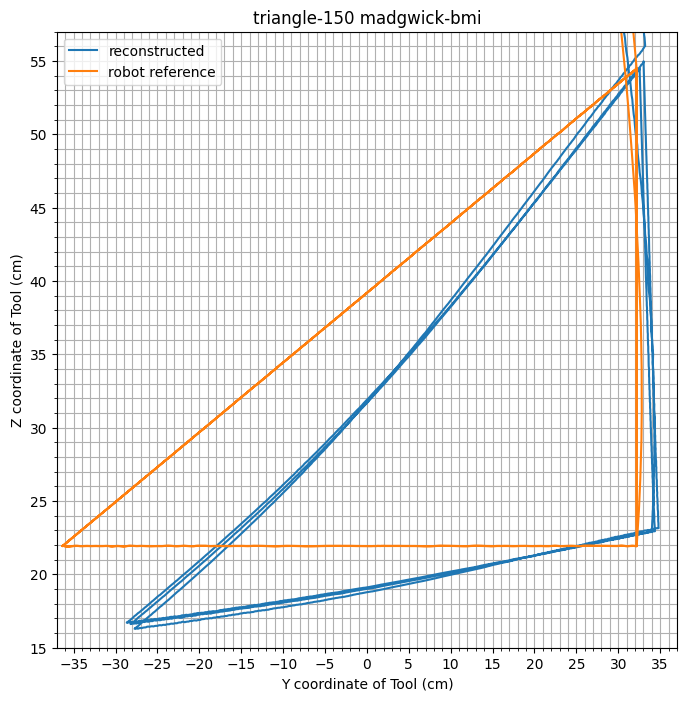

triangle-150 madgwick-bmi-cal


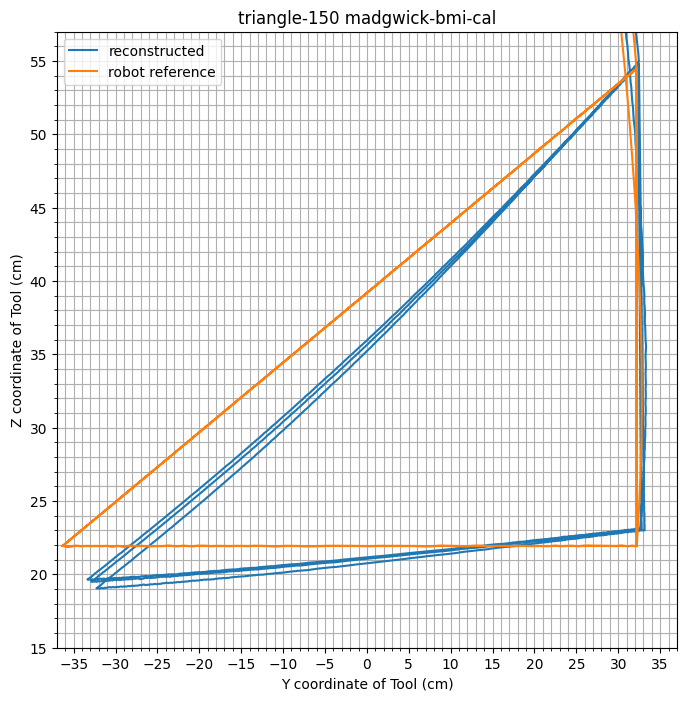

triangle-200 vqfbasic


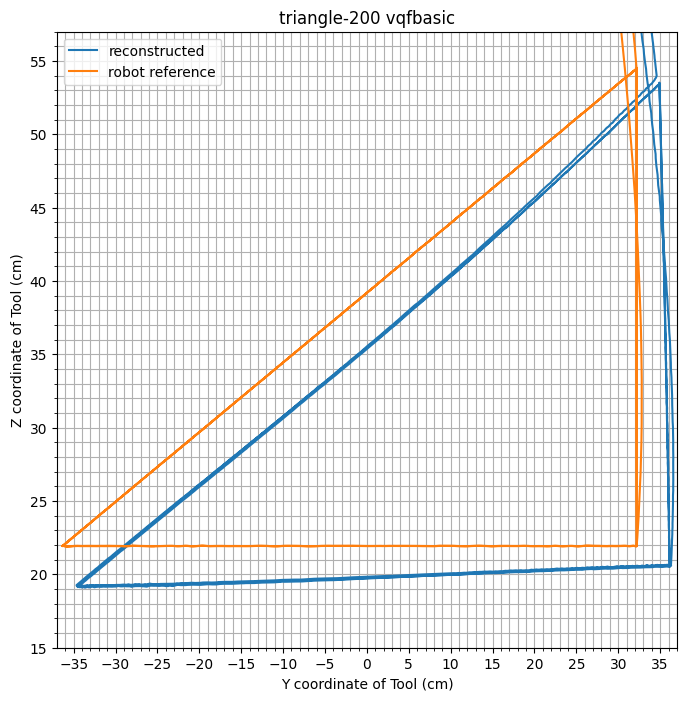

triangle-200 vqfbasic-cal


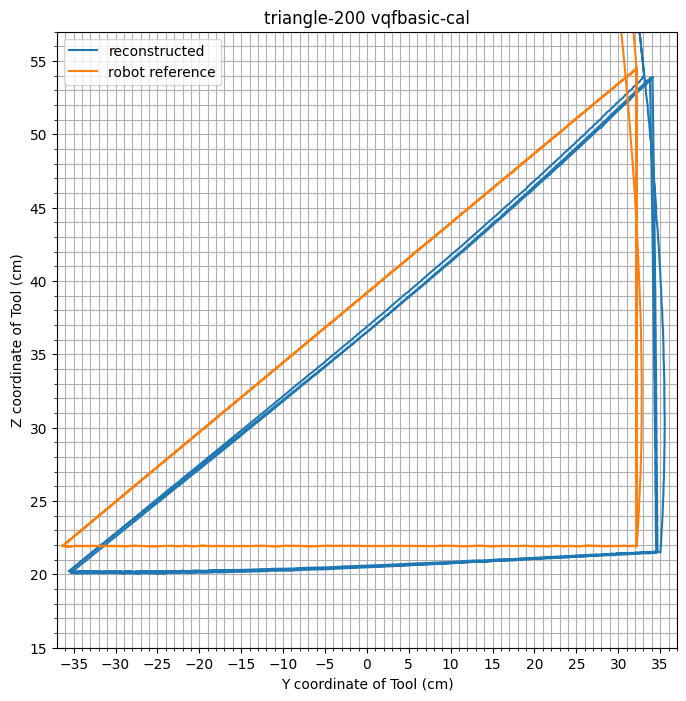

triangle-200 vqfbasic-bmi


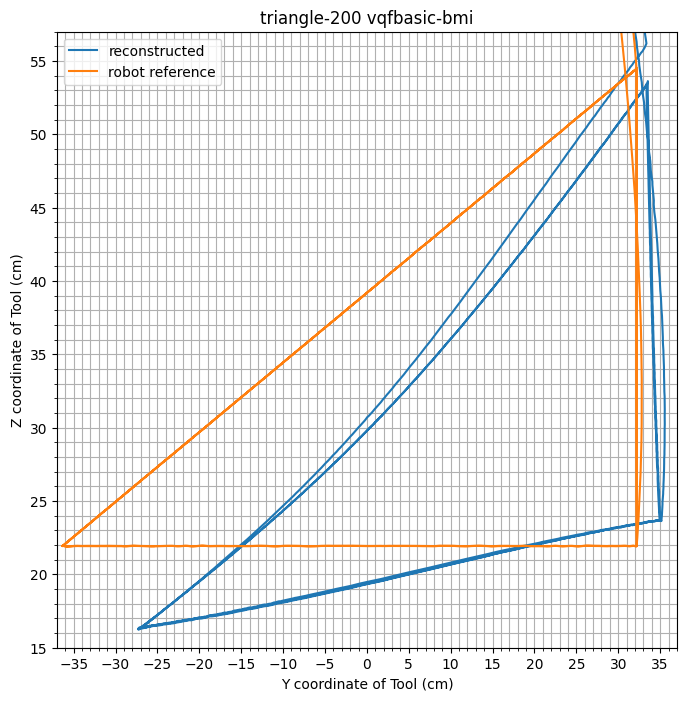

triangle-200 vqfbasic-bmi-cal


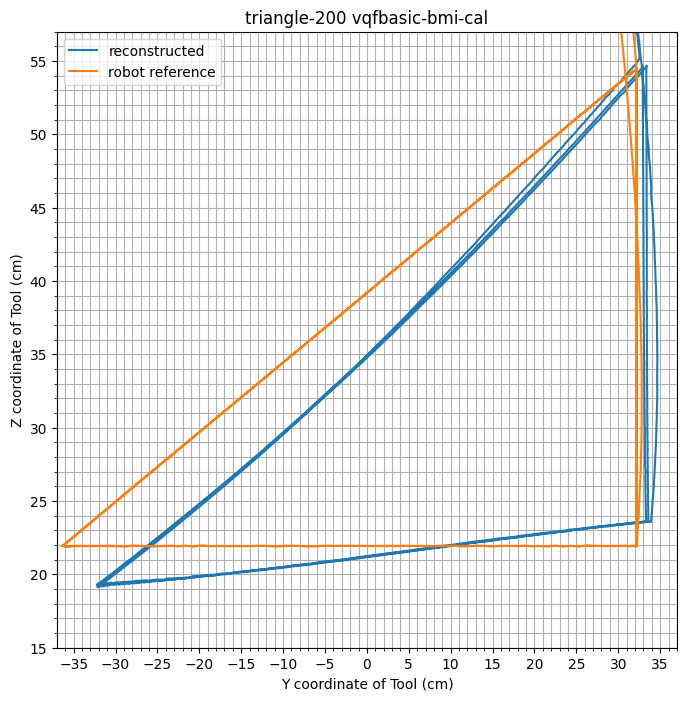

triangle-200 vqf


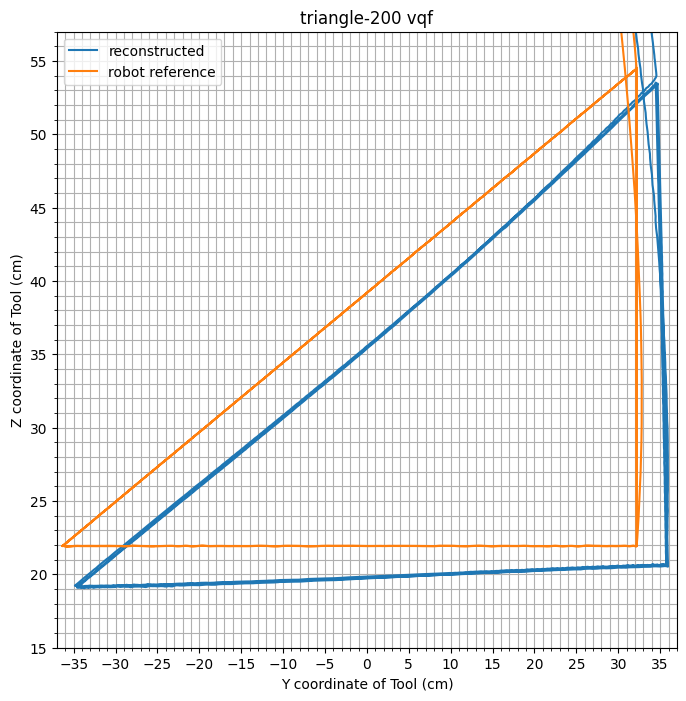

triangle-200 vqf-cal


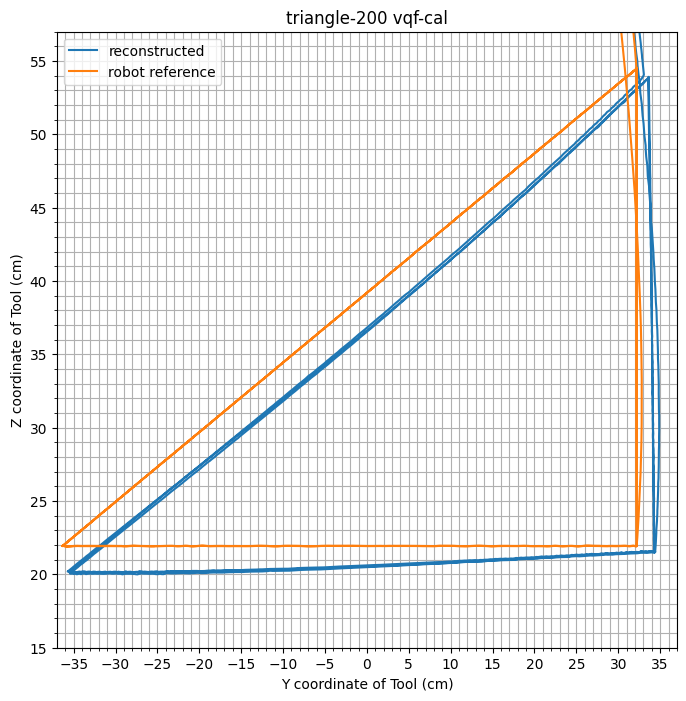

triangle-200 vqf-bmi


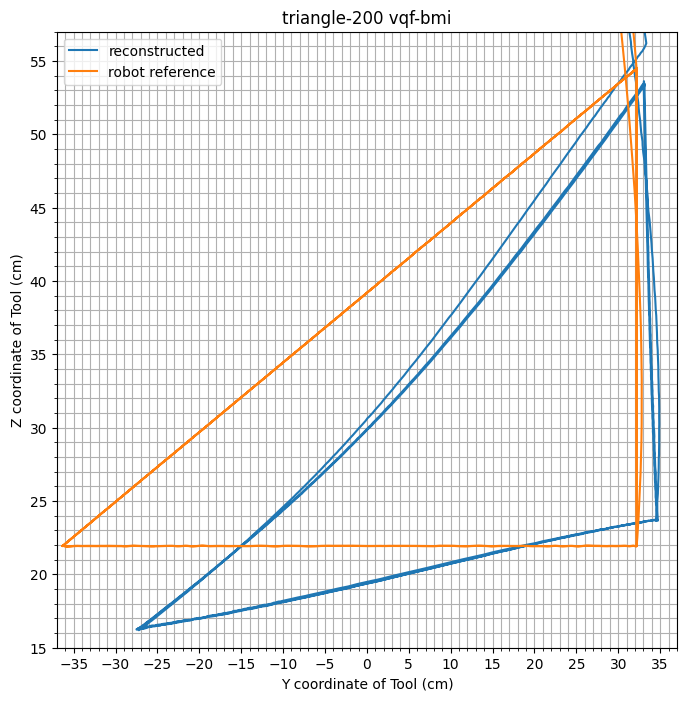

triangle-200 vqf-bmi-cal


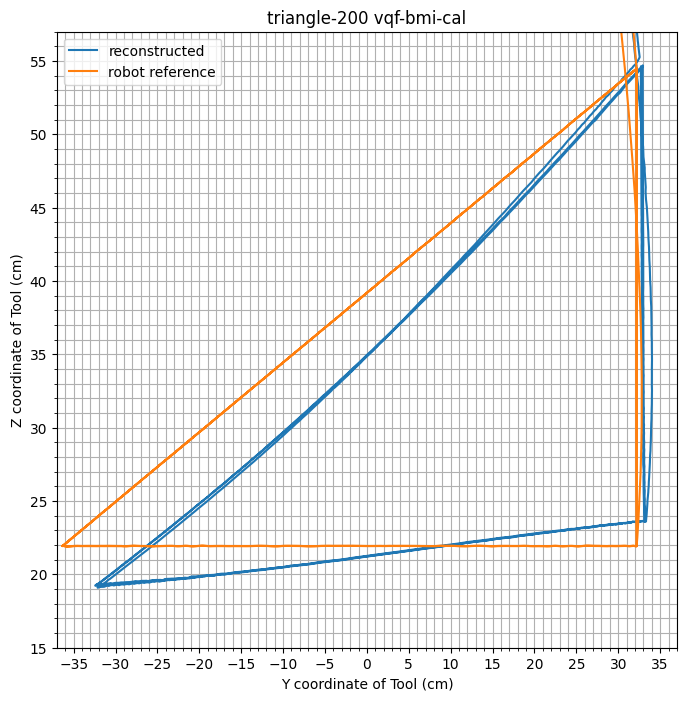

triangle-200 madgwick


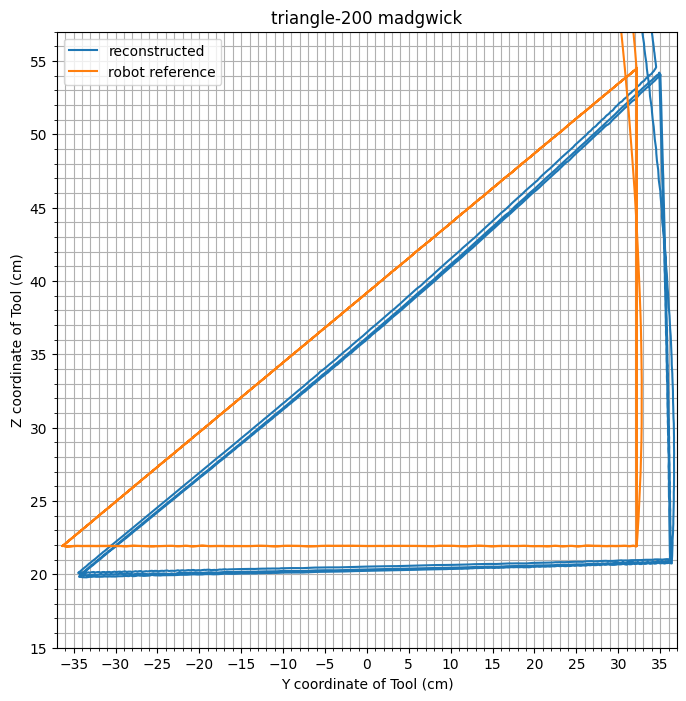

triangle-200 madgwick-cal


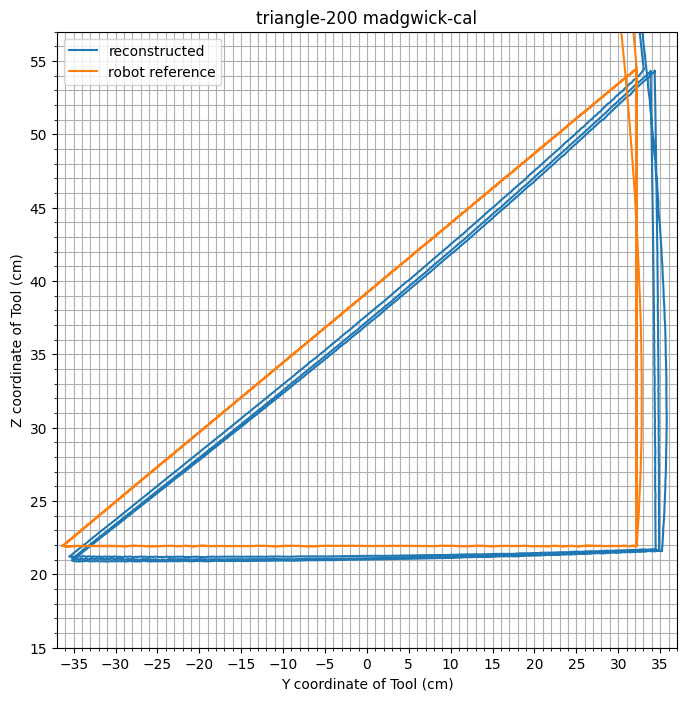

triangle-200 madgwick-bmi


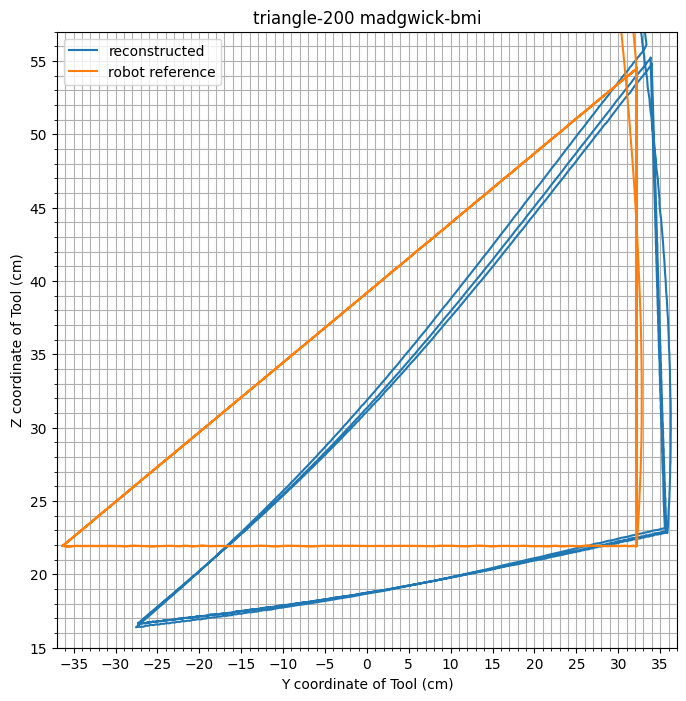

triangle-200 madgwick-bmi-cal


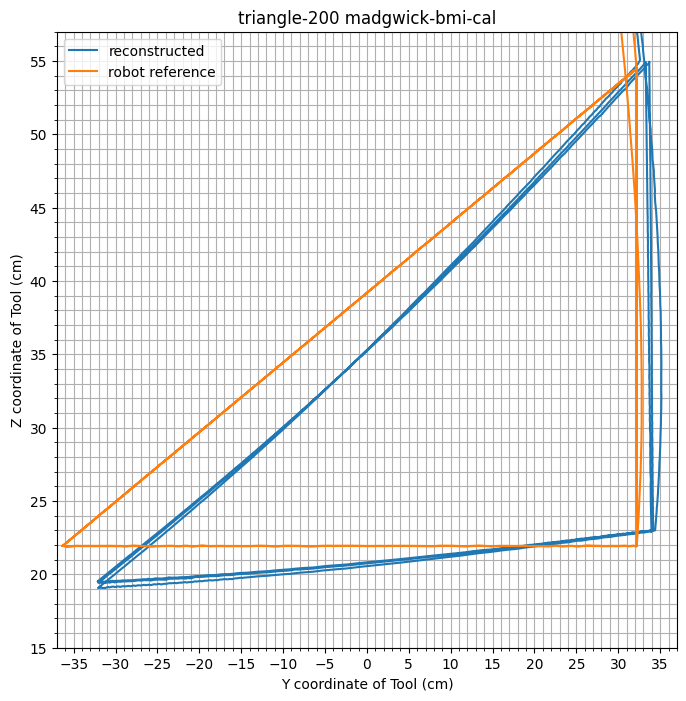

triangle-250 vqfbasic


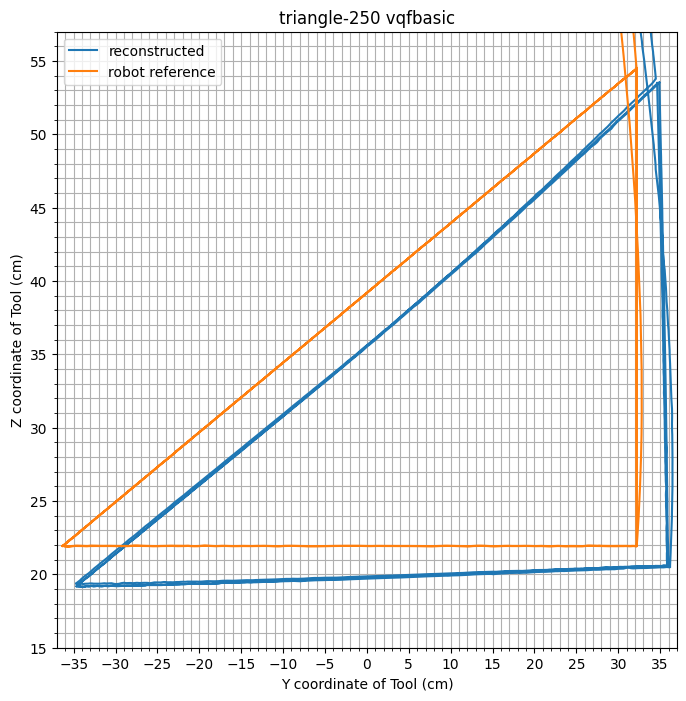

triangle-250 vqfbasic-cal


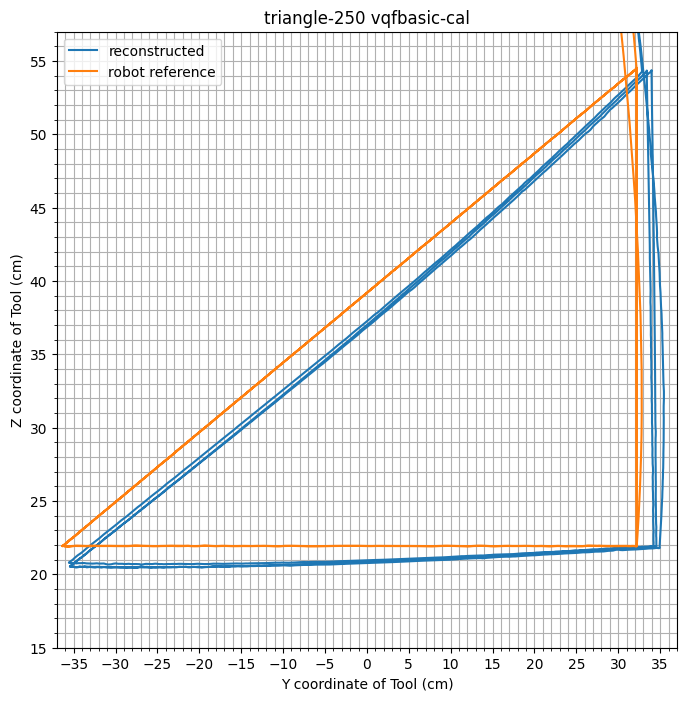

triangle-250 vqfbasic-bmi


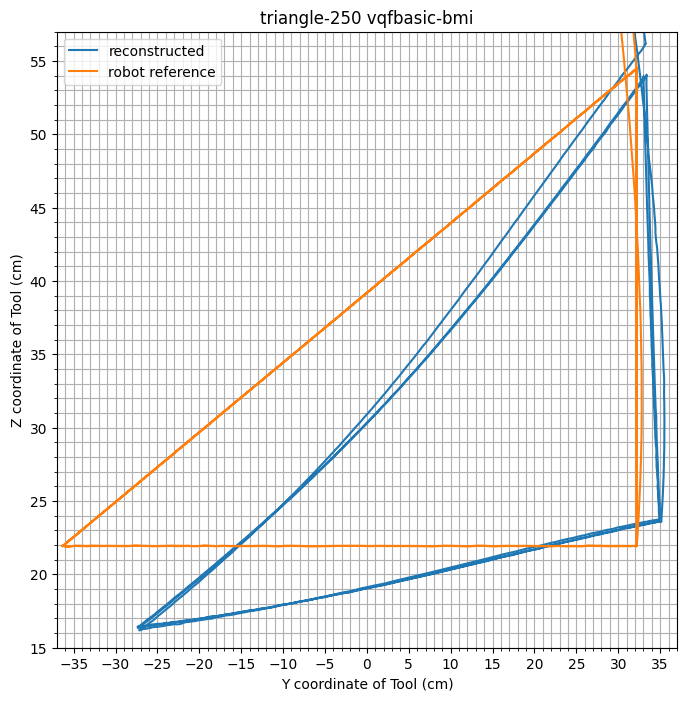

triangle-250 vqfbasic-bmi-cal


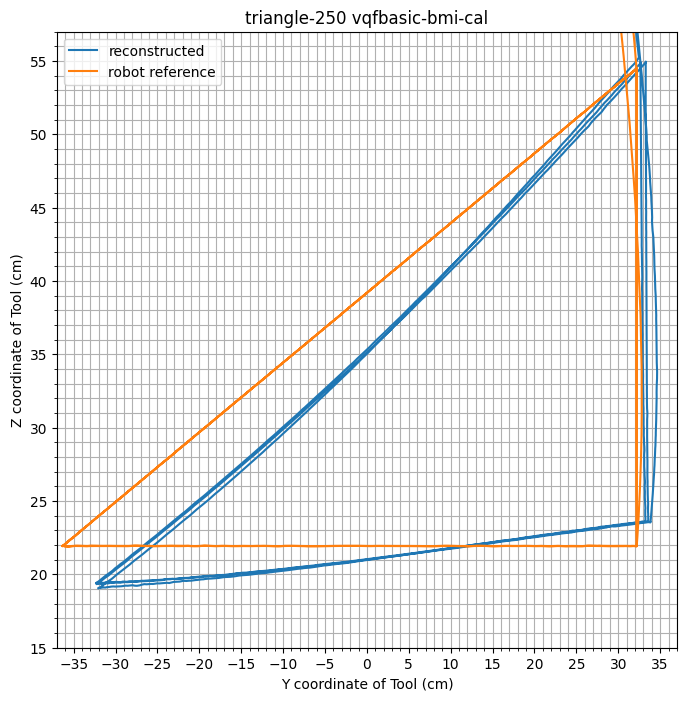

triangle-250 vqf


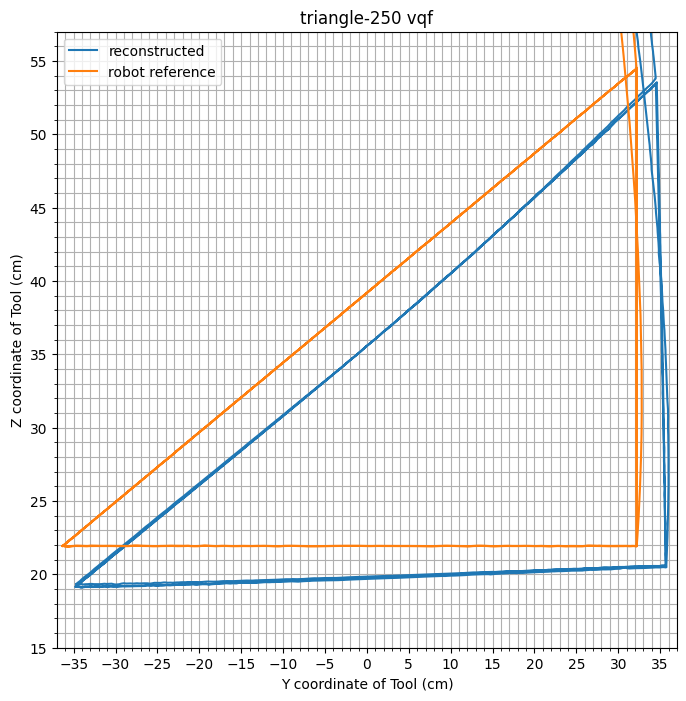

triangle-250 vqf-cal


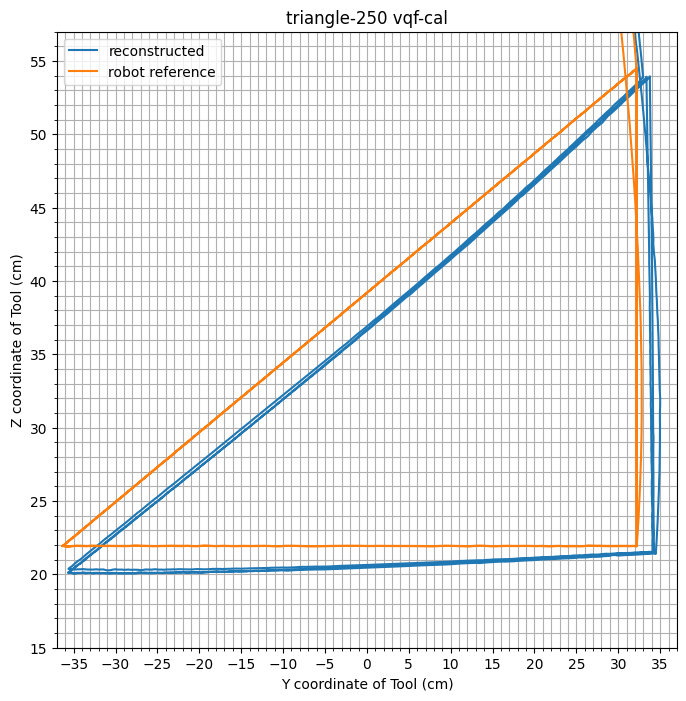

triangle-250 vqf-bmi


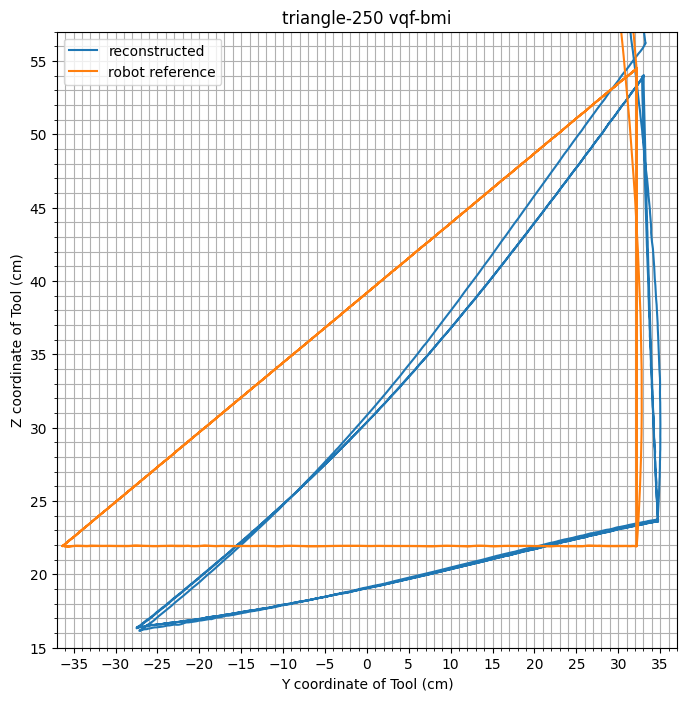

triangle-250 vqf-bmi-cal


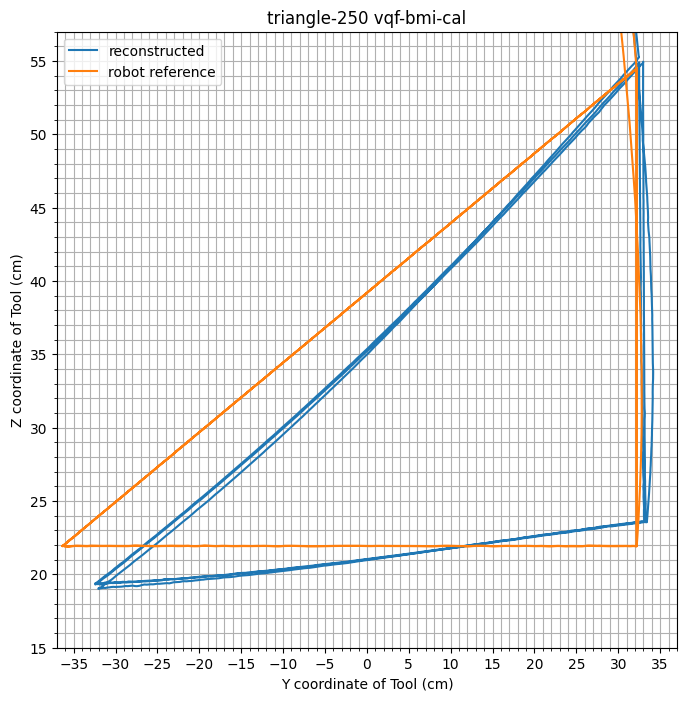

triangle-250 madgwick


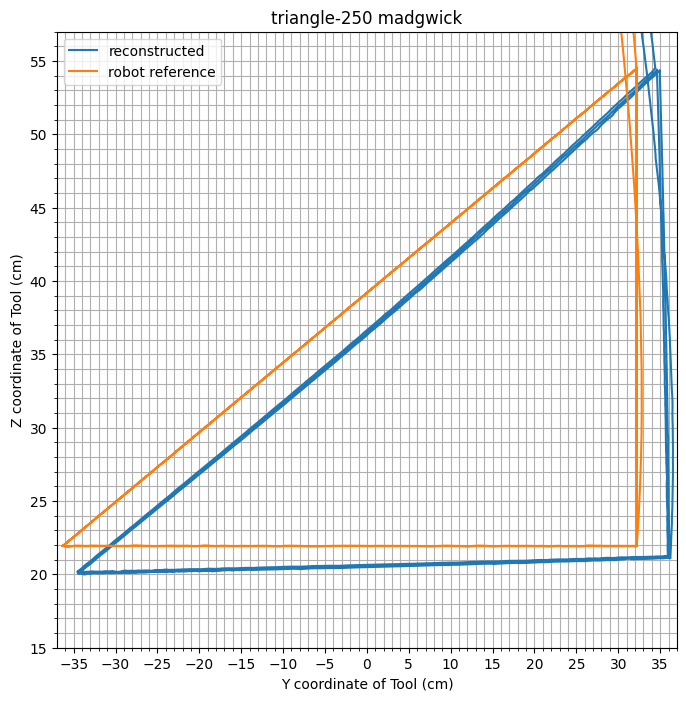

triangle-250 madgwick-cal


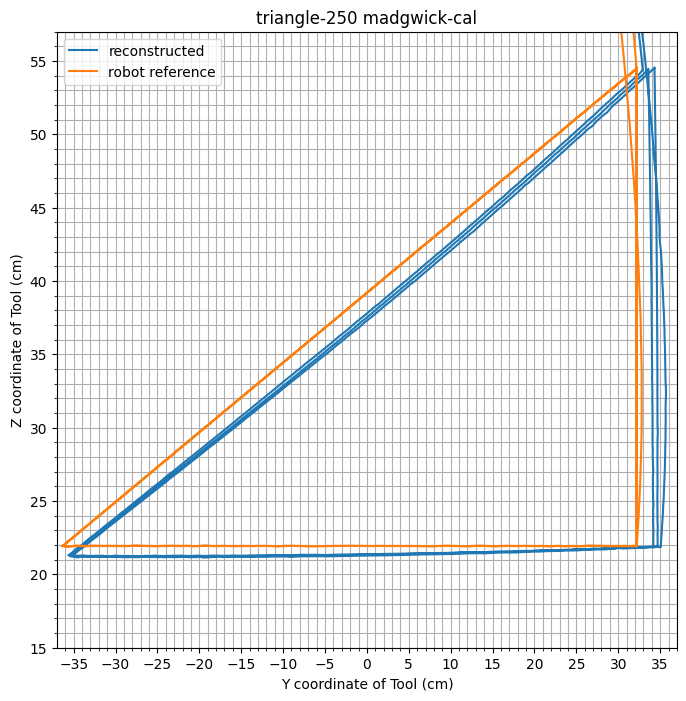

triangle-250 madgwick-bmi


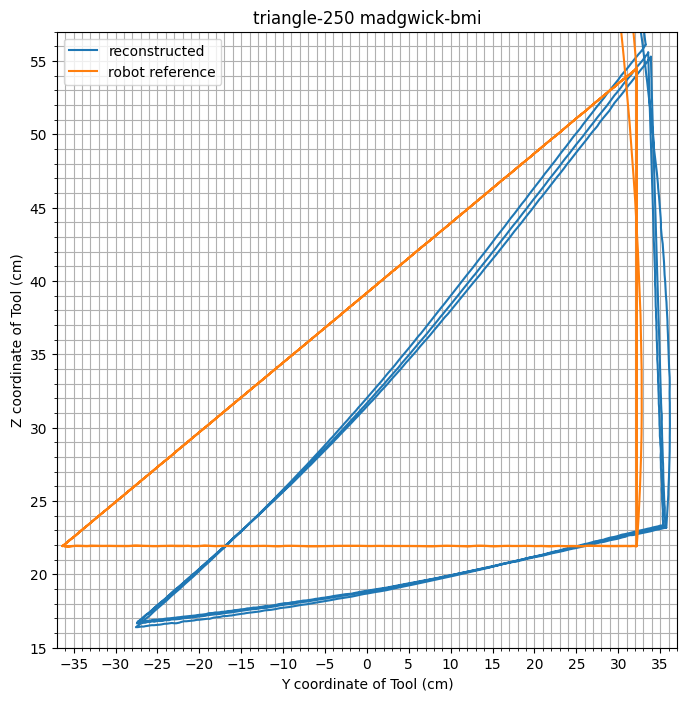

triangle-250 madgwick-bmi-cal


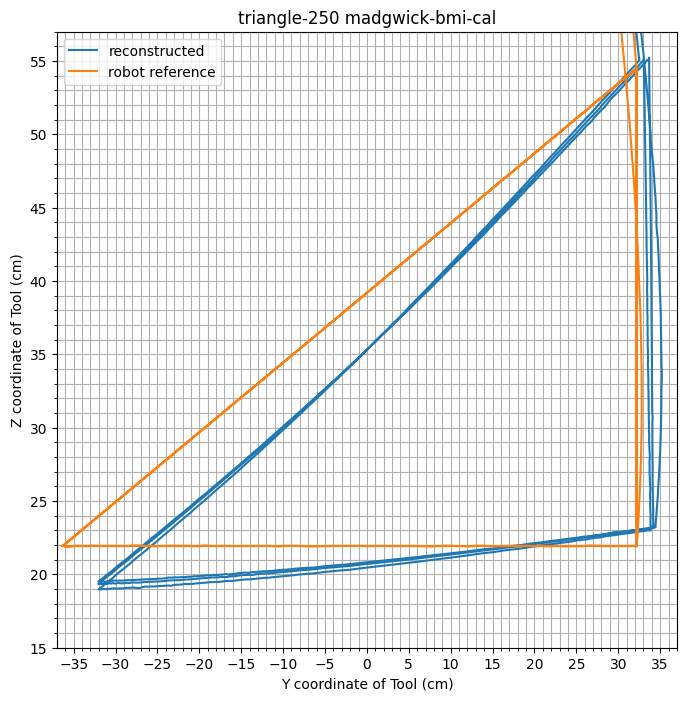

In [16]:
for scenario in scenarios:
    robotfile = robot_tcp_filename(scenario)
    robot_tcp = read_tcp_csv(robotfile)
    for method in methods:
        if 'robot' in method: continue
        imufile = reconstructed_tcp_filename(scenario, method)
        reconstructed_tcp = read_tcp_csv(imufile)
        plt.figure(figsize=(8,8))
        print(scenario + ' ' + method)
        plt.minorticks_on()
        plt.xticks(np.arange(-35, 41, 5))
        plt.yticks(np.arange(-35, 100, 5))
        if 'circle' in scenario:
            plt.xlim(-12, 31)
            plt.ylim(38, 82)
        else:
            plt.xlim(-37, 37)
            plt.ylim(15, 57)
        plt.grid(which='both')
        plt.xlabel('Y coordinate of Tool (cm)')
        plt.ylabel('Z coordinate of Tool (cm)')
        plt.title(scenario + ' ' + method)
        #plt.xlim(-0.3, 0.3)
        #plt.ylim(0.4, 1.0)
        plt.plot(100*reconstructed_tcp[:, 0], 100*reconstructed_tcp[:, 1], label='reconstructed')
        plt.plot(-100*robot_tcp[:, 1], 100*robot_tcp[:, 2], label='robot reference')
        plt.legend()
        plt.show()

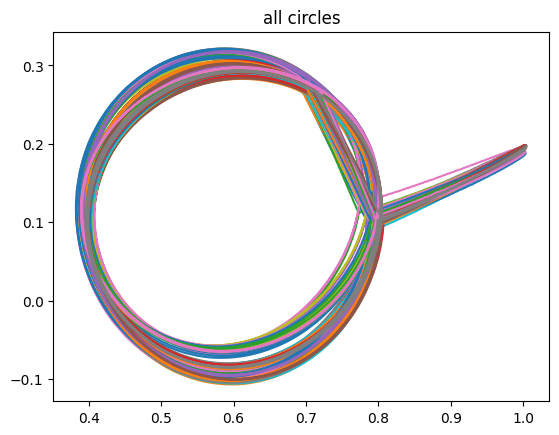

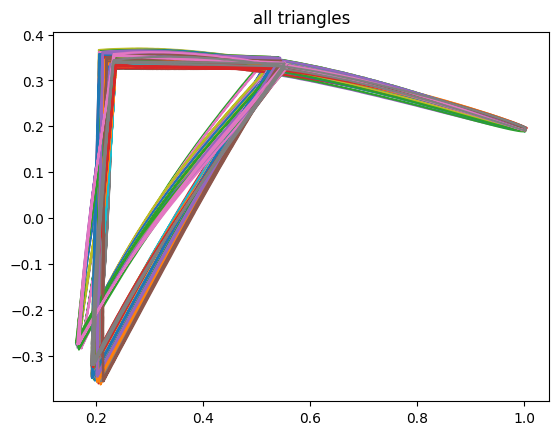

In [17]:
for scenario in scenarios:
    if 'circle' not in scenario: continue
    #robotfile = robot_tcp_filename(scenario)
    #robot_tcp = read_tcp_csv(robotfile)
    for method in methods:
        if 'robot' in method: continue
        imufile = reconstructed_tcp_filename(scenario, method)
        imu_tcp = read_tcp_csv(imufile)
        plt.plot(imu_tcp[:, 1], imu_tcp[:, 0], label=scenario+' '+method)
#plt.legend()
plt.title('all circles')
plt.show()

for scenario in scenarios:
    if 'triangle' not in scenario: continue
    # robotfile = robot_tcp_filename(scenario)
    # robot_tcp = read_tcp_csv(robotfile)
    for method in methods:
        if 'robot' in method: continue
        imufile = reconstructed_tcp_filename(scenario, method)
        imu_tcp = read_tcp_csv(imufile)
        plt.plot(imu_tcp[:, 1], imu_tcp[:, 0], label=scenario+' '+method)
#plt.legend()
plt.title('all triangles')
plt.show()


# Calculate distance between true TCP and reconstructed TCP



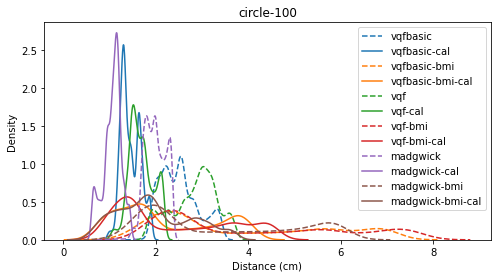

In [44]:
import matplotlib.pyplot as plt
import scipy.optimize as opt
import scipy.interpolate as interp

robot_hz = 125
recon_hz = 100

import seaborn as sb

peak_dist = np.full([len(scenarios), len(methods)], float('nan'))
mean_dist = np.full([len(scenarios), len(methods)], float('nan'))
rms_dist = np.full([len(scenarios), len(methods)], float('nan'))
for scenario_i, scenario in enumerate(scenarios):
    #if 'circle-200' in scenario: continue
    robotfile = robot_tcp_filename(scenario)
    robot_tcp = read_tcp_csv(robotfile)
    robot_tcp = crop_quiet_ends(robot_tcp)
    robot_x, robot_y, robot_z = -robot_tcp[:, 1], robot_tcp[:, 2], -robot_tcp[:, 0]
    plateau = np.nonzero(np.logical_and(0.42 < robot_z, robot_z < 0.45))[0]
    min_i, max_i = plateau[0] + 70, plateau[-1] - 150
    robot_xy = np.column_stack([robot_x, robot_y])
    robot_xyz = np.column_stack([robot_x, robot_y, robot_z])
    robot_t = np.linspace(0, len(robot_x) / robot_hz, len(robot_x), endpoint=False)
    plt.figure(figsize=(8,4))
    plt.title(scenario)
    for method_i, method in enumerate(methods):
        if 'robot' in method: continue
        imufile = reconstructed_tcp_filename(scenario, method)
        reconstructed_tcp = read_tcp_csv(imufile)
        reconstructed_tcp = crop_quiet_ends(reconstructed_tcp)
        recon_x, recon_y, recon_z = reconstructed_tcp[:, 0], reconstructed_tcp[:, 1], reconstructed_tcp[:, 2]
        recon_t = np.linspace(0, len(recon_x) / recon_hz, len(recon_x), endpoint=False)

        scale, offset, cost = alignSequences(robot_x-np.mean(robot_x), recon_x-np.mean(recon_x), robot_t, guess_initial=True)
        aligned_x = resampleSignal(recon_x, robot_t, scale, offset)
        aligned_y = resampleSignal(recon_y, robot_t, scale, offset)
        aligned_z = resampleSignal(recon_z, robot_t, scale, offset)
        aligned_xy = np.column_stack([aligned_x, aligned_y])
        aligned_xyz = np.column_stack([aligned_x, aligned_y, aligned_z])
        if cost > 4:
            print('WARNING: alignment failed: ', scenario, method, scale, offset, cost, file=sys.stderr)
            plt.figure(figsize=(8,2))
            print(scenario + ' ' + method)
            plt.title(scenario + ' ' + method)
            #plt.xlim(-0.3, 0.3)
            #plt.ylim(0.4, 1.0)
            plt.plot(robot_t, robot_x, label='robot_x')
            plt.plot(robot_t, aligned_x, label='aligned_x')
            plt.plot(recon_t, recon_x, label='recon_x', ls='--')
            plt.legend()
            plt.show()
            
        #differences_xy = robot_xy[min_i:max_i] - aligned_xy[min_i:max_i]
        #distances_cm = 100 * np.linalg.norm(differences_xy, axis=1)
        differences_xyz = robot_xyz[min_i:max_i] - aligned_xyz[min_i:max_i]
        distances_cm = 100 * np.linalg.norm(differences_xyz, axis=1)
        peak = np.max(distances_cm)
        mean = np.mean(distances_cm)
        rms = np.sqrt(np.mean(np.square(distances_cm)))
        peak_dist[scenario_i, method_i] = peak
        mean_dist[scenario_i, method_i] = mean
        rms_dist[scenario_i, method_i] = rms

        colors = plt.gca()._get_lines.prop_cycler
        if '-cal' not in method:
            color = next(colors)['color']
        sb.kdeplot(distances_cm, ax=plt.gca(), label=method, ls='-' if '-cal' in method else '--', color=color)
        plt.xlabel('Distance (cm)')
        # plt.figure(figsize=(8,2))
        # print(scenario + ' ' + method)
        # plt.title(scenario + ' ' + method)
        # #plt.xlim(-0.3, 0.3)
        # #plt.ylim(0.4,0.45)
        # plt.plot(robot_x, label='robot_x')
        # plt.plot(robot_z, label='robot_z')
        # plt.plot(aligned_x, label='aligned_x')
        # plt.plot(aligned_z, label='aligned_z')
        # plt.plot(differences_xy[:,0], label='differences_x')
        # plt.plot(differences_xy[:,1], label='differences_y')
        # plt.legend()
        # plt.show()
        #print(f'{scenario}-{method} PEAK={peak:.2f}, MEAN={mean:.2f}, RMS={rms:.2f}')
    plt.legend()
    plt.show()
    break



In [45]:
    
for method_i, method in enumerate(methods):
    if 'robot' in method: continue
    peak = np.nanmax(peak_dist[:, method_i])
    mean = np.nanmean(mean_dist[:, method_i])
    rms = np.nanmean(rms_dist[:, method_i])
    print(f'{method:20s}: PEAK={peak:.2f} cm, MEAN={mean:.2f} cm, RMS={rms:.2f} cm')


vqfbasic            : PEAK=3.43 cm, MEAN=2.51 cm, RMS=2.54 cm
vqfbasic-cal        : PEAK=1.93 cm, MEAN=1.45 cm, RMS=1.46 cm
vqfbasic-bmi        : PEAK=7.11 cm, MEAN=3.80 cm, RMS=4.22 cm
vqfbasic-bmi-cal    : PEAK=4.17 cm, MEAN=2.21 cm, RMS=2.46 cm
vqf                 : PEAK=3.70 cm, MEAN=2.83 cm, RMS=2.87 cm
vqf-cal             : PEAK=2.20 cm, MEAN=1.68 cm, RMS=1.70 cm
vqf-bmi             : PEAK=7.71 cm, MEAN=4.06 cm, RMS=4.50 cm
vqf-bmi-cal         : PEAK=4.60 cm, MEAN=2.38 cm, RMS=2.67 cm
madgwick            : PEAK=2.37 cm, MEAN=1.98 cm, RMS=2.00 cm
madgwick-cal        : PEAK=1.46 cm, MEAN=1.06 cm, RMS=1.08 cm
madgwick-bmi        : PEAK=6.17 cm, MEAN=3.34 cm, RMS=3.71 cm
madgwick-bmi-cal    : PEAK=3.70 cm, MEAN=1.95 cm, RMS=2.11 cm


### Subtracting initial gyro offset decreases accuracy

The scenario `circle-200` has a non-zero constant offset in the gyro data of the humerus, although the IMU is stationary for several seconds at the beginning. Subtracting this offset makes the scenario usable. However, doing the same for all data files reduces accuracy significantly. Thus, `calculate-quaterions.py` was changed to apply offset correction only if the offset is larger than a relatively high threshold.

Here is the above accuracy table for the case where `remove_initial_offset` is called after calibration in `calculate-quaterions.py`. The values are even worse when subtracting initial offset before applying the gyro calibration coefficients.

```
vqfbasic            : PEAK=3.70 cm, MEAN=2.86 cm, RMS=2.90 cm
vqfbasic-cal        : PEAK=2.26 cm, MEAN=1.72 cm, RMS=1.74 cm
vqfbasic-bmi        : PEAK=7.60 cm, MEAN=4.01 cm, RMS=4.45 cm
vqfbasic-bmi-cal    : PEAK=4.56 cm, MEAN=2.36 cm, RMS=2.65 cm
vqf                 : PEAK=3.71 cm, MEAN=2.83 cm, RMS=2.87 cm
vqf-cal             : PEAK=2.20 cm, MEAN=1.68 cm, RMS=1.70 cm
vqf-bmi             : PEAK=7.72 cm, MEAN=4.06 cm, RMS=4.50 cm
vqf-bmi-cal         : PEAK=4.61 cm, MEAN=2.38 cm, RMS=2.67 cm
madgwick            : PEAK=3.13 cm, MEAN=2.37 cm, RMS=2.40 cm
madgwick-cal        : PEAK=1.64 cm, MEAN=1.27 cm, RMS=1.29 cm
madgwick-bmi        : PEAK=6.71 cm, MEAN=3.67 cm, RMS=4.04 cm
madgwick-bmi-cal    : PEAK=3.72 cm, MEAN=2.15 cm, RMS=2.31 cm
```

# Substituting individual segments with robot quaternions

In order to potentially 


### Align Robot Data Timestamps with IMU Data Timestamps

Since the Robot timestamps are in milliseconds and the IMU data timestamps are in nanoseconds, we first have to align them.
For this purpose, we create from each quaternion file `robot-{scenario}.csv` a second version with synchronized IMU timestamps.
Unless we want to re-implement `dsense_vis` style pose calibration here, we need to perform the timestamp alignment on the raw quaternions prior to pose calibration.
This poses a problem since the quaternions from the robot and the IMUs are not in the same coordinate system, so individual quaternion components are not comparable between the two data sources.
To get two 1-dimensional data series that we can align, we calculate for each quaternion the absolute angular distance from the very start of its sequence.
The absolute angular distance is just the arccos of the real component of the product of `q_i` and the conjugate first quaternion `q_0'`.

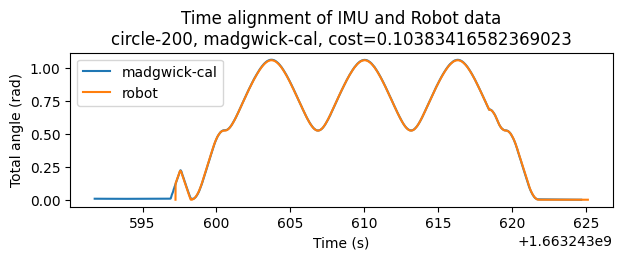

In [9]:
from scipy.spatial.transform import Rotation as Rot
from scipy.signal import find_peaks
import matplotlib.pyplot as plt


for method in ['madgwick-cal']:
    for scenario in scenarios:
        robot_data = pd.read_csv(quaternion_filename(scenario, 'robot', 'radius'))
        imu_data = pd.read_csv(quaternion_filename(scenario, method, 'radius'))
        imu_time = np.array(imu_data['TIME'])# / 1000000 - 1663243756.400839
        robot_q = Rot.from_quat(robot_data[['QUATERNION_1', 'QUATERNION_2', 'QUATERNION_3', 'QUATERNION_0']])
        imu_q = Rot.from_quat(imu_data[['QUATERNION_1', 'QUATERNION_2', 'QUATERNION_3', 'QUATERNION_0']])
        robot_angles = np.arccos(-Rot.as_quat(robot_q * robot_q[-1].inv())[:,3])
        imu_angles = np.arccos(-Rot.as_quat(imu_q * imu_q[-1].inv())[:,3])
        # Remove calibration movement from all measurements, because Circle-200 robot data starts too late, in the middle of the calibration movement.
        robot_angles[0] = robot_angles[-1]

        scale, offset, cost = alignSequences(imu_angles, robot_angles, imu_time, guess_initial=True)
        robot_time = scaledTime(imu_time, scale, offset, len(robot_angles))

        if scenario == 'circle-200':
            plt.figure(figsize=(7,2))
            plt.title(f'Time alignment of IMU and Robot data\n{scenario}, {method}, cost={cost}')
            plt.xlabel('Time (s)')
            plt.ylabel('Total angle (rad)')
            plt.plot(imu_time/1e6-60, imu_angles, label=method)
            plt.plot(robot_time/1e6-60, robot_angles, label='robot')
            plt.legend()
            plt.show()
        assert cost < 1, f'alignSequences cost {cost} > 1, maybe the alignment failed'

        robot_time = scaledTime(imu_time, scale, offset, len(robot_data))
        robot_time = np.array(robot_time, dtype=int)
        for segment in segments:
            robot_data = pd.read_csv(quaternion_filename(scenario, 'robot', segment))
            robot_data['TIME'] = robot_time
            robot_data.to_csv(quaternion_filename(scenario, 'robot', segment, suffix='-aligned'), index=False)


robot_data = pd.read_csv(quaternion_filename(scenario, 'robot', 'radius'))
imu_data = pd.read_csv(quaternion_filename(scenario, method, 'radius'))


In [ ]:
for method in ['madgwick-cal']:
    for scenario in scenarios:
        for segment in segments:
            calculate_tcp_positions(scenario, method, file_suffix=f'-no-{segment}', replace_with_robot_data=[segment])

# Question: Why are quaternions with BMI accel so much worse than ADXL

Example: Distances between actual and reconstructed TCP positions over all scenarios: `madgwick-cal: PEAK=1.46 cm, MEAN=1.06 cm, RMS=1.08 cm` vs. `madgwick-bmi-cal: PEAK=3.70 cm, MEAN=1.95 cm, RMS=2.11 cm`.

Intuitively, the choice of accelerometer should only have minimal influence on the quaternions, because the accelerometer values only produce a very slow drift, and the two accelerometers should give very similar raw values.

### Hypothesis 1: Time Synchronization problems

Seems unlikely, since the bad case uses gyro and accel values from the same chip, which should be perfectly aligned.

Test by using `alignSequences` to align the raw values of the two accelerometers. Ideally, the time offset should be zero.

### Hypothesis 2: Noisy accelerometer values

Maybe the BMI accel values are so noisy that they distort the quaternions. Seems unlikely, because the accel values influence the quaternion only very slowly and random noise should cancel out over time.

Test applying a high pass filter to the raw accelerometer values of both accelerometers. Plot the noise over time, limiting the vertical axis to zoom in on the values near zero.

### Hypothesis 3: There are systematic differences between the two accelerometers' values

Maybe the acceleration values of the BMI and ADXL "point" in slightly different directions when experiencing the same accelerating forces. Might be due to cross-axis sensitivity, which would presumably lead to non-orthogonal accelerometer basis vectors. Normally the calibration procedure should fix this, but only if it is uniform in all directions of space.

Test be plotting the angle between the two accelerometer vectors over time (arccos of dot product of normalized vectors). Depending on the state of Hypothesis 1, time synchronization might be necessary. Normalization should not be a problem because the vectors are normalized by Madgwick filter anyway.


### Test Hypothesis 1: Time Synchronization problems

circle-200 radius 1.0 0.0018274333502241345 357.0165772703702


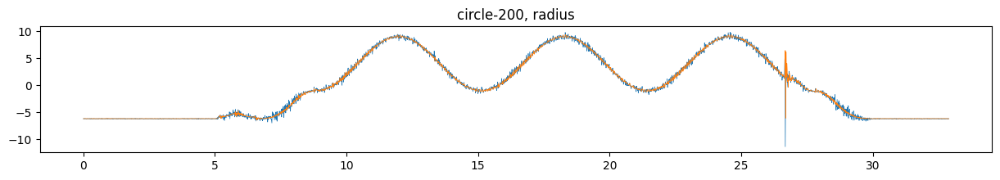

circle-200 humerus 1.0 -0.007064925954787577 41.82898892605624


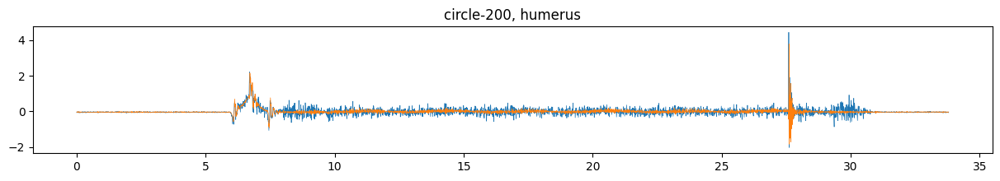

circle-200 digitus 1.0 -0.009755086644502522 498.2357918853533


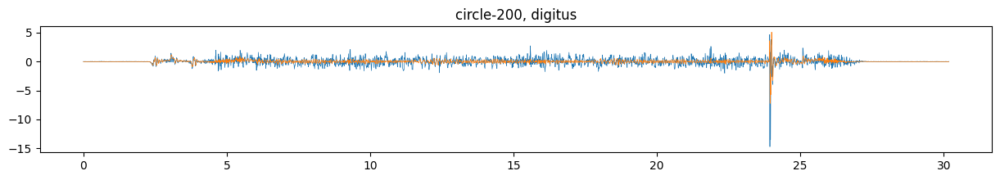

circle-200 carpus 1.0 -0.010564519373229499 414.0858144801736


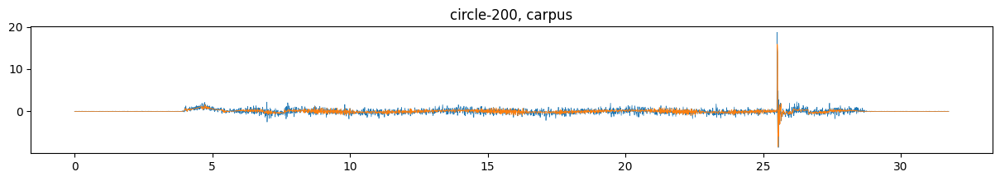

In [20]:
# Test Hypothesis 1: Time Synchronization problems

segment = 'radius'

import importlib
calibrator = importlib.import_module("calculate-quaternions")

for segment in reversed(segments):
    for scenario in ['circle-200']:
        data = pd.read_csv(raw_filename(scenario, segment))
        t = np.array(data['TIME'])
        t = (t - t[0]) / 1000000
        accel_adxl = np.array(data[['ACCEL_ADXL355_0','ACCEL_ADXL355_1','ACCEL_ADXL355_2']])
        accel_bmi = np.array(data[['ACCEL_BMI160_0','ACCEL_BMI160_1','ACCEL_BMI160_2']])
        accel_adxl = accel_adxl - np.mean(accel_adxl, axis=0)
        accel_bmi = accel_bmi - np.mean(accel_bmi, axis=0)
        scale, offset, cost = alignSequences(accel_adxl[:,1], accel_bmi[:,1], t, offset_only=True)
        print(scenario, segment, scale, offset, cost)
        plt.figure(figsize=(15,2))
        plt.title(f'{scenario}, {segment}')
        plt.plot(t, accel_adxl[:,1], lw=0.5)
        plt.plot(t, accel_bmi[:,1], lw=0.5)
        plt.show()


Apparently, the time difference between the two accelerometers is in the range of 10 ms, so about one sample. For IMUs with more motion, the calculated time offset is smaller, so the larger values might be due to the difficulty of aligning nearly-flat curves, and due to noise.

### Regarding Hpothesis 2: Accelerometer noise

In the plots for Hypothesis 1 above, the ADXL accelerometer values appear are more noisy. One source of noise might be the fact that the bandwidth limiting filters inside the accelerometers were configured for a sampling rate of 1600 Hz despite being sampled only 100 times per second, which would lead to aliasing that can manifest as noise. This does not explain the difference however, since both accelerometers were configured for the same sampling rate.

Also, this observation invalidates hypothesis 2, since the noisier accelerometer data still yields more accurate TCP reconstruction.

### Testing Hypothesis 3: Accelerometer Misalignment

The csv files for calibrated methods include the accel and gyro data with calibration applied. First let's compare the raw, uncalibrated accel values, to see how the angle between the acceleration vectors changes.

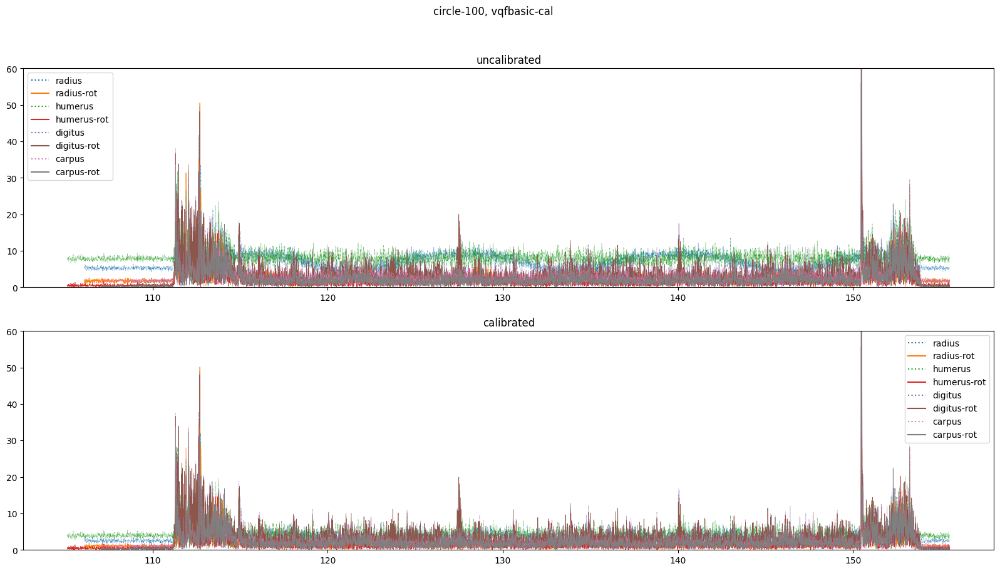

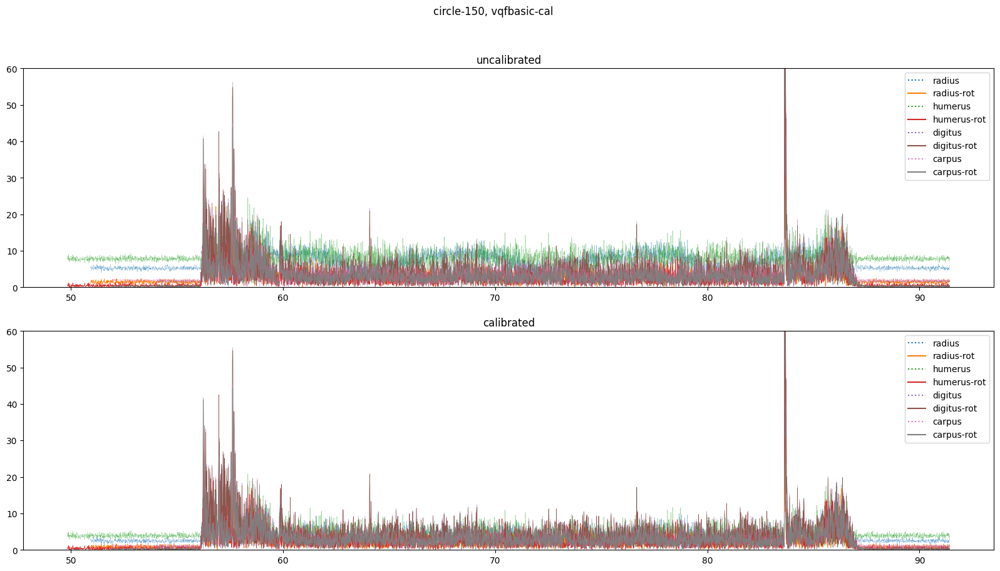

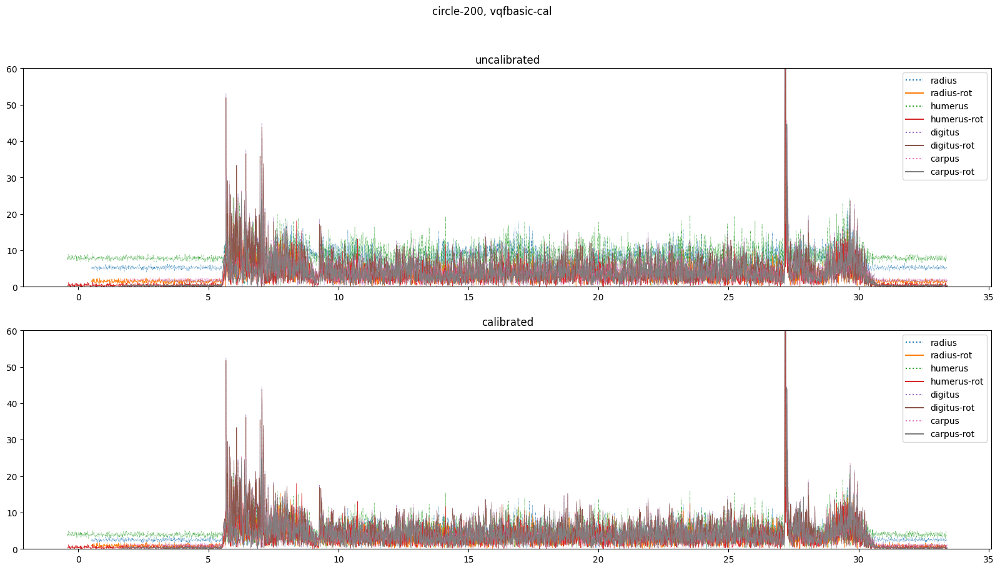

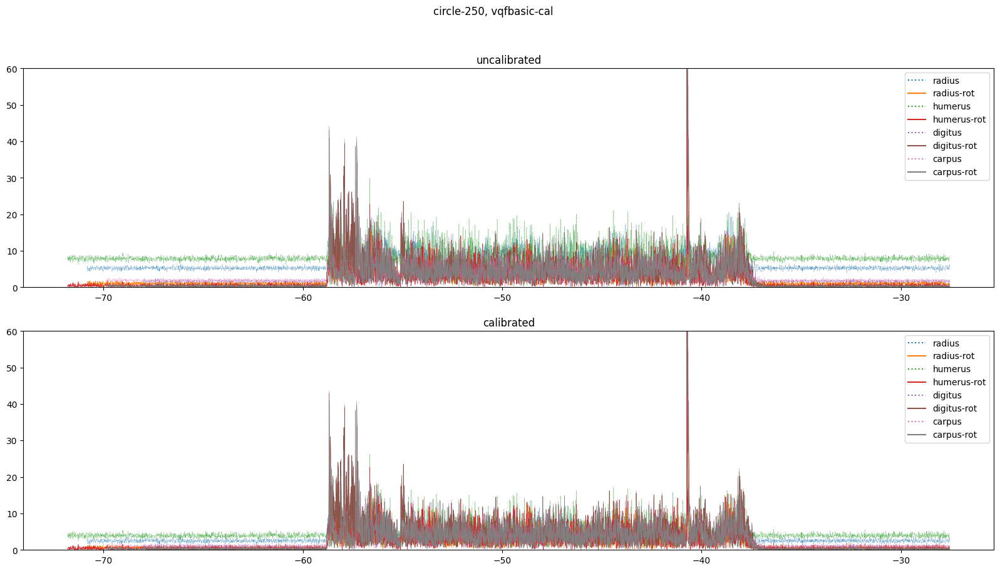

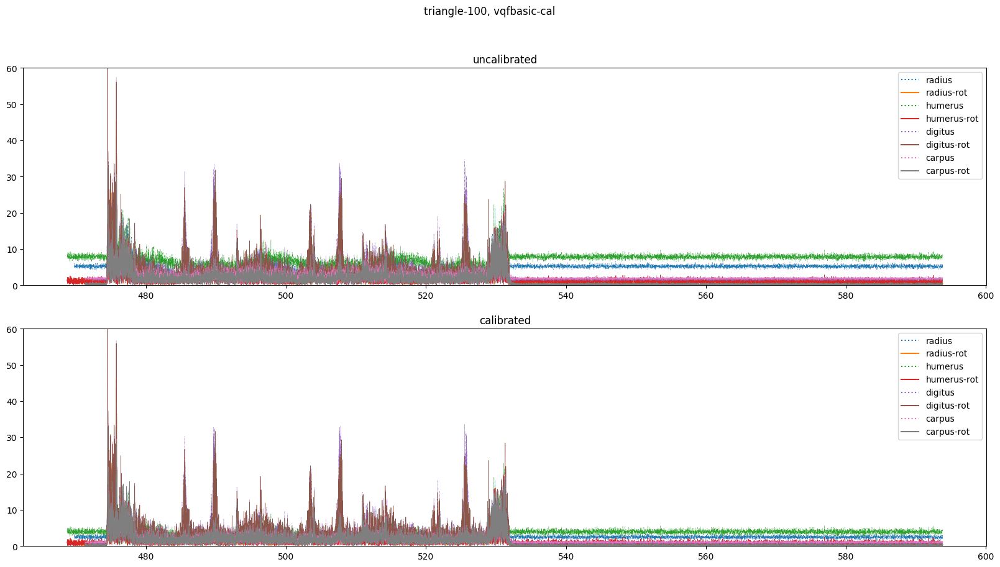

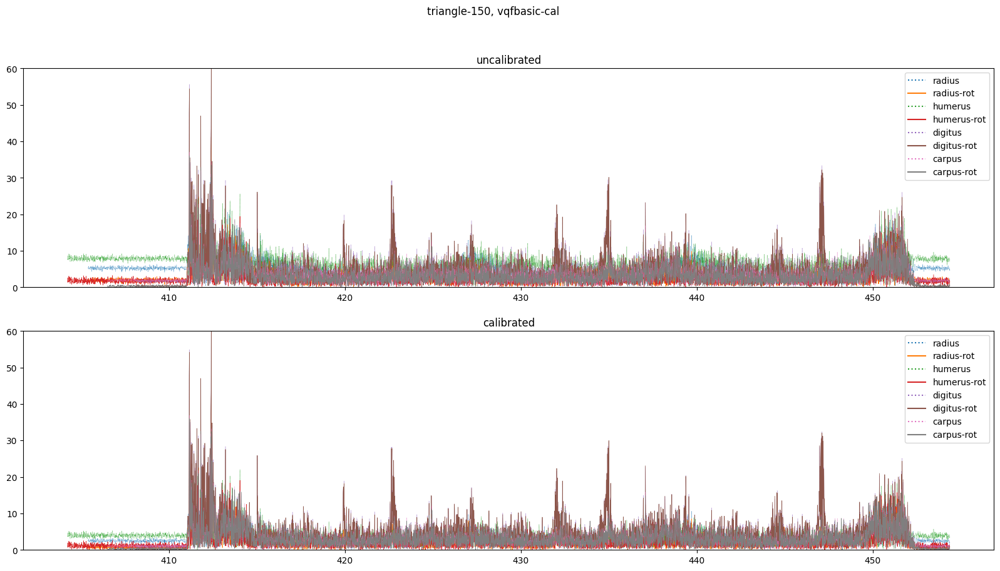

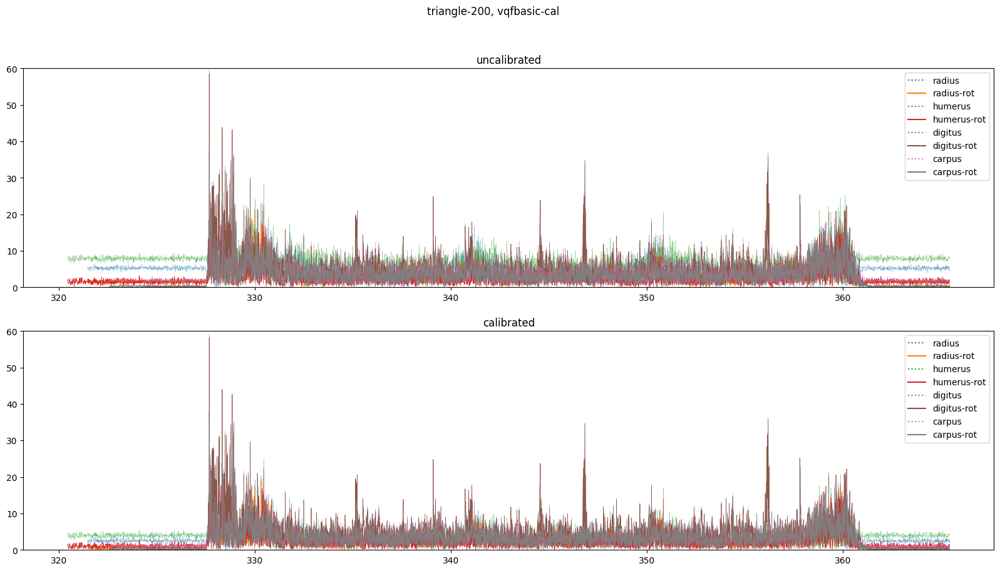

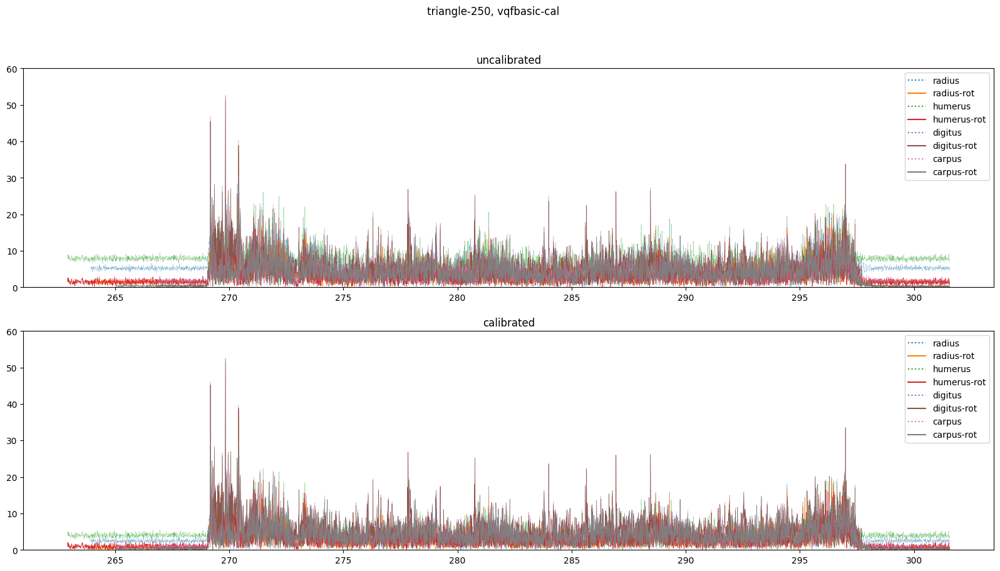

In [22]:
def find_rotation(A, B):
    # Compute the covariance matrix
    covariance_matrix = np.dot(B.T, A)
    # Perform SVD on the covariance matrix
    U, _, Vt = np.linalg.svd(covariance_matrix)
    # Compute the optimal rotation matrix
    rotation_matrix = np.dot(Vt.T, U.T)
    # Calculate mean square difference between B and rotated A
    # rotated_A = A @ rotation_matrix
    # mean_square_diff_old = np.mean(np.square(B - A))
    # mean_square_diff = np.mean(np.square(B - rotated_A))
    return rotation_matrix

for scenario in scenarios:
    fig, ax = plt.subplots(2, figsize=(20,10))
    fig.suptitle(f'{scenario}, {method}')
    ax[0].set_title(f'uncalibrated')
    ax[1].set_title(f'calibrated')
    ax[0].set_ylim((0,60))
    ax[1].set_ylim((0,60))
    for segment in reversed(segments):
        data_uncal = pd.read_csv(quaternion_filename(scenario, 'madgwick', segment))
        data_cal = pd.read_csv(quaternion_filename(scenario, 'madgwick-cal', segment))
        t = np.array(data_uncal['TIME'])
        t = (t - 1663243916260647) / 1000000 + 265
        accel_adxl_uncal = np.array(data_uncal[['ACCEL_ADXL355_0','ACCEL_ADXL355_1','ACCEL_ADXL355_2']])
        accel_bmi_uncal = np.array(data_uncal[['ACCEL_BMI160_0','ACCEL_BMI160_1','ACCEL_BMI160_2']])
        accel_adxl_cal = np.array(data_cal[['ACCEL_ADXL355_0','ACCEL_ADXL355_1','ACCEL_ADXL355_2']])
        accel_bmi_cal = np.array(data_cal[['ACCEL_BMI160_0','ACCEL_BMI160_1','ACCEL_BMI160_2']])
        # Normalize all acceleration vectors
        accel_adxl_uncal = accel_adxl_uncal / np.linalg.norm(accel_adxl_uncal, axis=1)[:, np.newaxis]
        accel_bmi_uncal = accel_bmi_uncal / np.linalg.norm(accel_bmi_uncal, axis=1)[:, np.newaxis]
        accel_adxl_cal = accel_adxl_cal / np.linalg.norm(accel_adxl_cal, axis=1)[:, np.newaxis]
        accel_bmi_cal = accel_bmi_cal / np.linalg.norm(accel_bmi_cal, axis=1)[:, np.newaxis]
        rot_uncal = find_rotation(accel_adxl_uncal, accel_bmi_uncal)
        rot_cal = find_rotation(accel_adxl_cal, accel_bmi_cal)
        angles_uncal = np.rad2deg(np.arccos(np.einsum('ij,ij->i', accel_adxl_uncal, accel_bmi_uncal)))
        angles_cal = np.rad2deg(np.arccos(np.einsum('ij,ij->i', accel_adxl_cal, accel_bmi_cal)))
        angles_rotated_uncal = np.rad2deg(np.arccos(np.einsum('ij,ij->i', accel_adxl_uncal @ rot_uncal, accel_bmi_uncal)))
        angles_rotated_cal = np.rad2deg(np.arccos(np.einsum('ij,ij->i', accel_adxl_cal @ rot_cal, accel_bmi_cal)))
        ax[0].plot(t, angles_uncal, lw=0.5, ls=':', label=segment)
        ax[1].plot(t, angles_cal, lw=0.5, ls=':', label=segment)
        ax[0].plot(t, angles_rotated_uncal, lw=0.5, label=segment + '-rot')
        ax[1].plot(t, angles_rotated_cal, lw=0.5, label=segment + '-rot')
    ax[0].legend()
    ax[1].legend()
    for line in [*ax[0].legend().get_lines(), *ax[1].legend().get_lines()]:
        line.set_linewidth(1.5)
    plt.show()
